In [147]:
# Imports & drive path

import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import seaborn as sns
#import mygene
from allensdk.core.cell_types_cache import CellTypesCache
import scipy.stats
from goatools.base import download_go_basic_obo
from goatools.base import download_ncbi_associations
from goatools.associations import read_ncbi_gene2go
from goatools.go_search import GoSearch
from symbol2geneid import symbol2geneid

from unpack_dict_to_col_pd import unpack
#fork and download from: https://github.com/aciernia/goatools
from genes_NCBI_10090_ProteinCoding import GeneID2nt
from statsmodels.sandbox.stats.multicomp import fdrcorrection0
from scipy import stats
#sys.path.append('/home/claireb/partial_corr')
from partial_corr import partial_corr

import sys
drive_path = '/Volumes/Brain2017/project/'
output_path = '/Volumes/Brain2017/project/ouput_varplots/'
drive_path_cells = '/Volumes/Brain2017/data/dynamic-brain-workshop/cell_types_cache/'

#drive_path = '/home/claireb/VISp'
#output_path = '/home/claireb/SWDB_2017/Project/Output'
#mg = mygene.MyGeneInfo()

<h3>Load RNA seq data</h3>

In [2]:
# Load labeled dataset

#def load_data(drive_path):
    
    
data = pd.read_csv('/Volumes/Brain2017/project/data_download/genes_rpkm.csv', index_col = 0)
# Data about cre lines & dissections
cell_meta = pd.read_csv('/Volumes/Brain2017/project/data_download/cell_metadata.csv', index_col = 0)
cell_info = pd.DataFrame([cell_meta['cre'], cell_meta['layer_dissectoin'], cell_meta['major_class']], index = ['cre', 'layer_dissection', 'major_class']).T
# cell_lookup = [cell_info['short_name'], cell_info['long_name']].to_dict()
name_to_cre = cell_info['cre'].to_dict()
name_to_dissection = cell_info['layer_dissection'].to_dict()
name_to_class = cell_info['major_class'].to_dict()
#return data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class

# Data about cell clusters - probably don't need this for now
# cell_class = pd.read_csv(drive_path + '/cell_classification.csv', index_col = 0)
# cluster_metadata = pd.read_csv(drive_path + '/cluster_metadata.csv')
# cluster_name_lookup = cluster_metadata.set_index(['cluster_id'])['Tasic_et_al_2016_label'].to_dict()
# cell_class.index = [cell_lookup[n] for n in cell_class.index]
# cluster_lookup = cell_class['primary'].to_dict()

# Skip this step, unless inputs are not proper gene symbols

# # Look up gene names for genes of interest
#genes = list(data.index) #set default genes to all genes in the dataset
name_dicts_set = mg.querymany(genes, scopes = 'symbol,alias,unigene', fields = 'symbol', species = 'mouse', returnall = False)
# # print(name_dicts_set)

# # Select rows from dataframe that correspond to genes of interest
# name_dict_set = {}
# for n in name_dicts_set:
#     alias = n['query']
#     if 'symbol' in n:
#         name = n['symbol']
#         name_dict_set[alias] = name
#     else:
#         name_dict_set[alias] = 'UNKNOWN'

NameError: name 'mg' is not defined

,cre,layer_dissection,major_class
long_name,,,
A01101401,Calb2,All,Inhibitory
A01101402,Calb2,All,Inhibitory
A01101403,Calb2,All,Excitatory
A01101404,Calb2,All,Inhibitory
A01101405,Calb2,All,Inhibitory


<h3>Filter RNA seq data</h3>

In [3]:
# Remove data for genes that are not associated with the chosen GO term
# Take the mean across each cre line
# Returns processed dataset and second df which maps from cre line to proportion of excitatory cells 

def filter_data(data, genes, name_to_dissection, name_to_class, group_by_layer = False):    
    visp_dict = {'All': 'All', 'L1': 'VISp1', 'lower': 'lower', 'upper': 'upper', 'L6': 'VISp6', 'L4': 'VISp4','L5': 'VISp5', 
                 'L6a': 'VISp6a','L6b': 'VISp6b','L2/3': 'VISp2/3'}

    data_small = data.copy()
    data_small = data_small[~data_small.index.duplicated(keep='first')]
    #data_small = data_small.reindex(list(set(name_dict_set.values())))     # Use if inputs are not proper gene symbols
    #if filtering by a specific genelist
    data_small = data_small.reindex(genes) 
    data_small.dropna(axis = 0, inplace = True)
    data_small.head()

    # Label cells by cre line and dissection
    
    cre_labels = [name_to_cre[n] for n in data_small.columns]
    dissection_labels = [visp_dict[name_to_dissection[n]] for n in data_small.columns]
    class_labels = [{'Inhibitory': 0, 'Excitatory': 1, 'Glia': np.nan, 'Endothelial': np.nan, 'Unknown': np.nan}[name_to_class[n]] for n in data_small.columns]
    celltype_df = pd.DataFrame(class_labels, index = [data_small.columns, cre_labels, dissection_labels]).T ###

    arrays = [data_small.columns, cre_labels, dissection_labels]
    data_small.columns = arrays

    if group_by_layer: #mean by creline and layer
        data_means = data_small.groupby(axis = 1, level = [1, 2]).mean()  # group by cre line and layer
        crelines_rnaseq = set([line[0] for line in data_means.columns])
        celltype_proportions_df = celltype_df.groupby(axis = 1, level = [1, 2]).mean()
    else:
        data_means = data_small.groupby(axis = 1, level = 1).mean()       # group by cre line only
        crelines_rnaseq = set([line for line in data_means.columns])
        celltype_proportions_df = celltype_df.groupby(axis = 1, level = 1).mean()

    return data_means, celltype_proportions_df, crelines_rnaseq

Load ephysdata


In [13]:
def get_ephys(drive_path_cells, ephys_features, group_by_layer = False, return_raw_values = False):
    ctc = CellTypesCache(manifest_file=os.path.join(drive_path,'cell_types_manifest.json'))
    # get cells that are cre positive:
    cells = ctc.get_cells(reporter_status=["cre reporter positive"], require_morphology= False) ###

    # filter out only cells that are from VISp
    # Depending on analysis, may want to exclude Ctgf cells because they can throw off the color scale
    line_data = [c for c in cells if (c['structure']['parent_structure_id'] == 385)]   # & 
#                 (c['transgenic_line'] != 'Ctgf-T2A-dgCre')]

    structure_names = [c['structure']['acronym'] for c in line_data]
    df_cells = pd.DataFrame(line_data)
    df_cells['area'] = structure_names
    
    ###
    ephys_features_dict = ctc.get_ephys_features()
    ephys_features_df = pd.DataFrame.from_records(ephys_features_dict)
    ephys_features_df.columns
    ###
    df = pd.merge(df_cells,ephys_features_df,left_on='id',right_on='specimen_id',how='left')

    ephys = df[ephys_features]
    ephys = ephys.dropna()
    crelines_ephys = [line for line in set(ephys['transgenic_line'])]
    if group_by_layer:
        ephys_mean = ephys.groupby(['transgenic_line', 'area']).mean().T
    else:
        ephys_mean = ephys.groupby(['transgenic_line']).mean().T
    if return_raw_values:
        return ephys_mean, crelines_ephys, ephys
    else:
        return ephys_mean, crelines_ephys, ephys

<h3>Load morphology data</h3>

In [4]:
def get_morphology(drive_path_cells, features, group_by_layer = False):
    ctc = CellTypesCache(manifest_file=os.path.join(drive_path_cells,'cell_types_manifest.json'))
    # get cells that are cre positive and have morphology data:
    cells = ctc.get_cells(reporter_status=["cre reporter positive"], require_morphology= True)

    # filter out only cells that are from VISp
    # Depending on analysis, may want to exclude Ctgf cells because they can throw off the color scale
    line_data = [c for c in cells if (c['structure']['parent_structure_id'] == 385)]# & 
                #(c['transgenic_line'] != 'Ctgf-T2A-dgCre')]

    structure_names = [c['structure']['acronym'] for c in line_data]
    df_cells = pd.DataFrame(line_data)
    df_cells['area'] = structure_names

    #rename cell id
    #df_cells.rename(columns={'id': 'cell_specimen_id','name':'cre_name_cell'}, inplace=True)

    #unpack structure dict inside df_cells:
    #df_unpack = unpack(df_cells, 'structure', 'nan')

    morph_features_df = ctc.get_morphology_features(dataframe=True)

    df = pd.merge(df_cells,morph_features_df,left_on='id',right_on='specimen_id',how='left')

    df['branchiness'] = df['number_branches'] / df['total_length']
    df['is_spiny'] = df['dendrite_type'] != 'aspiny'

    #extract and make a column for layer:
    #df['layer'] = [x.split(', ')[1] for x in df.name.values]
    #add a label for each cre line
    #df['tg_label'] = [x.split('-')[0] for x in df.transgenic_line.values]

    #make a column for creline + layer
   # df['column_names'] = df.tg_label.astype(str).str.cat(df.layer.astype(str),sep=' ') 
   # df['specimenid_cell_id_layer'] = df.cell_specimen_id.astype(str).str.cat(df.column_names.astype(str),sep=' ') 

    df_nice = df[features].dropna()# Drop rows that include NaN value in any column
    crelines_morph = [line for line in set(df_nice['transgenic_line'])]
    if group_by_layer:
        df_nice_mean = df_nice.groupby(['transgenic_line', 'area']).mean().T
    else:
        df_nice_mean = df_nice.groupby(['transgenic_line']).mean().T
    return df_nice_mean, crelines_morph

<h3>Search for genes related to a specific GO term</h3>
See https://github.com/tanghaibao/goatools/blob/master/notebooks/cell_cycle.ipynb

In [5]:
def goterm_to_genes(go_term):
    obo_fname = download_go_basic_obo()
    gene2go = download_ncbi_associations()
    go2geneids_mouse = read_ncbi_gene2go("gene2go", taxids=[10090], go2geneids=True)
    print("{N} GO terms associated with mouse NCBI Entrez GeneIDs".format(N=len(go2geneids_mouse)))

    srchhelp = GoSearch("go-basic.obo", go2items=go2geneids_mouse)
    term_all = re.compile(GO_term, flags=re.IGNORECASE)
    term_not = re.compile(GO_term + '.independent', flags=re.IGNORECASE)

    fout_allgos = GO_term + "_gos_mouse.log" 
    with open(fout_allgos, "w") as log:
        gos_m_all = srchhelp.get_matching_gos(term_all, prt=log)
        gos_no_m = srchhelp.get_matching_gos(term_not, gos=gos_m_all, prt=log)
        gos = gos_m_all.difference(gos_no_m)
        gos_all = srchhelp.add_children_gos(gos)
        geneids = srchhelp.get_items(gos_all)
    print('{N} mouse NCBI Entrez GeneIDs related to '.format(N=len(geneids)) + GO_term + ' found.')
    
    genes = []
    for geneid in geneids: # geneids associated with GO term
        nt = GeneID2nt.get(geneid, None)
        if nt is not None:
            genes += [nt.Symbol]
    return genes

In [84]:
#Example:
#GO_term = 'dendritic spine morphogenesis'
#genes = goterm_to_genes(GO_term)

  EXISTS: go-basic.obo
  EXISTS: gene2go
17409 GO terms associated with mouse NCBI Entrez GeneIDs
load obo file go-basic.obo
go-basic.obo: fmt(1.2) rel(2017-08-29) 49,075 GO Terms
59 mouse NCBI Entrez GeneIDs related to dendritic spine morphogenesis found.


<h3>Combine Gene Expression and Morphology Data</h3>

In [6]:
# Make cre line names match between ephys and morphology datasets

def match_datasets(data_means, df_nice_mean, crelines_morph, crelines_rnaseq, celltype_proportions_df, group_by_layer = False):
    crelines_dict = {}
    for l in list(crelines_morph) + list(crelines_rnaseq):
        crelines_dict[l] = l
    crelines_dict['Scnn1a-Tg2'] = 'Scnn1aTg2-Tg2'
    crelines_dict['Scnn1a-Tg3'] = 'Scnn1aTg3-Tg3'
    crelines_dict['Scnn1a-Tg2 Neg'] = 'Scnn1aTg2n-Tg2 Neg'
    crelines_dict['Scnn1a-Tg3 Neg'] = 'Scnn1aTg3n-Tg3 Neg'
    crelines_dict['Scnn1a-Tg2-Cre'] = 'Scnn1aTg2-Tg2-Cre'
    crelines_dict['Scnn1a-Tg3-Cre'] = 'Scnn1aTg3-Tg3-Cre'    
    
    if group_by_layer:
        new_cols = [crelines_dict[c[0]].split('-')[0] + '_' + c[1] for c in data_means.columns]
        new_labels = [crelines_dict[c[0]].split('-')[0] + '_' + c[1] for c in df_nice_mean.columns]    
    else:
        new_cols = [crelines_dict[c].split('-')[0] for c in data_means.columns.get_level_values(0)]
        new_labels = [crelines_dict[c].split('-')[0] for c in df_nice_mean.columns.get_level_values(0)]
    
    data_means_rnaseq = data_means.copy()
    df_morph = df_nice_mean.copy()

    data_means_rnaseq.columns = new_cols
    celltype_proportions_df.columns = new_cols
    df_morph.columns = new_labels
    
    celltype_proportions = celltype_proportions_df.T.to_dict().values()[0]

    # Throw out data for cre lines which are only in one dataset
    crelines_intersect = list(set(data_means_rnaseq.columns) & set(df_morph.columns))
    data_means_rnaseq = data_means_rnaseq.reindex_axis(crelines_intersect, axis = 1)
    df_morph = df_morph.reindex_axis(crelines_intersect, axis = 1)

    line_labels = []
    for l in df_morph.columns:
        line_labels.append(celltype_proportions[l])
    return data_means_rnaseq, df_morph, line_labels

<h3>Compute partial correlations</h3>

In [7]:
def get_correlations(data_means_rnaseq, df_morph, lines_labels):
    measures = df_morph.index
    gene_index = []
    r_arr = np.empty((len(measures),len(genes)))
    r_arr.fill(np.nan)
    for m, gene in enumerate(genes):
        if gene in data_means_rnaseq.index:
            first = True
            for n, measure in enumerate(measures):
                x = data_means_rnaseq.loc[gene, :]
                y = df_morph.loc[measure, :]

                # Partial Correlation:
                df_int = pd.concat([x, y,
                                    pd.DataFrame(line_labels, index = df_morph.columns,
                                                 columns = ['fraction_exc'])], axis = 1)
                r = partial_corr(df_int)[0, 1]

                # Pearson Correlation:
                # r, p = scipy.stats.pearsonr(x, y)

                if not np.isnan(r):
                    if first:
                        gene_index += [gene]
                    r_arr[n,m] = r
                    first = False

    r_arr = r_arr[:,~np.isnan(r_arr).all(axis=0)]

    r_df = pd.DataFrame(r_arr, index = measures, columns = gene_index)
    return r_df

<h3>Plot Heatmap</h3>

In [8]:
def plot_heatmap(r_df, title):
    c = sns.clustermap(r_df, figsize = (50, 10), cbar_kws = {'orientation': 'horizontal'})
    plt.setp(c.ax_heatmap.yaxis.get_majorticklabels(), rotation = 0, )
    plt.setp(c.ax_heatmap.xaxis.get_majorticklabels(), rotation = 90)
    plt.title('Partial Correlation')
    plt.suptitle(title)
    plt.savefig(output_path + '/' + title + '-heatmap.png')
    plt.show()

In [9]:
#Mean FPKM for Top X Most Variably Expressed Genes by Cre Line and Layer
#takes FPKM averaged within a cre line/layer and calculates the variance
#sorts by variance and takes the top X genes specified by the user and outputs a csv and a heatmap

def variance_plots(data_means_rnaseq,output_path,X):
    #X is is the number of genes (ie. X=101)
    
    sns.set(font_scale=1.5)
    sns.set_style("whitegrid")
    #calculate variance across rows:
    data_means_rnaseq['gene_variance'] = data_means_rnaseq.var(axis=1)
    #sort by variance highest at top:
    data_means_rnaseq.sort_values(['gene_variance'], ascending=[False],inplace=True)
    #write to csv:
    #data_means_rnaseq.to_csv('MeanFPKM_byCreandlayer_AllGenes.csv')

    #filter for top N most variable genes
    data_cut = data_means_rnaseq.ix[:X,:]
    #save to csv
    data_cut.to_csv('MeanFPKM_byCreandlayer'+str(X)+'.csv')

    #remove gene variance column:
    data_cut.drop('gene_variance', inplace = True, axis= 1)

    sns.set(color_codes=True)

    map_plot = sns.clustermap(data_cut, z_score=0, col_cluster =True, row_cluster = True, figsize = (20,20)) #scales by row
                        # xticklabels = data_plot.columns.get_level_values(0))


    plt.setp(map_plot.ax_heatmap.yaxis.get_majorticklabels(), rotation=0, fontsize = 10)
    plt.setp(map_plot.ax_heatmap.xaxis.get_majorticklabels(), rotation=90, fontsize = 12)
    plt.title('Zscore (Mean FPKM)',fontsize = 12)

    sns.plt.suptitle('Mean FPKM for Top '+ str(X) + ' Most Variably Expressed Genes by Cre Line and Layer')
    plt.savefig(output_path + '/MeanFPKMTop' + str(X) + 'VariabliyExpressedGenes_heatmap.png')
    plt.show()
    return data_cut

Get variance between cells in all given morphology measures for each cre/layer:


In [95]:
#returns variance in morphology within a cre line for each feature with the option to group by layer
def get_morphology_variance_by_cell(drive_path_cells, features, group_by_layer = False):
    ctc = CellTypesCache(manifest_file=os.path.join(drive_path_cells,'cell_types_manifest.json'))
    # get cells that are cre positive and have morphology data:
    cells = ctc.get_cells(reporter_status=["cre reporter positive"], require_morphology= True)

    # filter out only cells that are from VISp
    # Depending on analysis, may want to exclude Ctgf cells because they can throw off the color scale
    line_data = [c for c in cells if (c['structure']['parent_structure_id'] == 385)]# & 
                #(c['transgenic_line'] != 'Ctgf-T2A-dgCre')]

    structure_names = [c['structure']['acronym'] for c in line_data]
    df_cells = pd.DataFrame(line_data)
    df_cells['area'] = structure_names

    #rename cell id
    #df_cells.rename(columns={'id': 'cell_specimen_id','name':'cre_name_cell'}, inplace=True)

    #unpack structure dict inside df_cells:
    #df_unpack = unpack(df_cells, 'structure', 'nan')

    morph_features_df = ctc.get_morphology_features(dataframe=True)

    df = pd.merge(df_cells,morph_features_df,left_on='id',right_on='specimen_id',how='left')

    df['branchiness'] = df['number_branches'] / df['total_length']
    df['is_spiny'] = df['dendrite_type'] != 'aspiny'
    
    
    #extract and make a column for layer:
    #make new dictionary to replace column names in rnaseq:
    crelines_rnaseq = set([line for line in data.columns]) #crelines from rnaseq
    crelines_morph = set([line for line in df.transgenic_line]) #crelines from morphology
    
    crelines_dict = {}
    
    for l in list(crelines_morph) + list(crelines_rnaseq):
        crelines_dict[l] = l
    crelines_dict['Scnn1a-Tg2'] = 'Scnn1a_Tg2'
    crelines_dict['Scnn1a-Tg3'] = 'Scnn1a_Tg3'
    crelines_dict['Scnn1a-Tg2 Neg'] = 'Neg'
    crelines_dict['Scnn1a-Tg3 Neg'] = 'Neg'
    crelines_dict['Scnn1a-Tg2-Cre'] = 'Scnn1a_Tg2'
    crelines_dict['Scnn1a-Tg3-Cre'] = 'Scnn1a_Tg3'
    crelines_dict['Rbp4 Neg'] = 'Neg'
    crelines_dict['Cux2 Neg'] = 'Neg'
    crelines_dict['Ntsr1 Neg'] = 'Neg'
    crelines_dict['Ndnf Neg'] = 'Neg'
    crelines_dict['Cux2 Neg'] = 'Neg'
   
    #replace df.transgenic_line with creliines dict names
    df['tg_label'] = [crelines_dict[n] for n in df.transgenic_line]
    #df['dissection_labels'] = [visp_dict[name_to_dissection[n]] for n in data_small.columns]
    
    df['tg_label_new'] = [x.split('-')[0] for x in df.tg_label.values]
    
    if group_by_layer:
        #make a column for creline + layer
        df['column_names'] = df.tg_tg_label_new.astype(str).str.cat(df.area.astype(str),sep=' ') 
        
        #group by cre and layer and take varience in measures:
        df_varmorph_bw_cells = df.groupby(['column_names']).var()

        #filter for features:
        df_morph_variance = df_varmorph_bw_cells[features]
        df_morph_variance = df_morph_variance.dropna() # Drop rows that include NaN value in any column
   
    else:
        df_varmorph_bw_cells = df.groupby(['tg_label_new']).var()

        #filter for features:
        df_morph_variance = df_varmorph_bw_cells[features]
        df_morph_variance = df_morph_variance.dropna() # Drop rows that include NaN value in any column

    return df_morph_variance

Get average variance within cells for each creline

In [114]:
#returns variance in ephys within a cre line for each feature with the option to group by layer
def get_ephys_variance(drive_path_cells, ephys_features, group_by_layer = False):
    ctc = CellTypesCache(manifest_file=os.path.join(drive_path,'cell_types_manifest.json'))
    # get cells that are cre positive:
    cells = ctc.get_cells(reporter_status=["cre reporter positive"], require_morphology= False) ###

    # filter out only cells that are from VISp
    # Depending on analysis, may want to exclude Ctgf cells because they can throw off the color scale
    line_data = [c for c in cells if (c['structure']['parent_structure_id'] == 385)]   # & 
#                 (c['transgenic_line'] != 'Ctgf-T2A-dgCre')]

    structure_names = [c['structure']['acronym'] for c in line_data]
    df_cells = pd.DataFrame(line_data)
    df_cells['area'] = structure_names
    
    ###
    ephys_features_dict = ctc.get_ephys_features()
    ephys_features_df = pd.DataFrame.from_records(ephys_features_dict)
    ephys_features_df.columns
    ###
    df = pd.merge(df_cells,ephys_features_df,left_on='id',right_on='specimen_id',how='left')

    
    #make new dictionary to replace column names in rnaseq:
    crelines_rnaseq = set([line for line in data.columns]) #crelines from rnaseq
    crelines_ephys = set([line for line in df.transgenic_line]) #crelines from morphology
    
    crelines_dict = {}
    
    for l in list(crelines_ephys) + list(crelines_rnaseq):
        crelines_dict[l] = l
    crelines_dict['Scnn1a-Tg2'] = 'Scnn1a_Tg2'
    crelines_dict['Scnn1a-Tg3'] = 'Scnn1a_Tg3'
    crelines_dict['Scnn1a-Tg2 Neg'] = 'Neg'
    crelines_dict['Scnn1a-Tg3 Neg'] = 'Neg'
    crelines_dict['Scnn1a-Tg2-Cre'] = 'Scnn1a_Tg2'
    crelines_dict['Scnn1a-Tg3-Cre'] = 'Scnn1a_Tg3'
    crelines_dict['Rbp4 Neg'] = 'Neg'
    crelines_dict['Cux2 Neg'] = 'Neg'
    crelines_dict['Ntsr1 Neg'] = 'Neg'
    crelines_dict['Ndnf Neg'] = 'Neg'
    crelines_dict['Cux2 Neg'] = 'Neg'
   


    #replace df.transgenic_line with creliines dict names
    df['tg_label'] = [crelines_dict[n] for n in df.transgenic_line]
    #df['dissection_labels'] = [visp_dict[name_to_dissection[n]] for n in data_small.columns]
    
    df['tg_label_new'] = [x.split('-')[0] for x in df.tg_label.values]
    
    if group_by_layer:
        #make a column for creline + layer
        df['column_names'] = df.tg_tg_label_new.astype(str).str.cat(df.area.astype(str),sep=' ') 
        
        #group by cre and layer and take varience in measures:
        df_var_bw_cells = df.groupby(['column_names']).var()

        #filter for features:
        df_variance = df_var_bw_cells[ephys_features]
        df_variance = df_variance.dropna() # Drop rows that include NaN value in any column
   
    else:
        df_var_bw_cells = df.groupby(['tg_label_new']).var()

        #filter for features:
        df_variance = df_var_bw_cells[ephys_features]
        df_variance = df_variance.dropna() # Drop rows that include NaN value in any column

    return df_variance

In [11]:
#returns variance in gene expression within a cre line for each feature with the option to group by layer

def filter_rnaseq_data_variance(data, genes, name_to_dissection, name_to_class, group_by_layer=False):    
    visp_dict = {'All': 'All', 'L1': 'VISp1', 'lower': 'lower', 'upper': 'upper', 'L6': 'VISp6', 'L4': 'VISp4','L5': 'VISp5', 
                 'L6a': 'VISp6a','L6b': 'VISp6b','L2/3': 'VISp2/3'}

    data_small = data.copy()
    data_small = data_small[~data_small.index.duplicated(keep='first')]
    #data_small = data_small.reindex(list(set(name_dict_set.values())))     # Use if inputs are not proper gene symbols
    
    #if filtering by a specific genelist
    data_small = data_small.reindex(genes) 
    data_small.dropna(axis = 0, inplace = True)
    data_small.head()
    
    #make new dictionary to replace column names in rnaseq:
    crelines_rnaseq = set([line for line in data.columns]) #crelines from rnaseq
    crelines_morph = set([line for line in df_morph_variance.columns]) #crelines from morphology
    
    crelines_dict = {}
    
    for l in list(crelines_morph) + list(crelines_rnaseq):
        crelines_dict[l] = l
    crelines_dict['Scnn1a-Tg2'] = 'Scnn1a_Tg2'
    crelines_dict['Scnn1a-Tg3'] = 'Scnn1a_Tg3'
    crelines_dict['Scnn1a-Tg2 Neg'] = 'Neg'
    crelines_dict['Scnn1a-Tg3 Neg'] = 'Neg'
    crelines_dict['Scnn1a-Tg2-Cre'] = 'Scnn1a_Tg2'
    crelines_dict['Scnn1a-Tg3-Cre'] = 'Scnn1a_Tg3'
    crelines_dict['Rbp4 Neg'] = 'Neg'
    crelines_dict['Cux2 Neg'] = 'Neg'
    crelines_dict['Ntsr1 Neg'] = 'Neg'
    crelines_dict['Ndnf Neg'] = 'Neg'
    crelines_dict['Cux2 Neg'] = 'Neg'
    
    #replace keys in name_to_cre with corrected creline names from crelines dict:
    name_to_cre = cell_info['cre'].to_dict()
    for key, value in name_to_cre.items():
        if value in crelines_dict: name_to_cre[key]=crelines_dict[value]

    #print unique values/creline names
    u_value = set( val for dic in name_to_cre for val in name_to_cre.values())
    #print("Unique Values: ",u_value)

    #relabel RNAseq data before taking means:
    cre_labels = [name_to_cre[n] for n in data_small.columns]
    dissection_labels = [visp_dict[name_to_dissection[n]] for n in data_small.columns]
    class_labels = [{'Inhibitory': 0, 'Excitatory': 1, 'Glia': np.nan, 'Endothelial': np.nan, 'Unknown': np.nan}[name_to_class[n]] for n in data_small.columns]
    celltype_df = pd.DataFrame(class_labels, index = [data_small.columns, cre_labels, dissection_labels]).T ###

    arrays = [data_small.columns, cre_labels, dissection_labels]
    data_small.columns = arrays
    # Label cells by cre line and dissection
    #data_small['tg_label'] = [x.split('-')[0] for x in df.transgenic_line.values]
    
    if group_by_layer: #mean by creline and layer
        data_var = data_small.groupby(axis = 1, level = [1, 2]).var()  # group by cre line and layer
        #calculate means:
        dat_var_mean = data_var.mean(axis=0).T
        del dat_var_mean['Neg']#remove Neg column:
        crelines_rnaseq = set([line[0] for line in data_var.columns])
        celltype_proportions_df = celltype_df.groupby(axis = 1, level = [1, 2]).mean()
    else:
        data_var = data_small.groupby(axis = 1, level = 1).var()       # group by cre line only
        crelines_rnaseq = set([line for line in data_var.columns])
        celltype_proportions_df = celltype_df.groupby(axis = 1, level = 1).mean()
        dat_var_mean = data_var.mean(axis=0).T
        del dat_var_mean['Neg']
    return dat_var_mean, data_var, celltype_proportions_df, crelines_rnaseq

In [244]:
data_var_mean,data_var, celltype_proportions_df, crelines_rnaseq = filter_rnaseq_data_variance(data, genes, name_to_dissection, name_to_class, group_by_layer = False)

<h3>Do Things!!!!</h3>

/Applications/anaconda/lib/python2.7/site-packages/allensdk/core/cell_types_cache.py:218: UserWarning: dataframe argument is deprecated.
  warnings.warn("dataframe argument is deprecated.")
/Applications/anaconda/lib/python2.7/site-packages/ipykernel_launcher.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Applications/anaconda/lib/python2.7/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


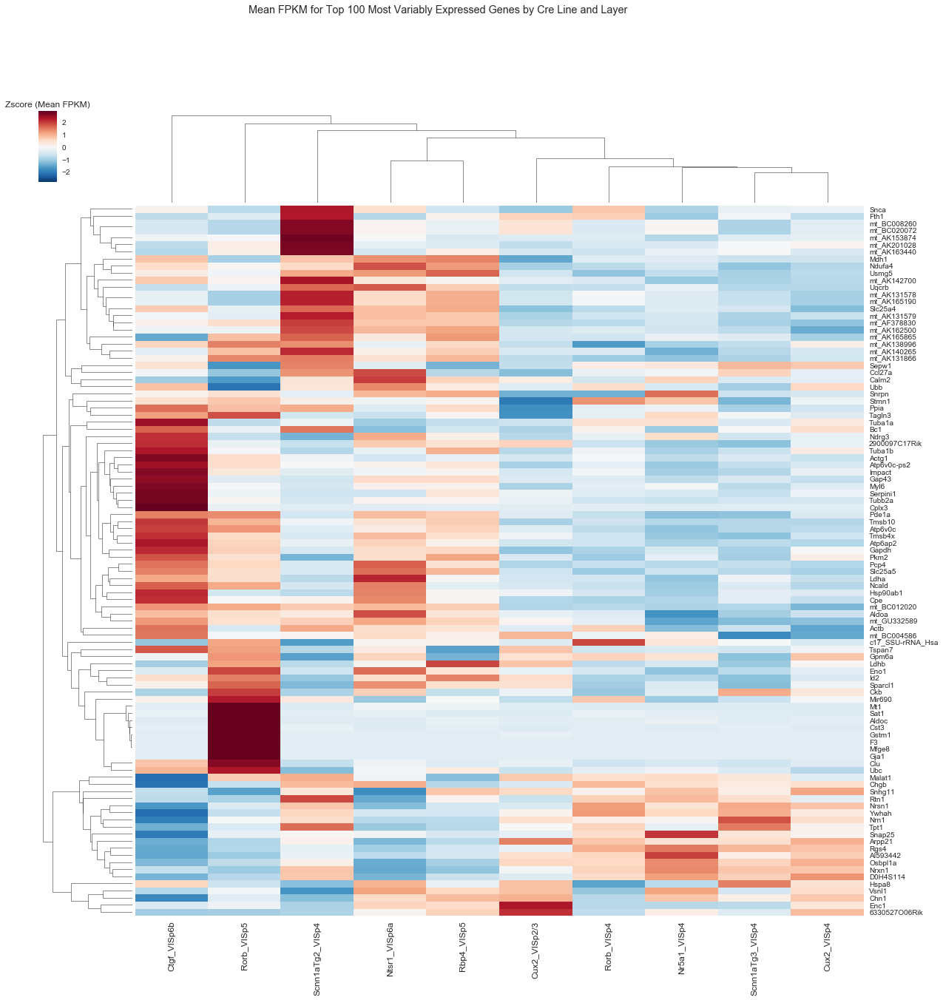

In [16]:
#2017-08-30
#Mean FPKM for Top 100 Most Variably Expressed Genes by Cre Line and Layer
#make heatmap
by_layer = True
drive_path = drive_path
genes = list(data.index) #set default genes to all genes in the dataset
#data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class = load_data(drive_path)

features = ['number_bifurcations', 'total_volume', 'average_diameter', 'number_tips', 'total_length',
            'overall_width', 'number_stems', 'number_branches', 'branchiness', 'is_spiny', 'area', 'transgenic_line']

df_nice_mean, crelines_morph = get_morphology(drive_path, features, group_by_layer = by_layer)
data_means, celltype_proportions_df, crelines_rnaseq = filter_data(data, genes, name_to_dissection, name_to_class, group_by_layer = by_layer)
data_means_rnaseq, df_morph, line_labels = match_datasets(data_means, df_nice_mean, crelines_morph, crelines_rnaseq, celltype_proportions_df, group_by_layer = by_layer)

X=101
output_path = output_path
data_out = variance_plots(data_means_rnaseq,output_path,100)


In [12]:
# 2017-08-29
# Look up GO terms

# GO_terms = ['ensheathment of neurons', 'establishment of cell polarity', 'excitatory synapse assembly', 
#             'inhibitory synapse assembly', 'maintenance of postsynaptic density structure',
#             'maintenance of presynaptic active zone structure', 'maintenance of synapse structure',
#             'postsynapse assembly', 'dendrite guidance', 'dendritic spine morphogenesis', 'axon target recognition',
#             'pyramidal neuron development', 'regulation of cell ahesion mediated by cadherin']

# GO_terms = ['transcription factor activity, core RNA polymerase I binding', 'transcription factor activity, core RNA polymerase II binding',
#             'transcription factor activity, core RNA polymerase III binding', 'neurotransmitter receptor regulator activity',
#             'morphogen activity']

# GO_terms = ['transcription factor activity, core RNA polymerase binding', 
#             'transcription factor activity, RNA polymerase II transcription factor binding',
#             'RNA polymerase II transcription cofactor activity']

# 2017-08-30
# Test re-structured code with and without filtering by layer on 'synapse organization' GO term
# Code still works the same when not filtering by layer
# Results are very different when layers are considered!
# Deleted heatmaps because labeling was ugly, and both are present in other analyses

GO_terms = ['synapse organization', 'cell adhesion', 'ensheathment of neurons', 'establishment of cell polarity', 
            'excitatory synapse assembly', 'inhibitory synapse assembly', 'maintenance of postsynaptic density structure',
            'maintenance of presynaptic active zone structure', 'maintenance of synapse structure',
            'postsynapse assembly', 'dendrite guidance', 'dendritic spine morphogenesis', 'axon target recognition',
            'pyramidal neuron development', 'regulation of cell ahesion mediated by cadherin',  
            'neurotransmitter receptor regulator activity', 'morphogen activity', 
            'transcription factor activity, core RNA polymerase binding', 
            'transcription factor activity, RNA polymerase II transcription factor binding',
            'RNA polymerase II transcription cofactor activity']

genes_dict = {}
for GO_term in GO_terms:
    g = goterm_to_genes(GO_term)
    if len(g) > 1:
        genes_dict[GO_term] = g
print('Finished!')

  EXISTS: go-basic.obo
  EXISTS: gene2go
17409 GO terms associated with mouse NCBI Entrez GeneIDs
load obo file go-basic.obo
go-basic.obo: fmt(1.2) rel(2017-08-29) 49,075 GO Terms
268 mouse NCBI Entrez GeneIDs related to synapse organization found.
  EXISTS: go-basic.obo
  EXISTS: gene2go
17409 GO terms associated with mouse NCBI Entrez GeneIDs
load obo file go-basic.obo
go-basic.obo: fmt(1.2) rel(2017-08-29) 49,075 GO Terms
1792 mouse NCBI Entrez GeneIDs related to cell adhesion found.
  EXISTS: go-basic.obo
  EXISTS: gene2go
17409 GO terms associated with mouse NCBI Entrez GeneIDs
load obo file go-basic.obo
go-basic.obo: fmt(1.2) rel(2017-08-29) 49,075 GO Terms
0 mouse NCBI Entrez GeneIDs related to ensheathment of neurons found.
  EXISTS: go-basic.obo
  EXISTS: gene2go
17409 GO terms associated with mouse NCBI Entrez GeneIDs
load obo file go-basic.obo
go-basic.obo: fmt(1.2) rel(2017-08-29) 49,075 GO Terms
90 mouse NCBI Entrez GeneIDs related to establishment of cell polarity found.


Got 267 genes


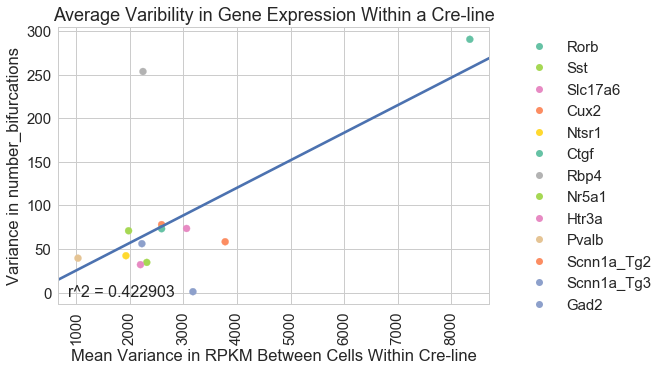

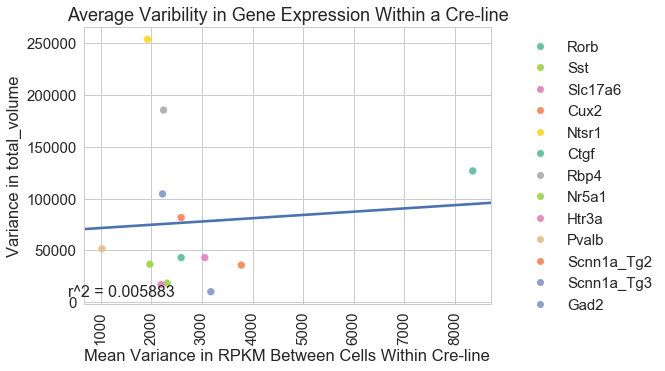

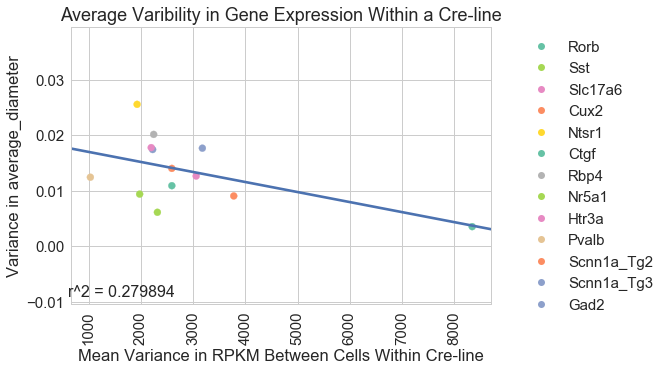

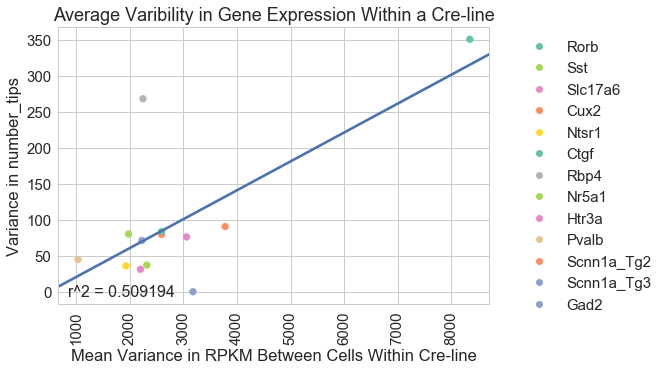

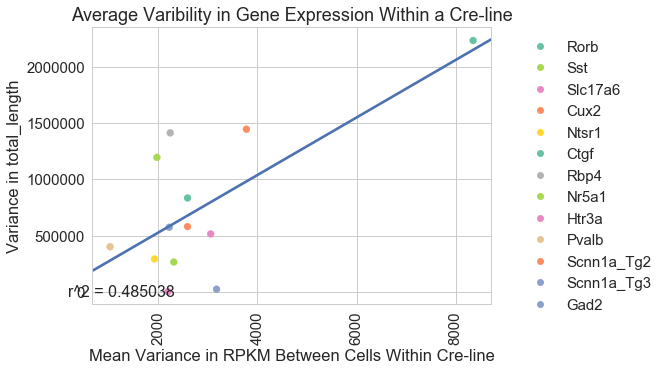

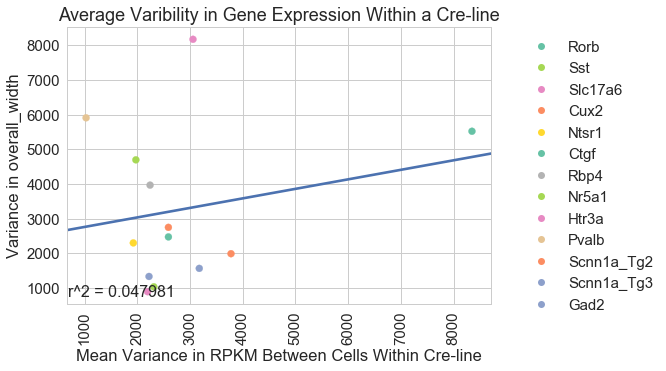

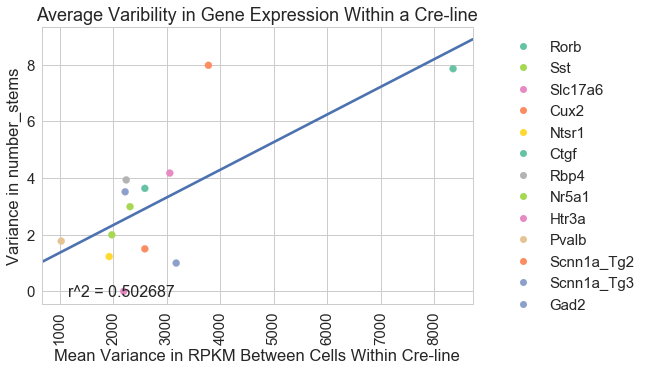

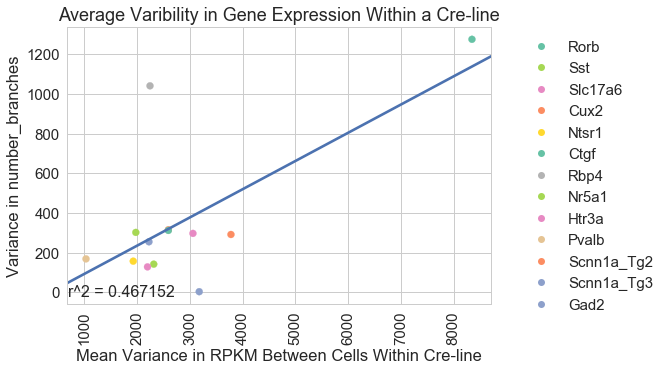

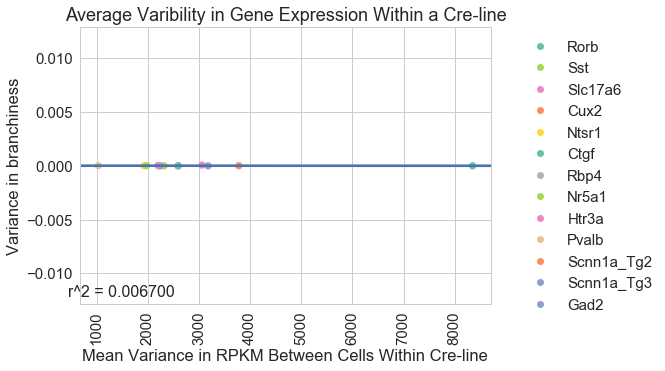

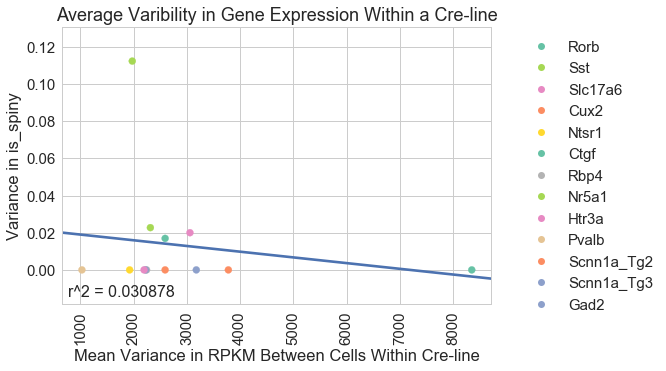

Got 59 genes


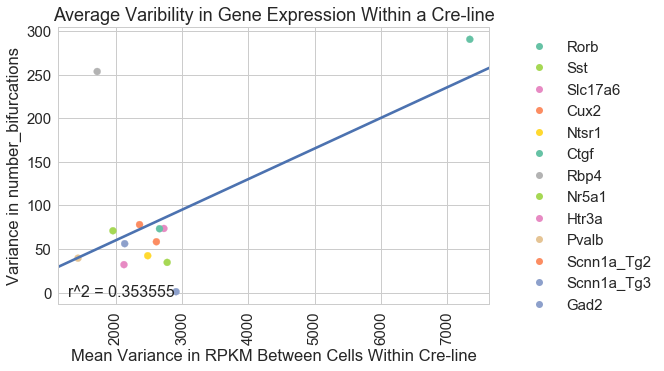

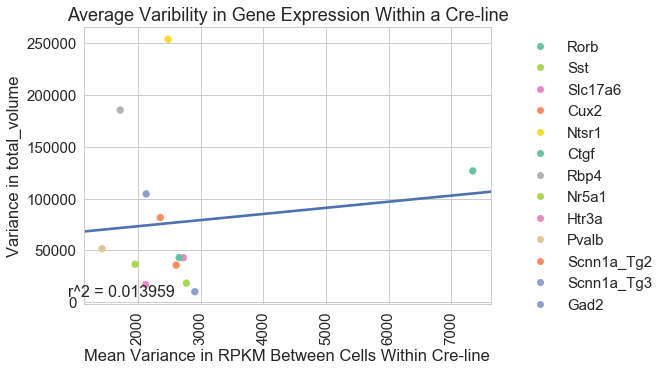

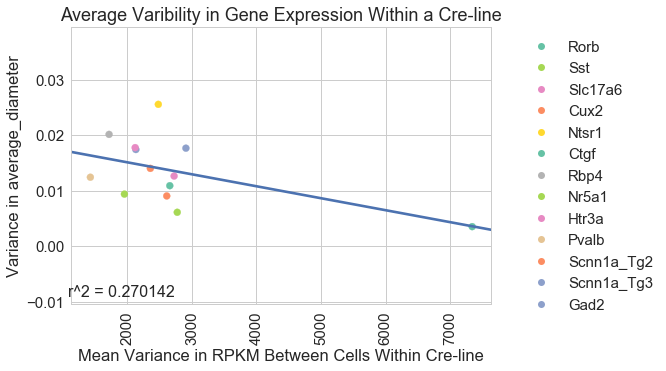

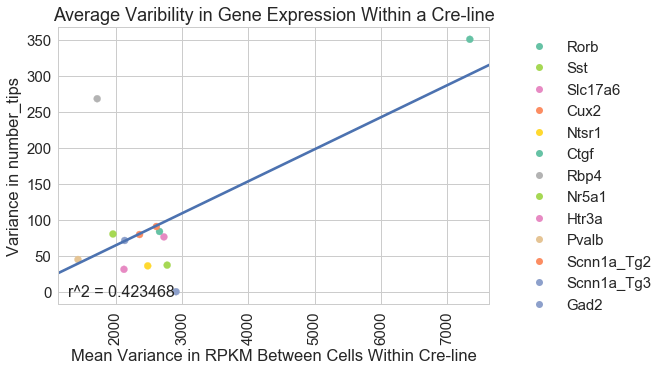

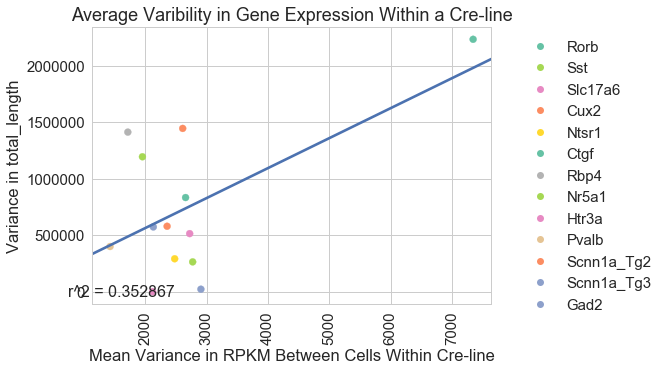

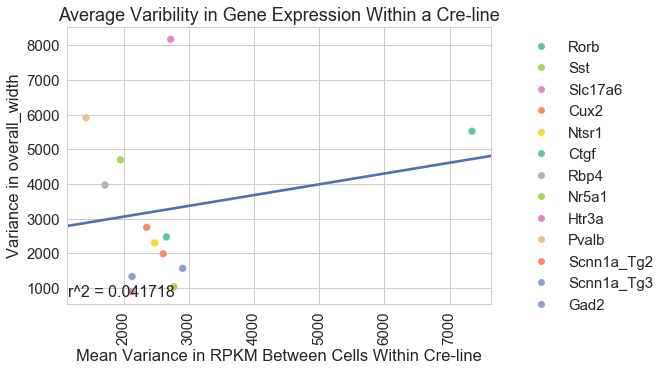

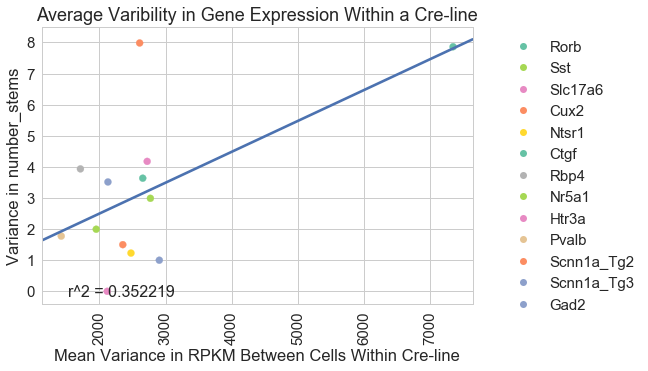

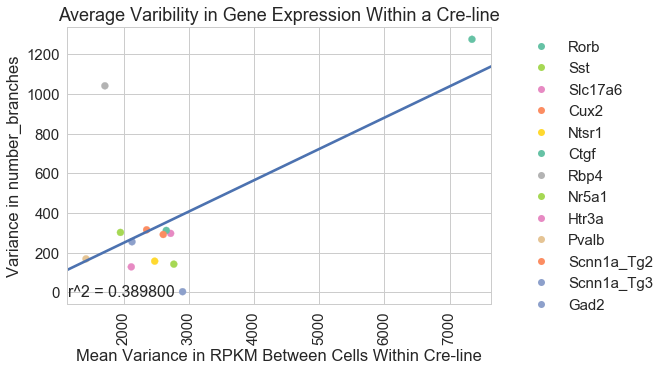

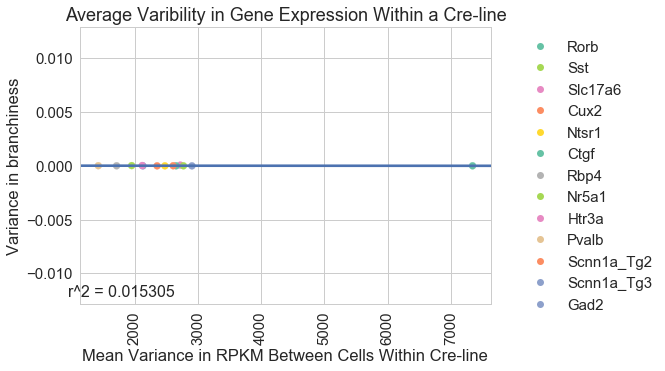

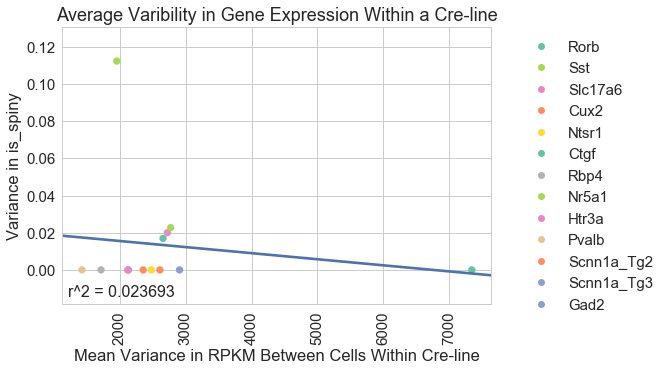

Got 96 genes


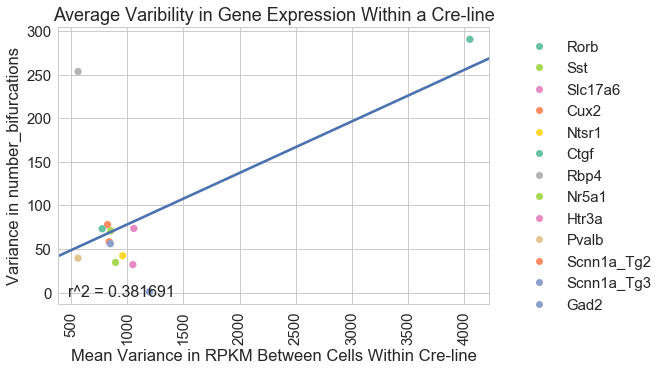

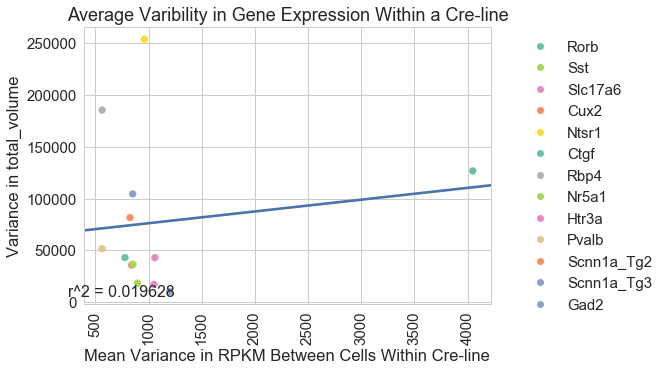

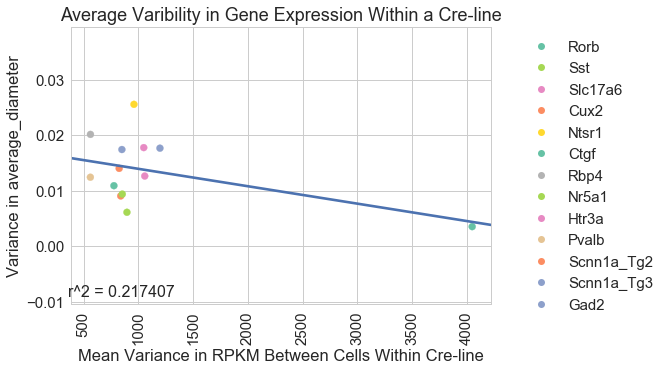

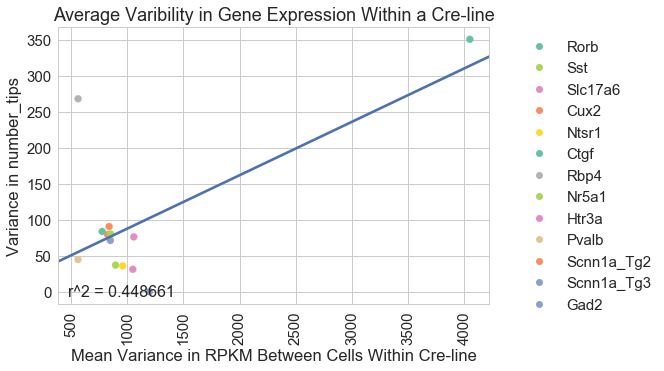

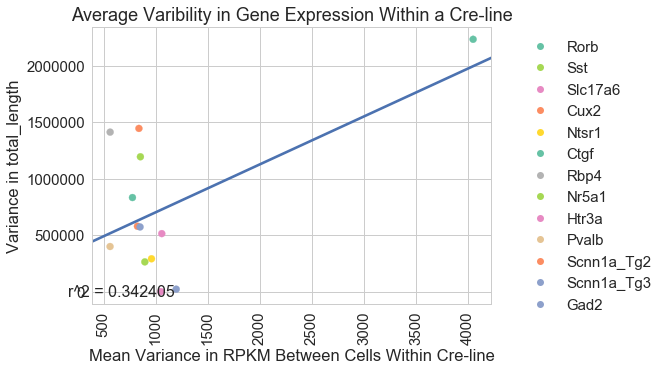

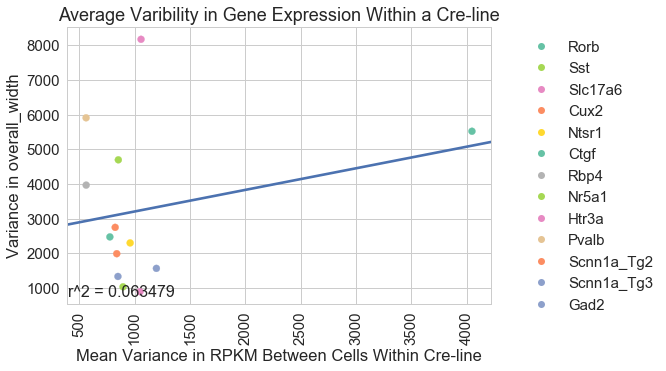

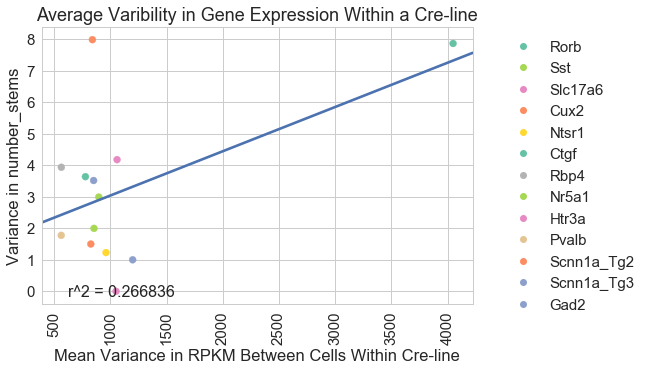

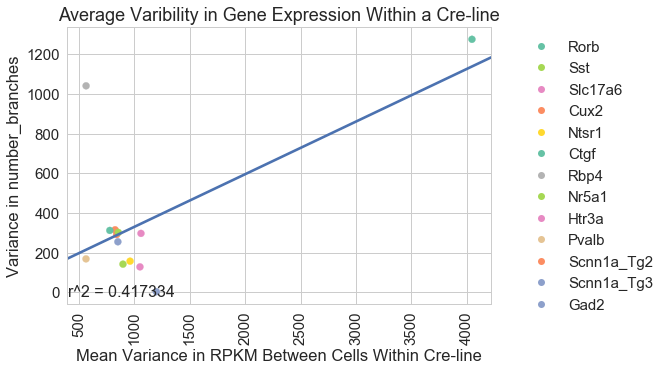

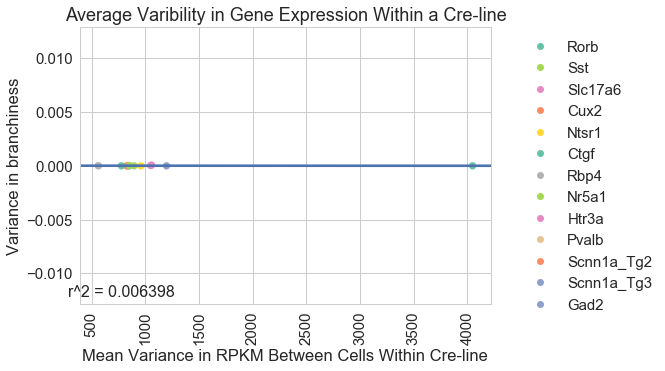

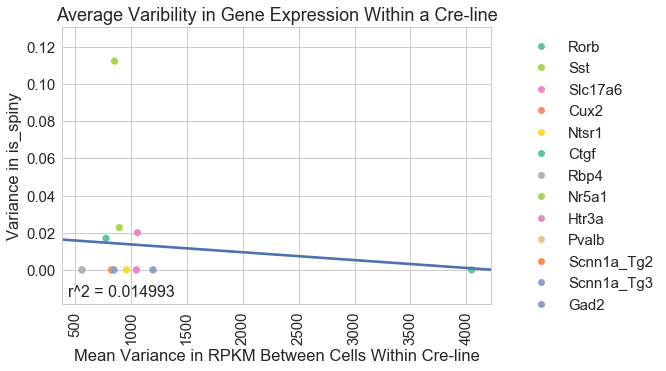

Got 90 genes


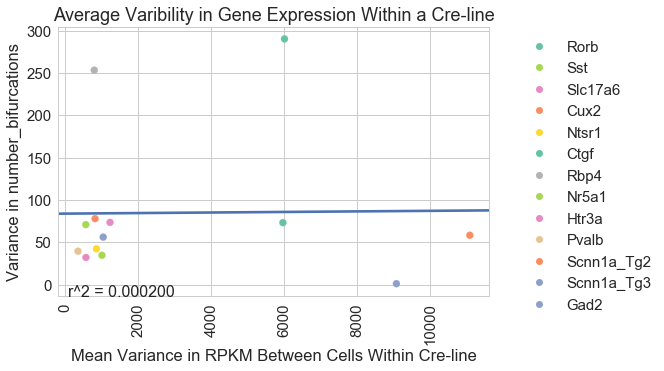

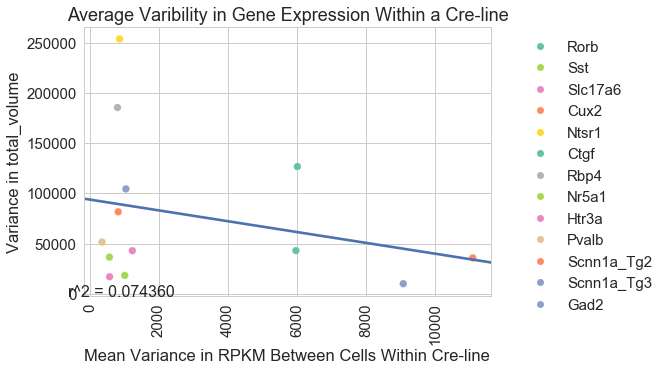

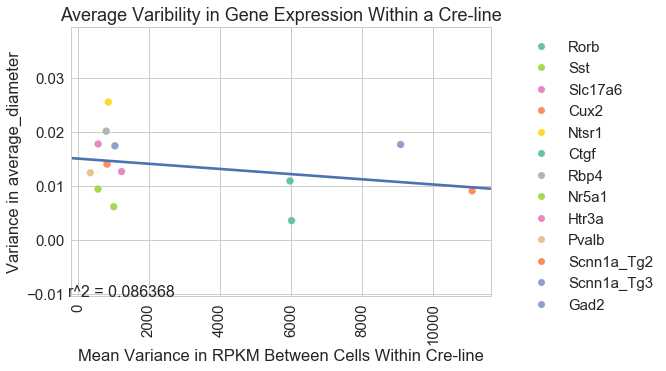

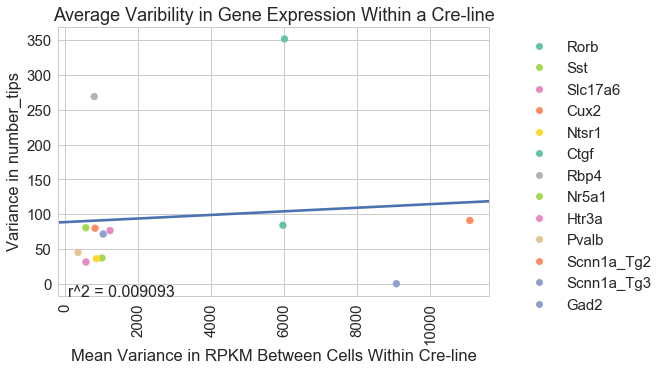

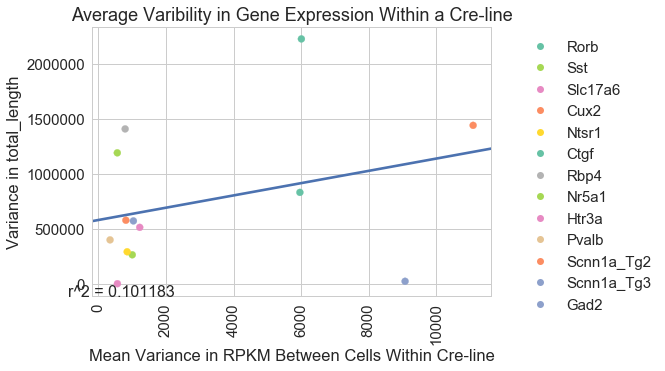

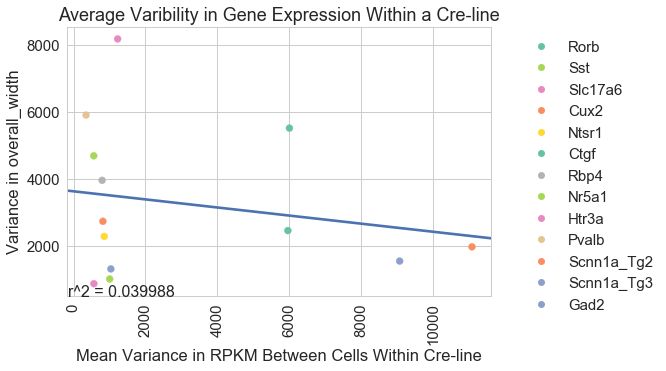

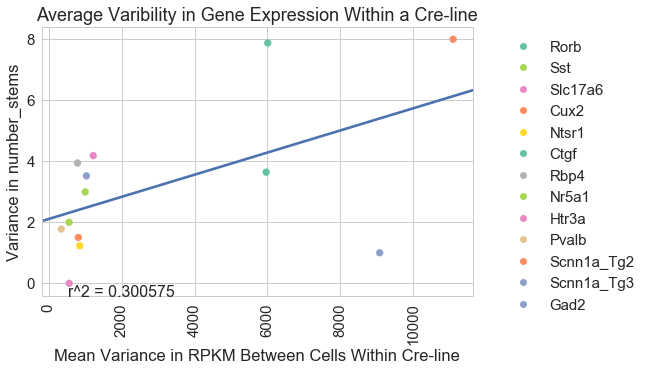

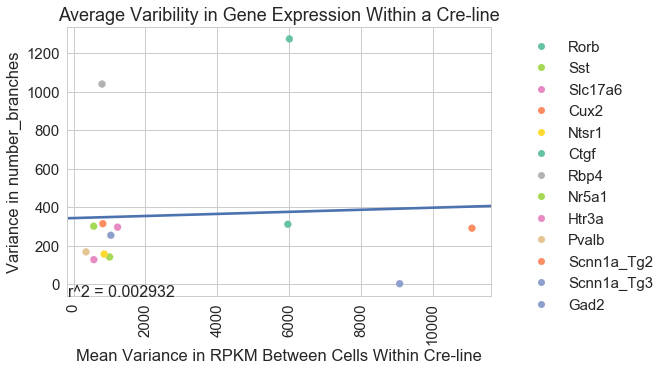

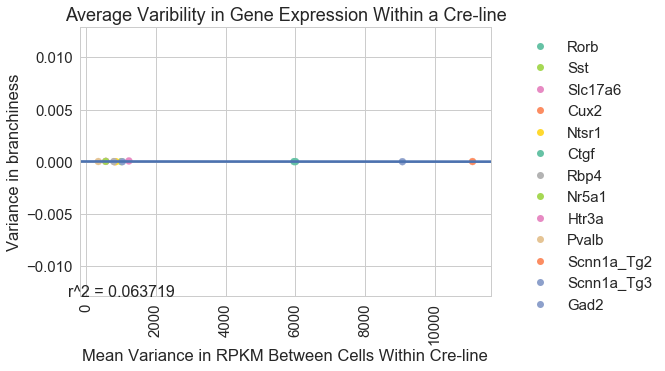

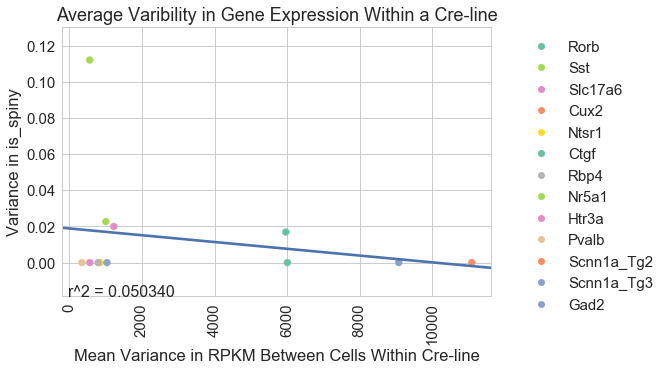

Got 2 genes


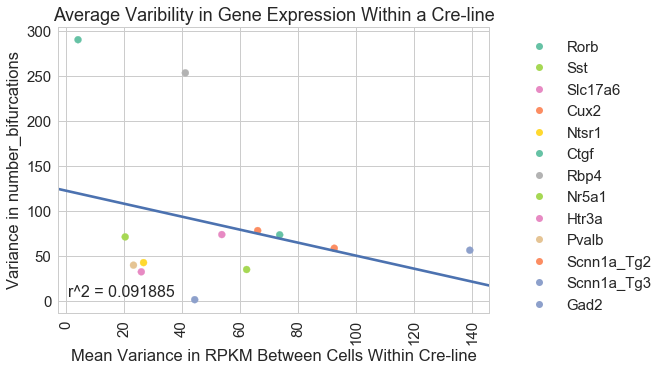

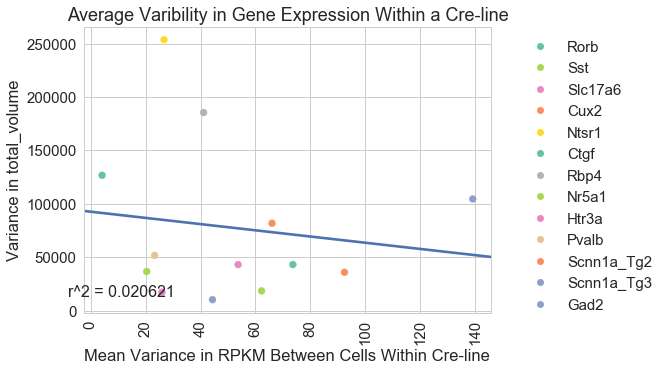

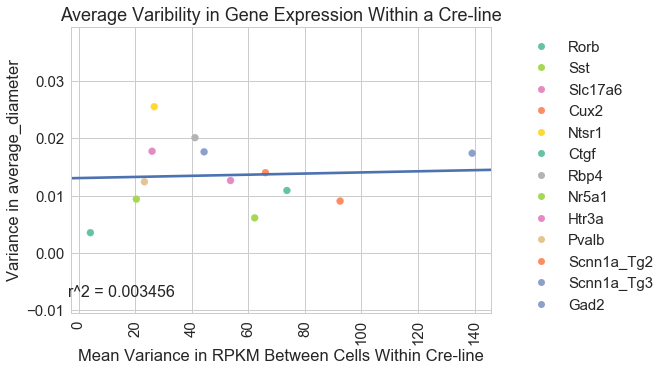

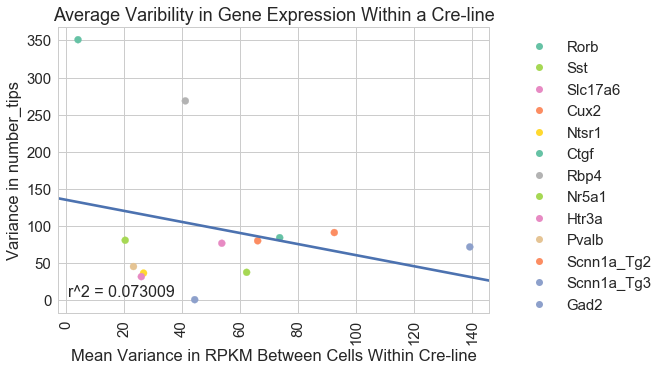

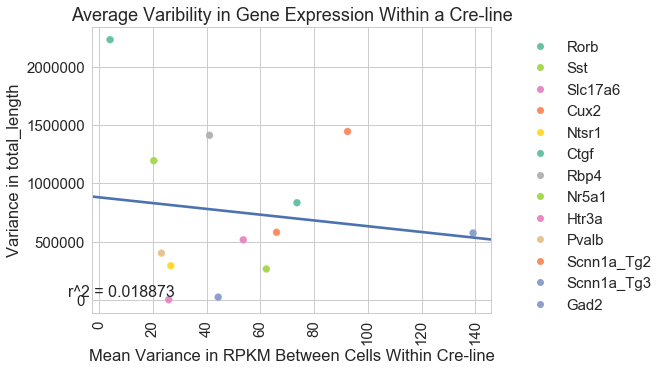

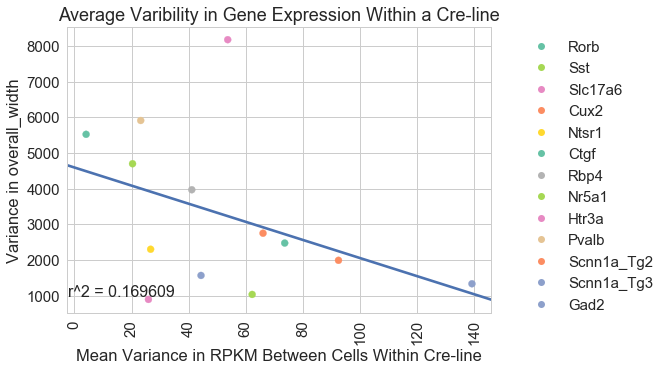

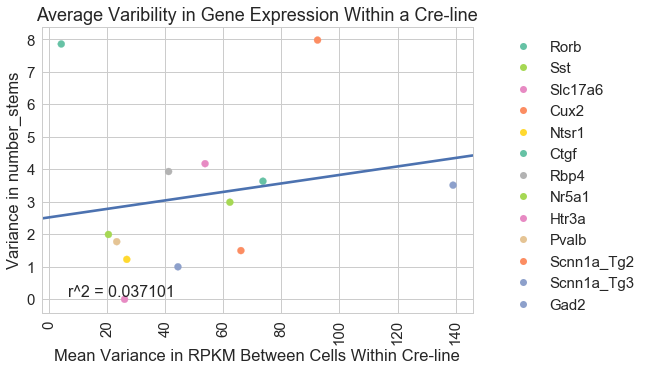

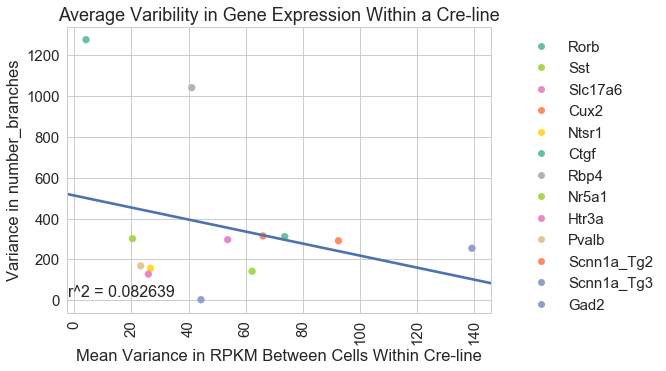

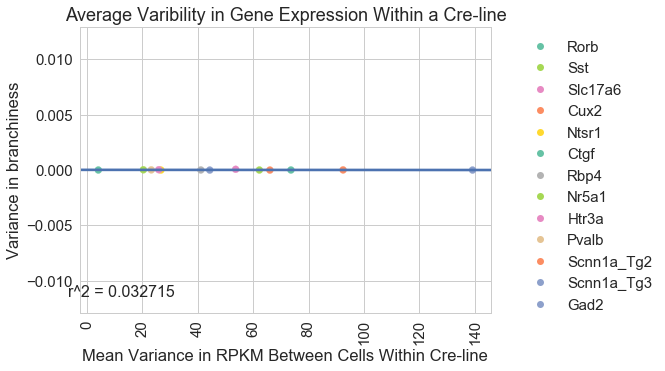

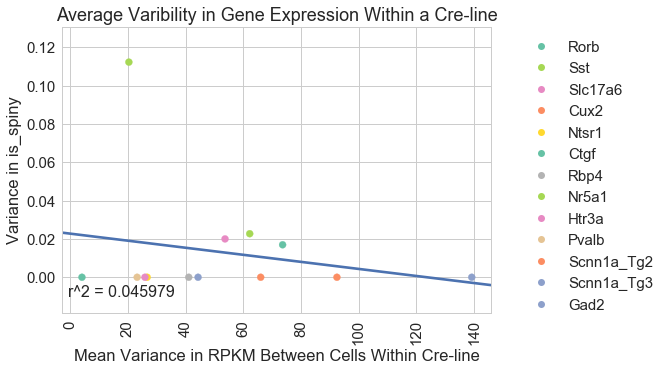

Got 3 genes


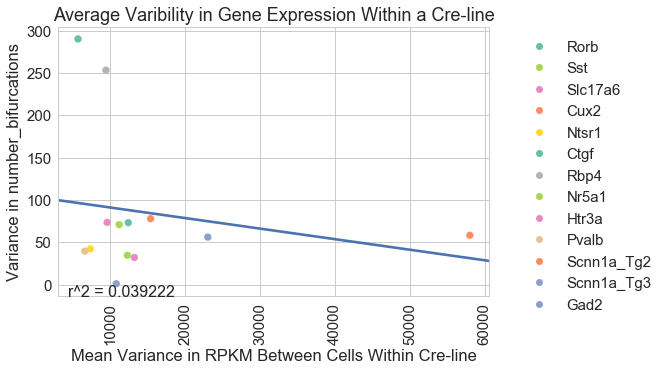

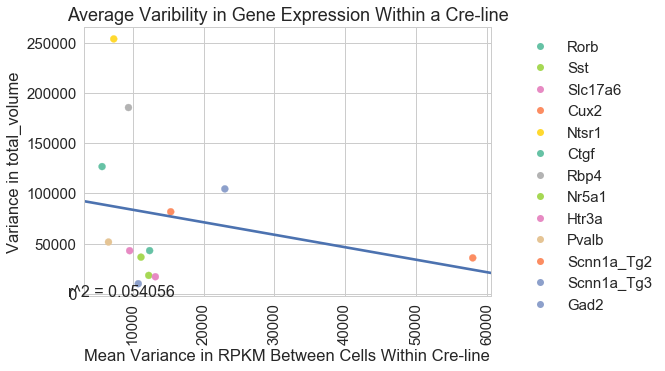

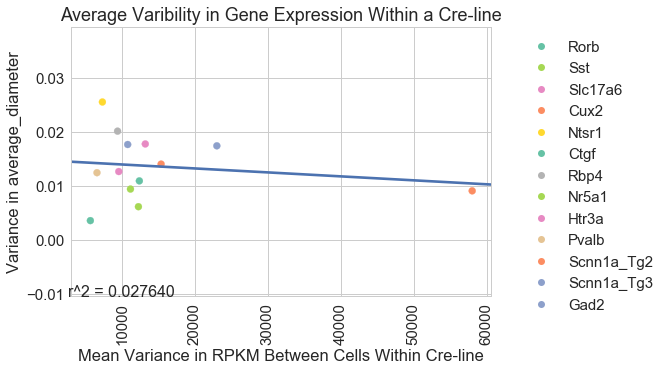

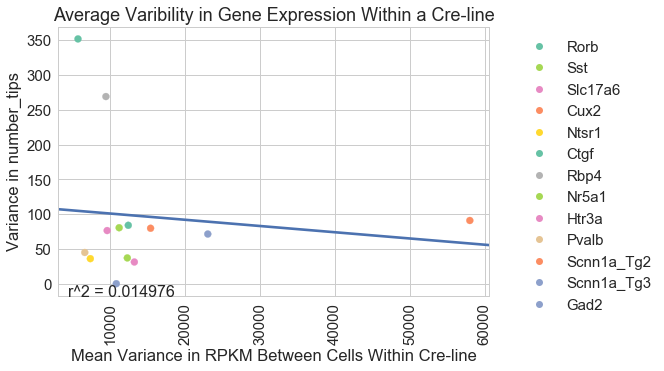

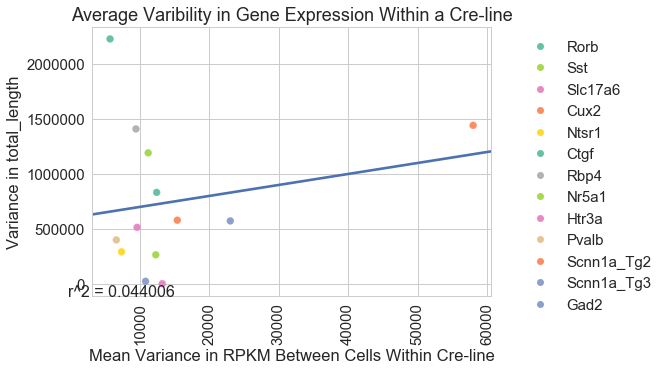

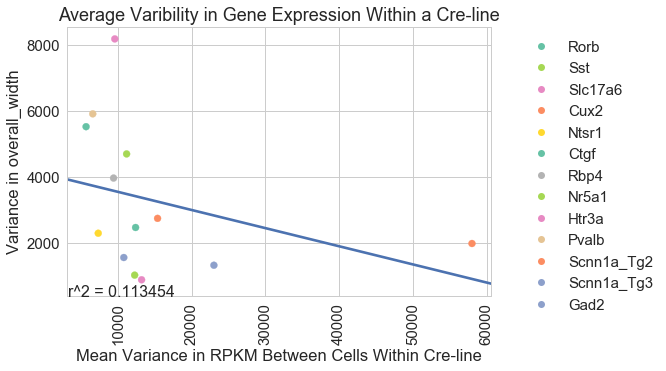

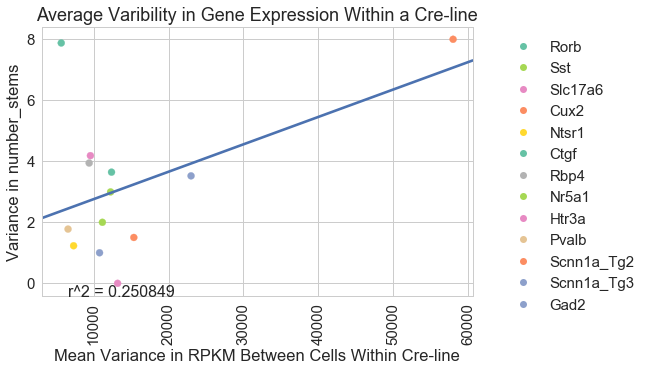

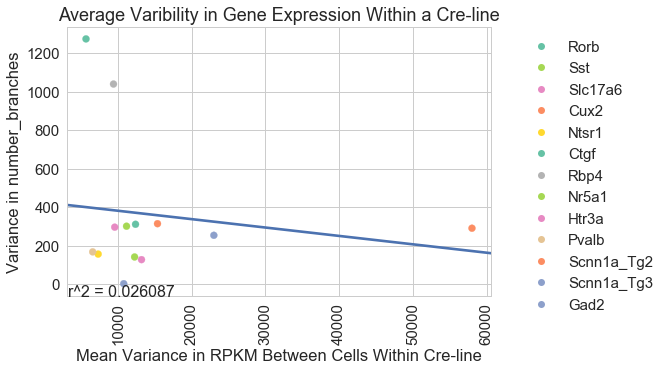

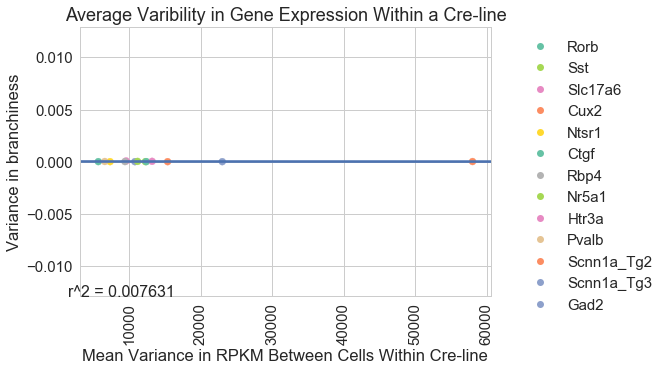

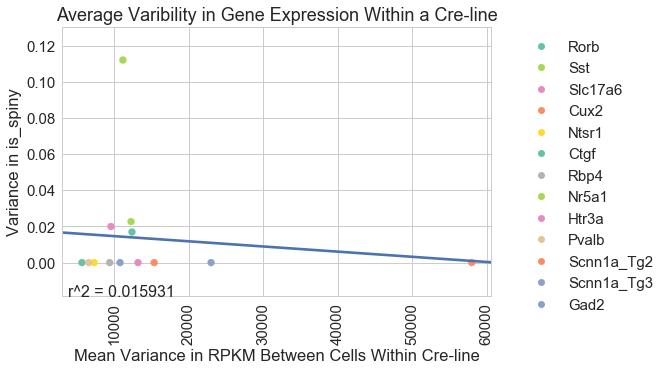

Got 9 genes


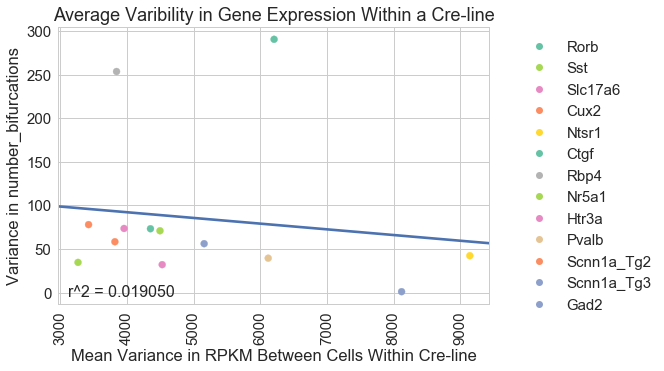

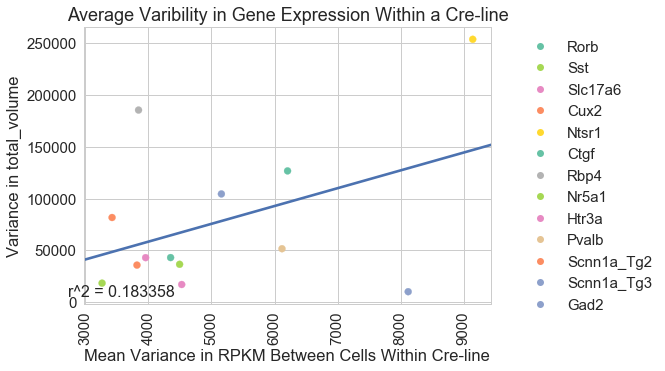

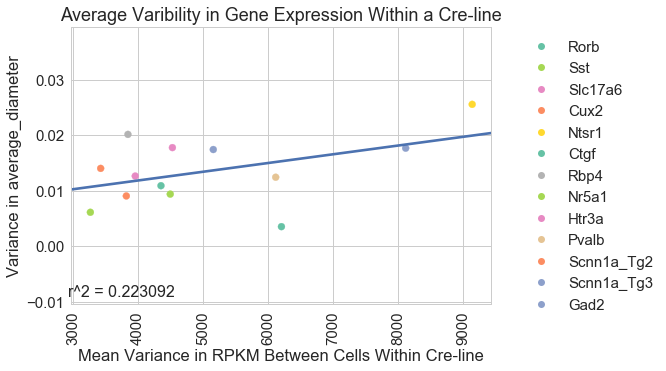

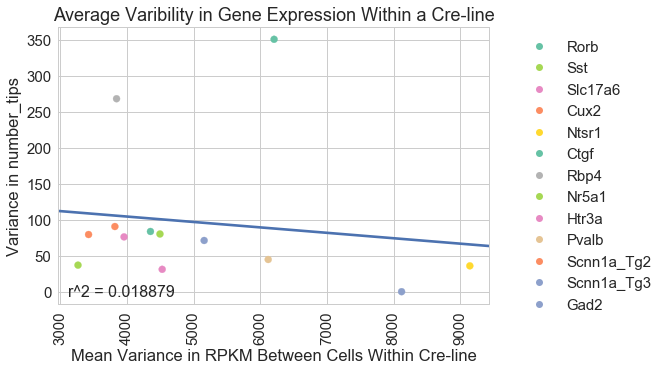

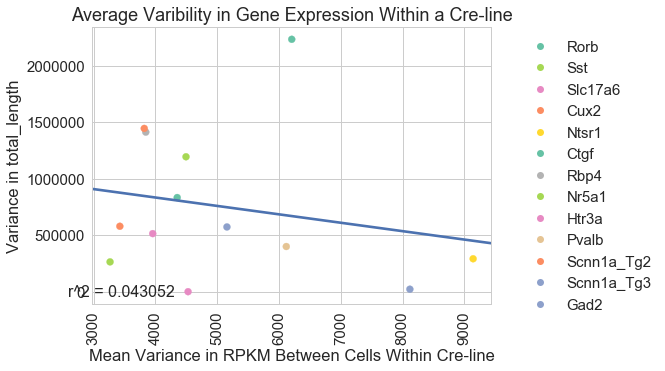

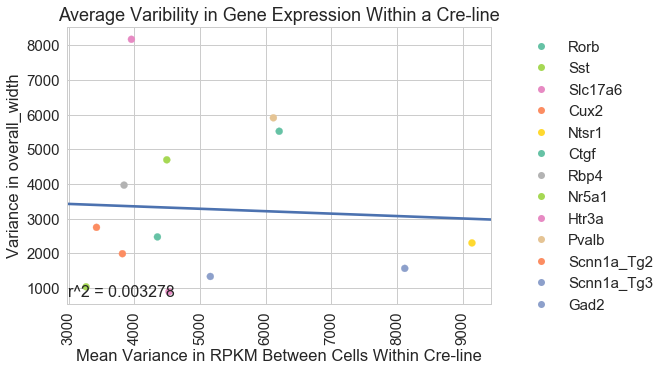

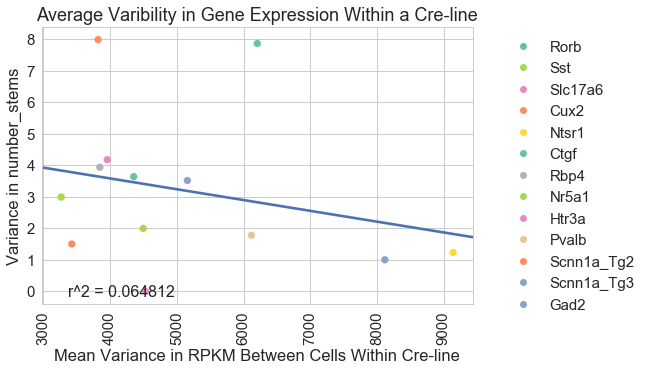

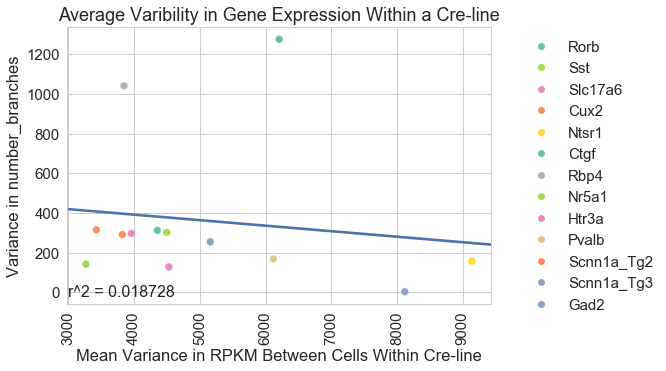

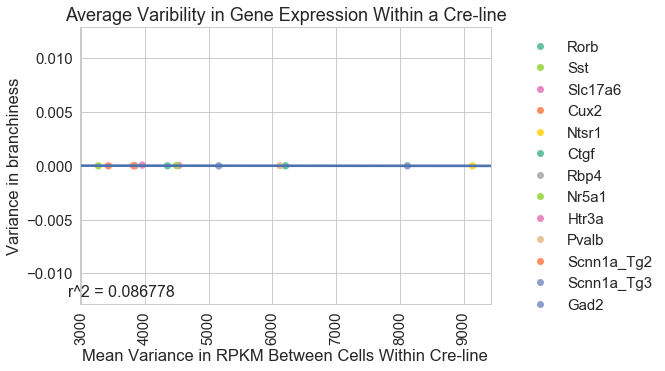

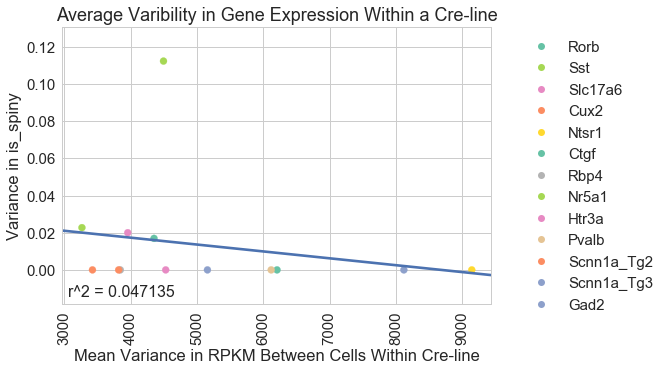

Got 154 genes


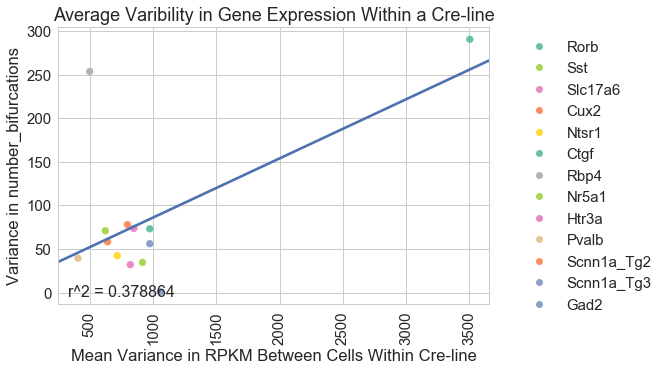

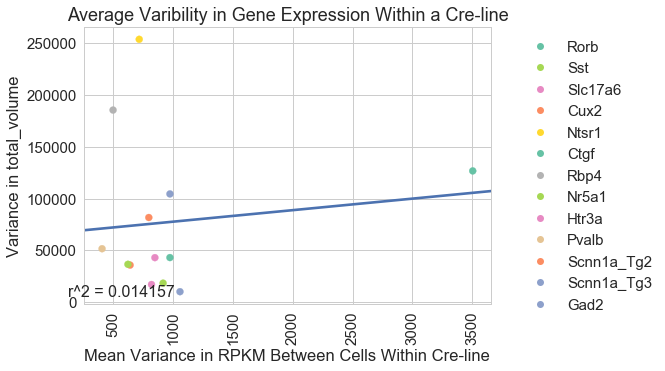

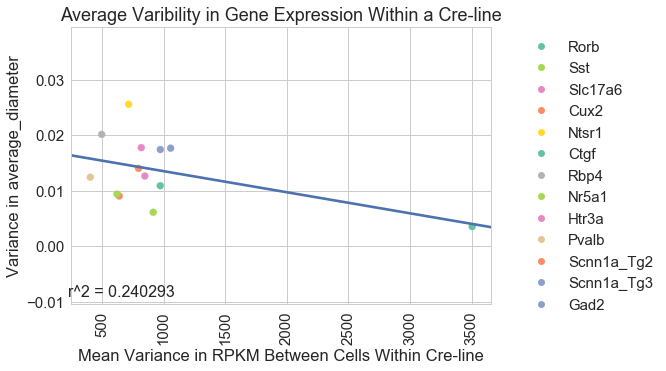

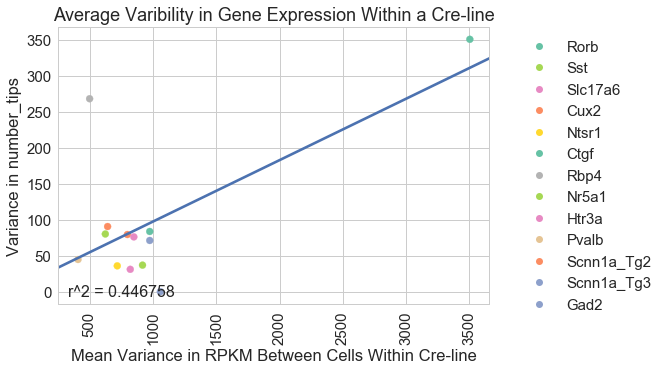

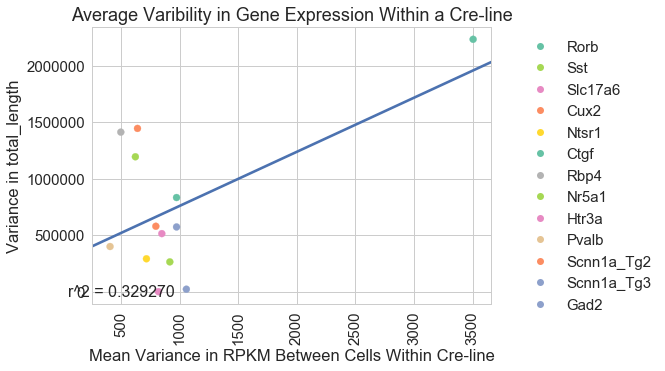

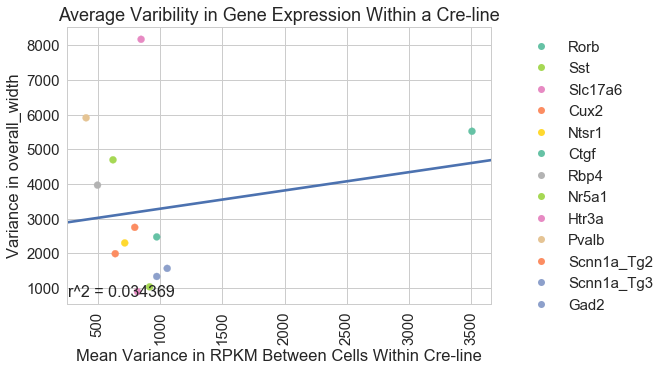

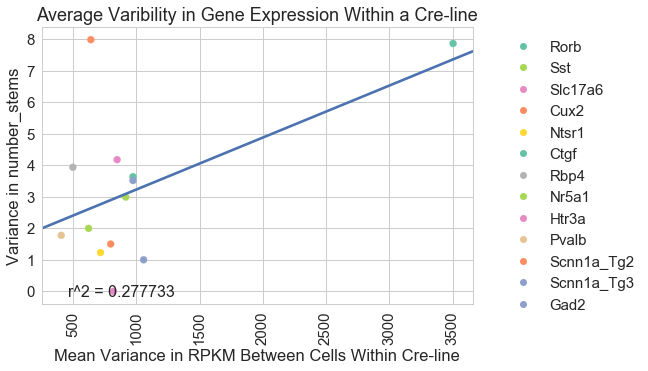

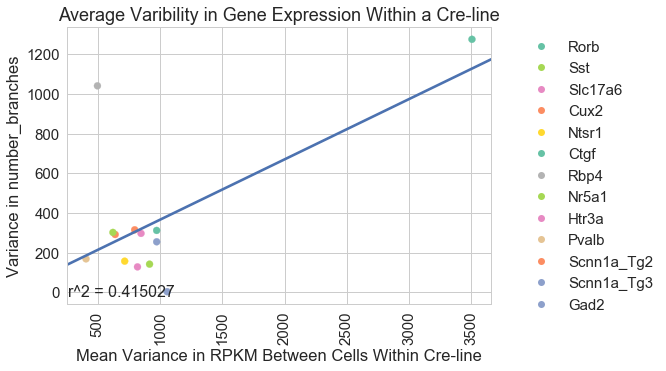

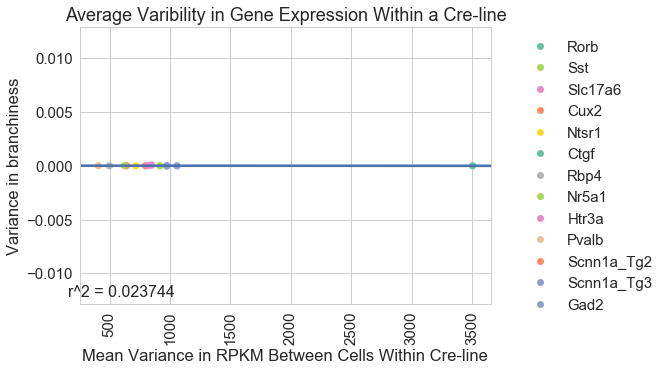

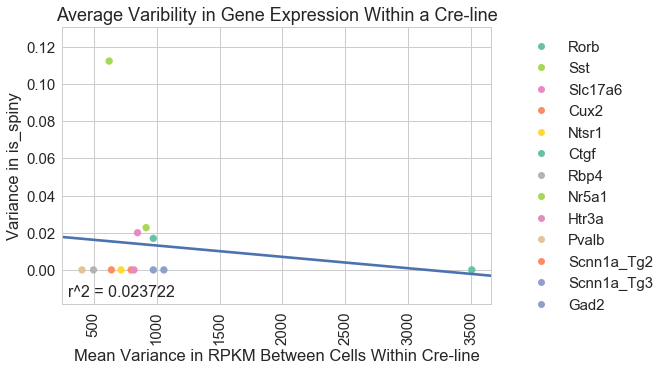

Got 3 genes


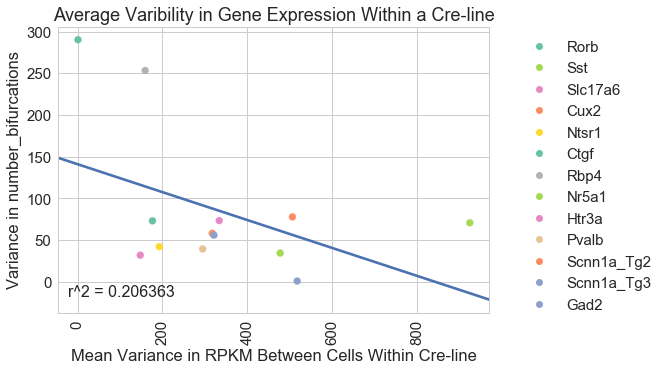

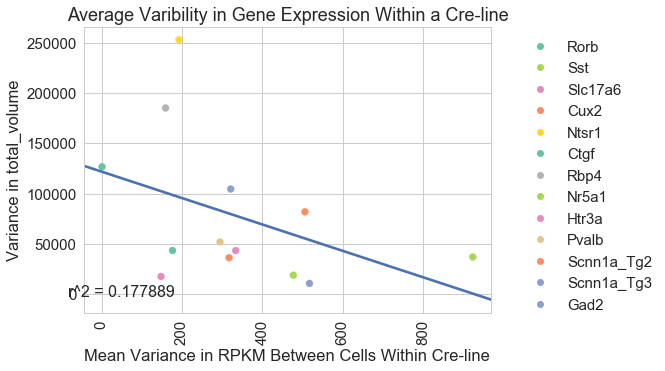

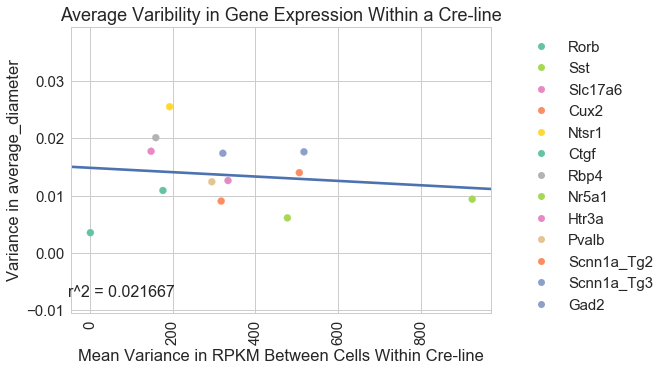

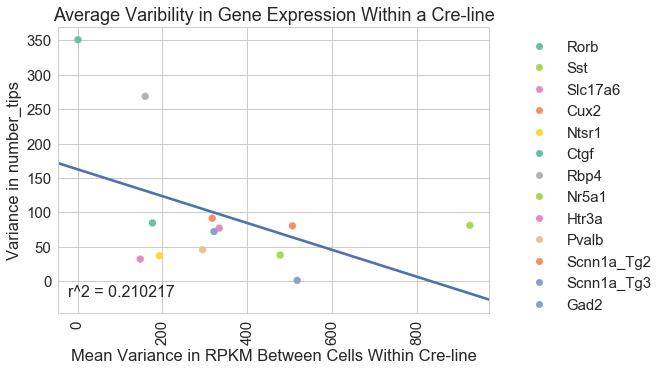

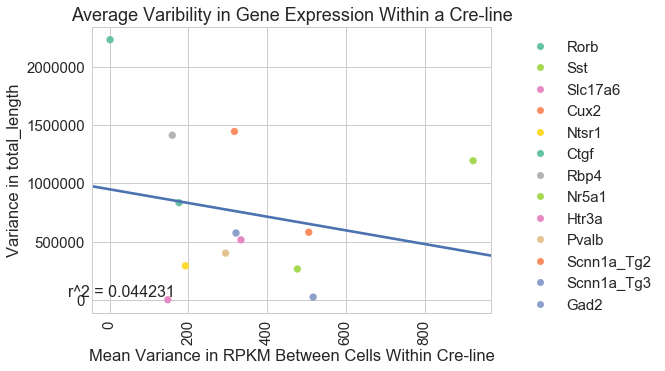

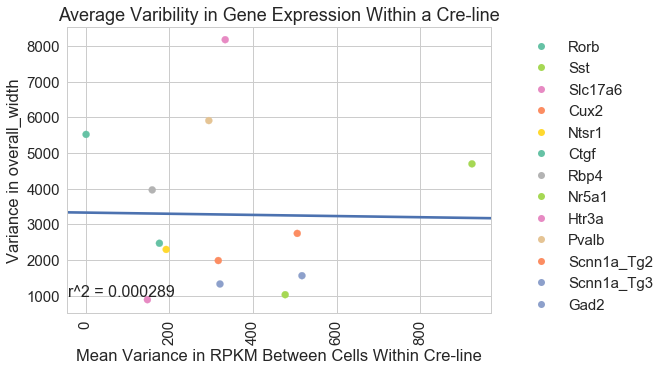

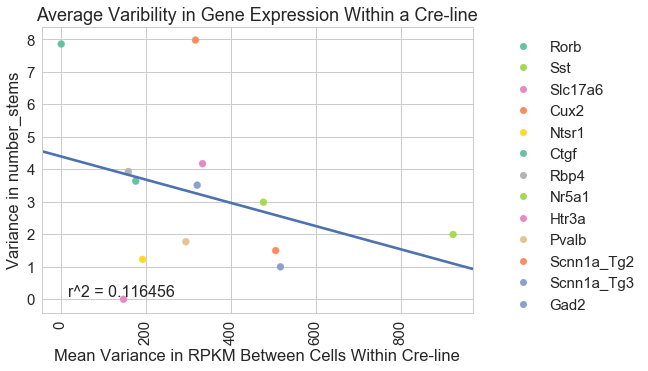

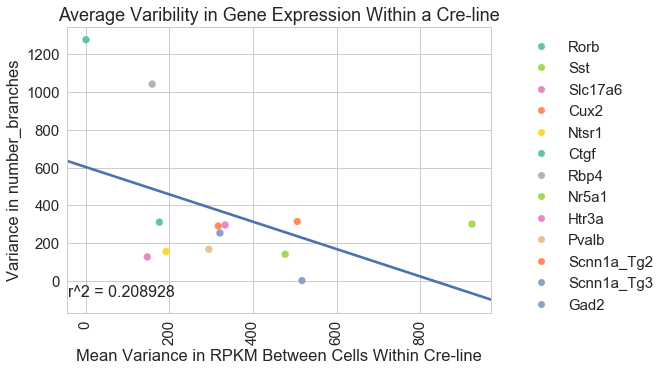

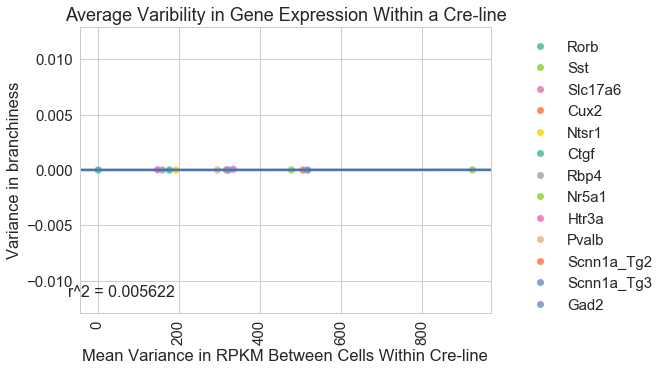

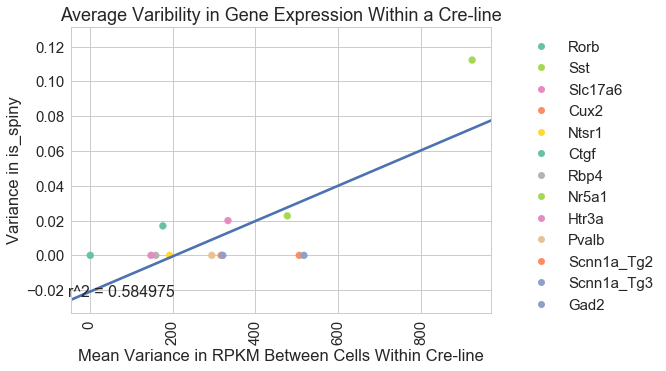

Got 4 genes


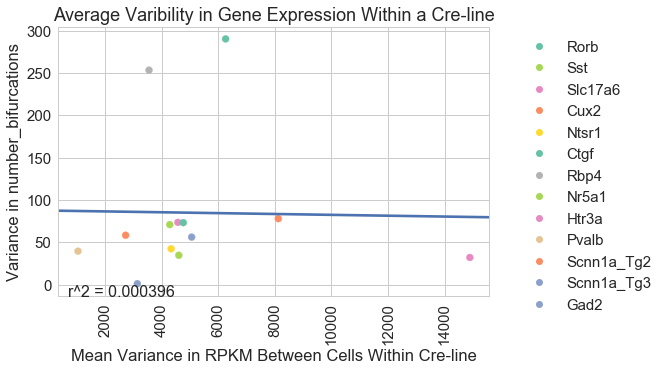

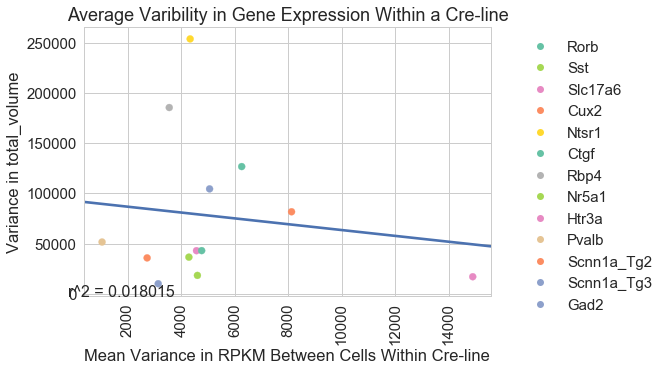

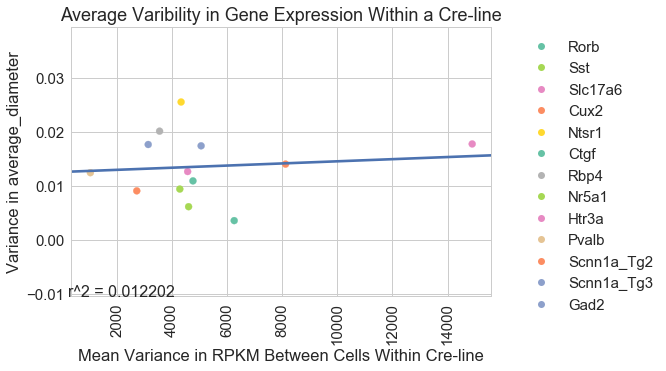

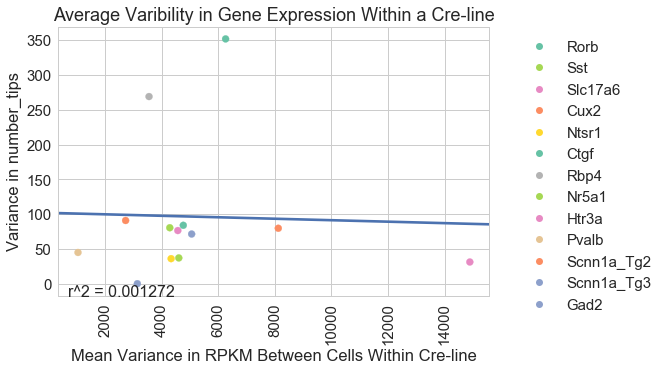

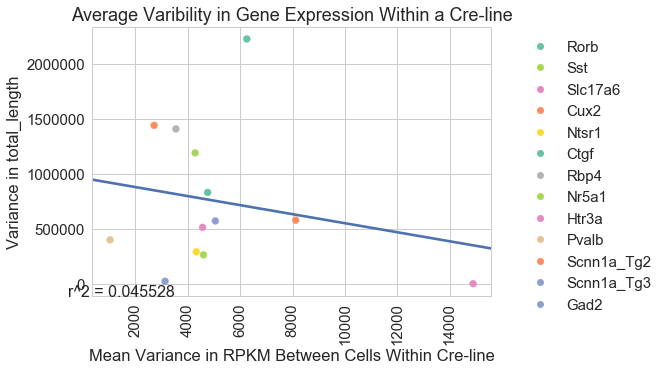

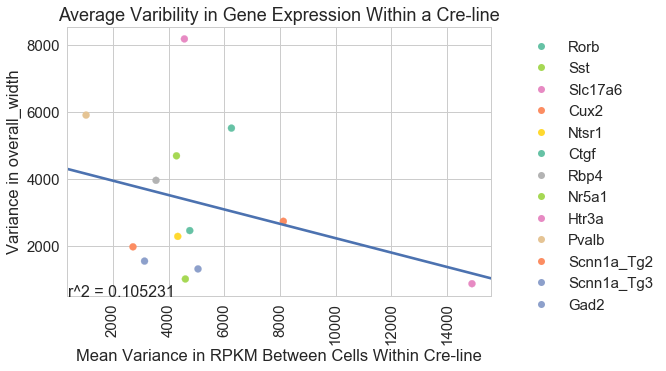

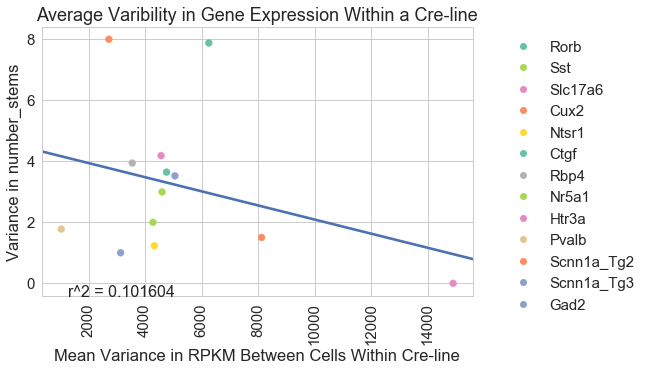

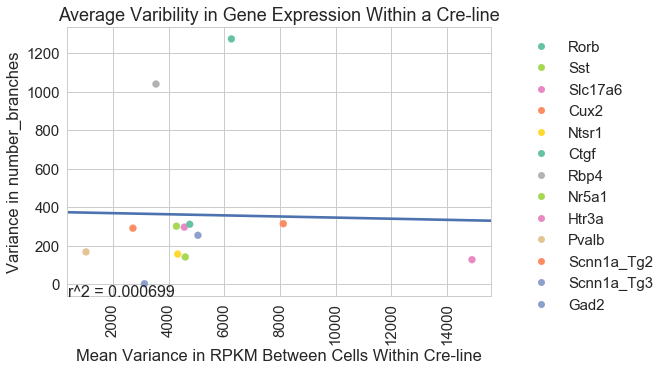

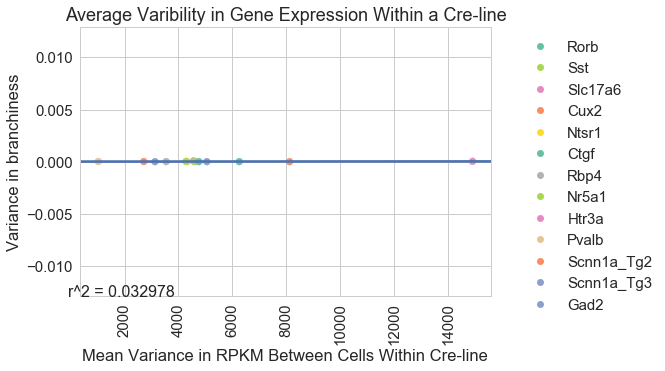

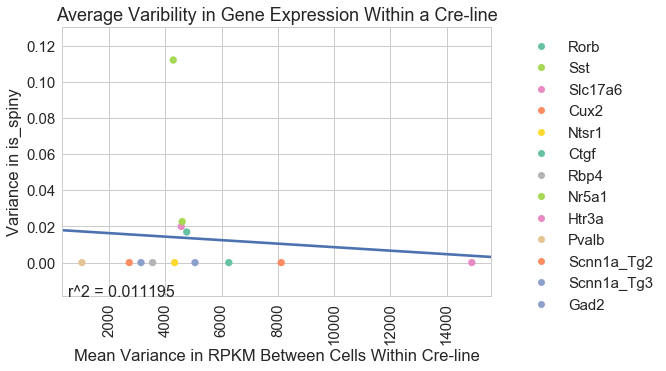

Got 1786 genes


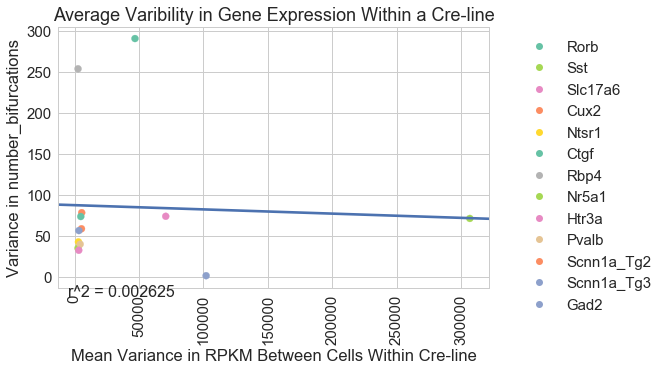

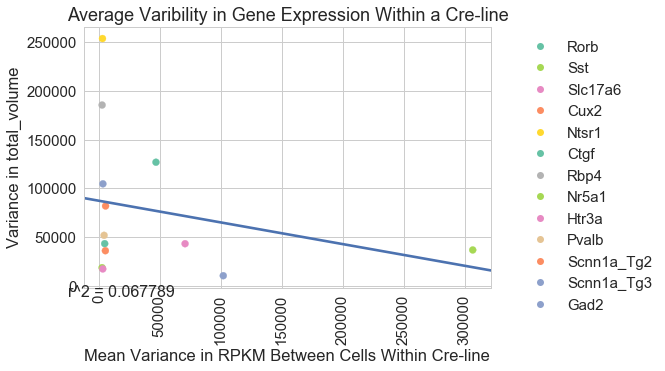

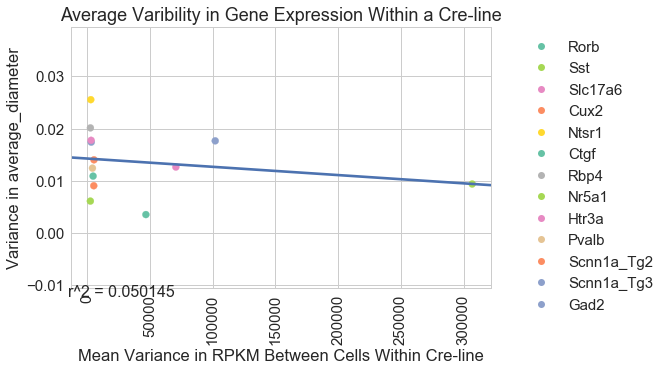

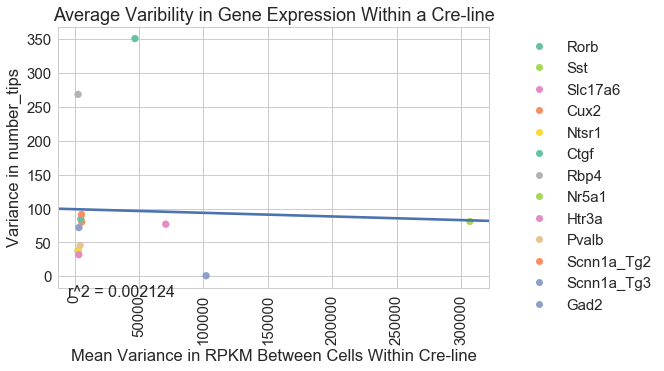

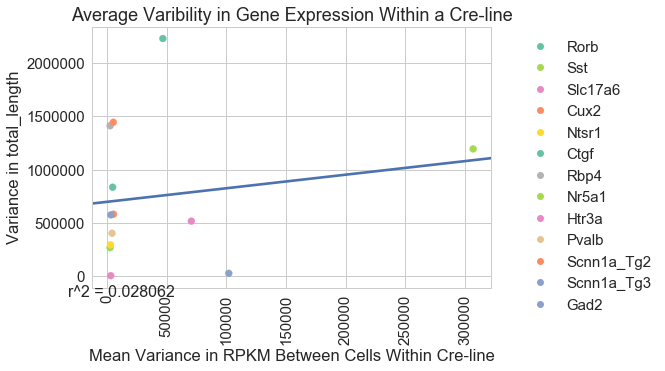

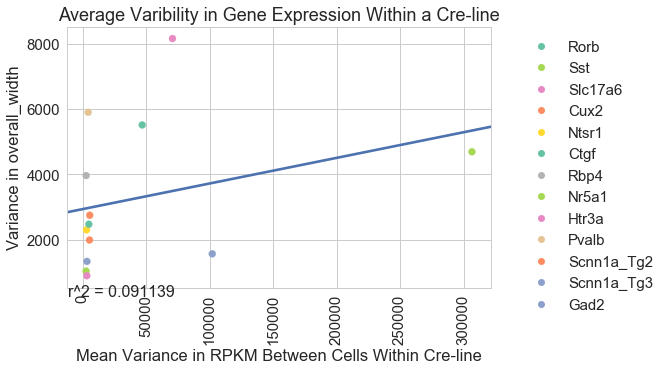

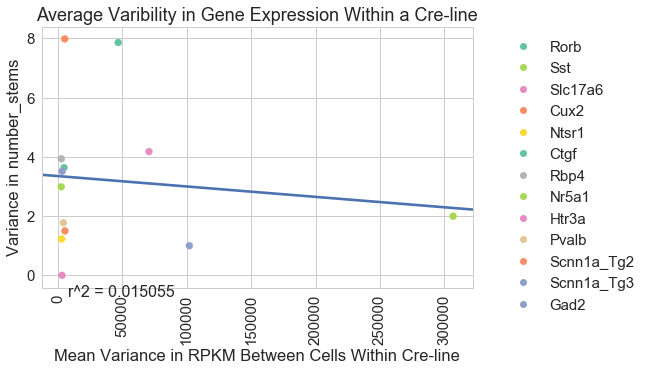

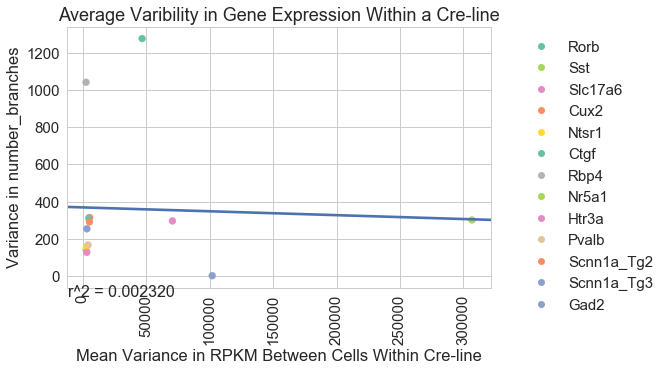

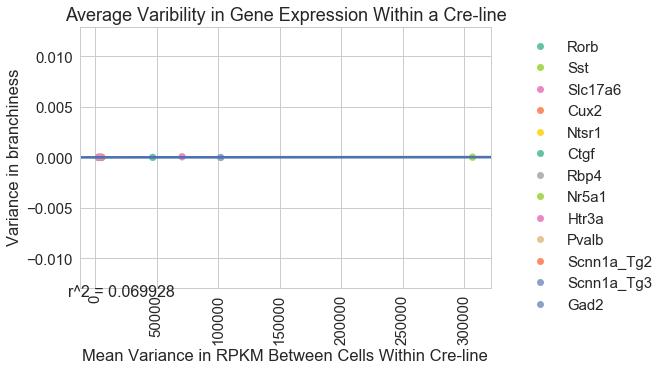

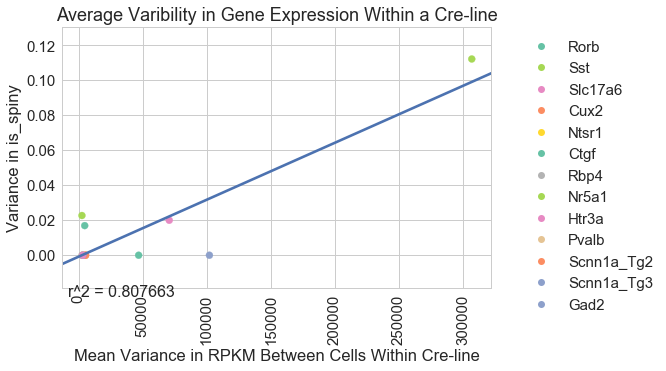

Got 4 genes


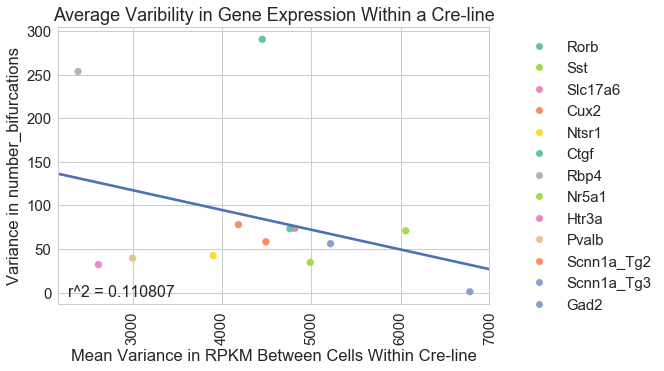

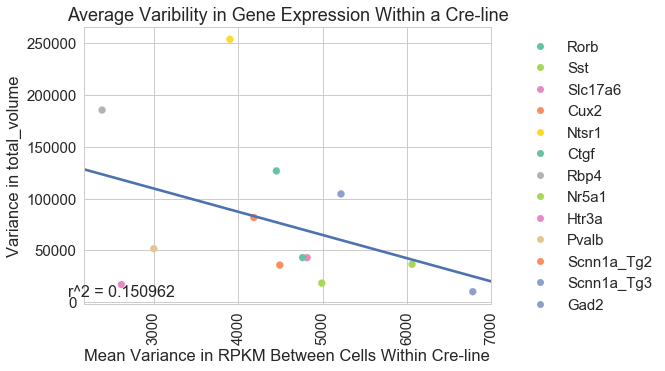

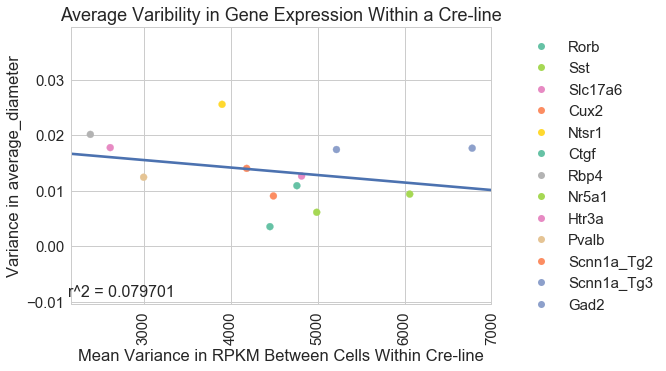

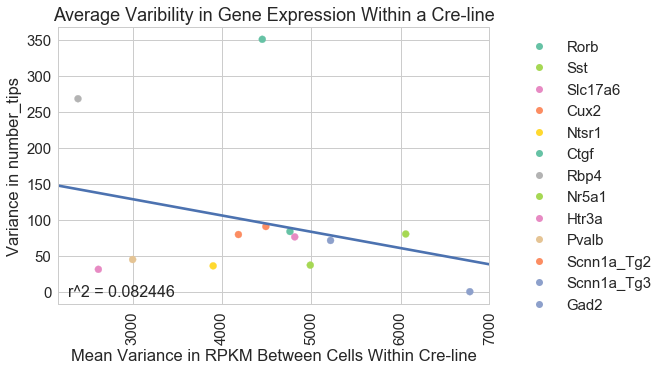

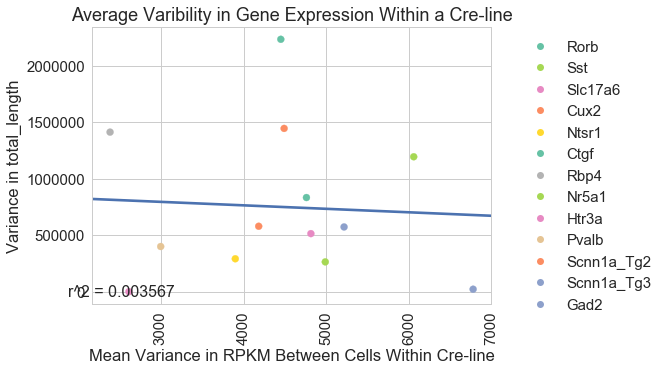

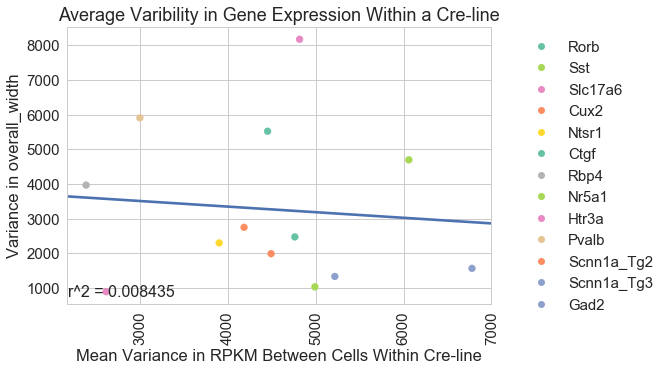

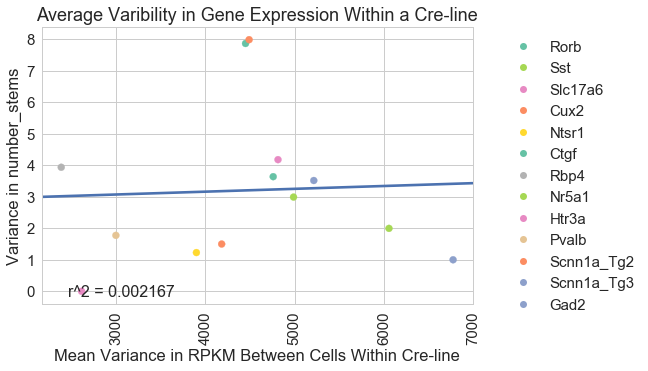

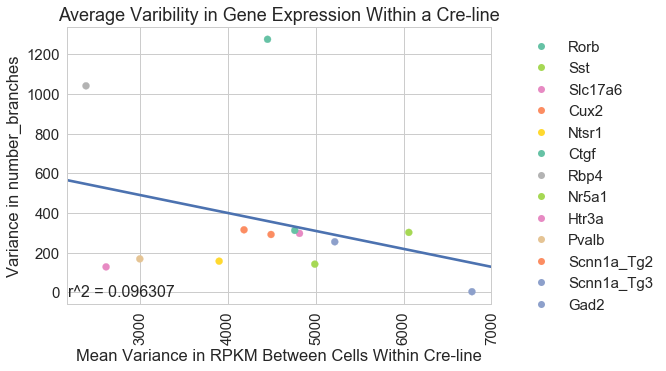

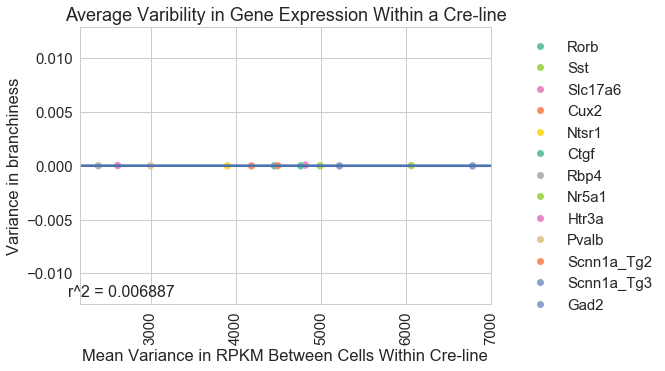

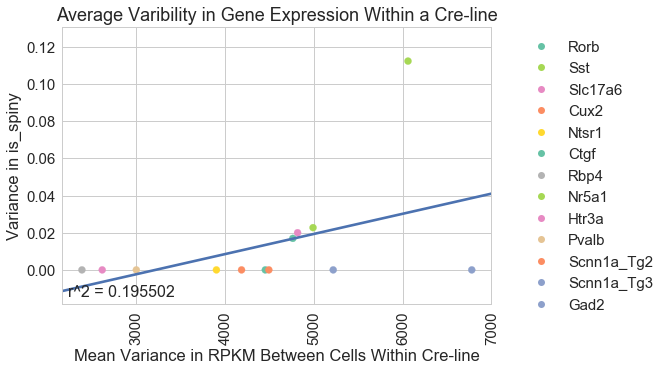

Got 8 genes


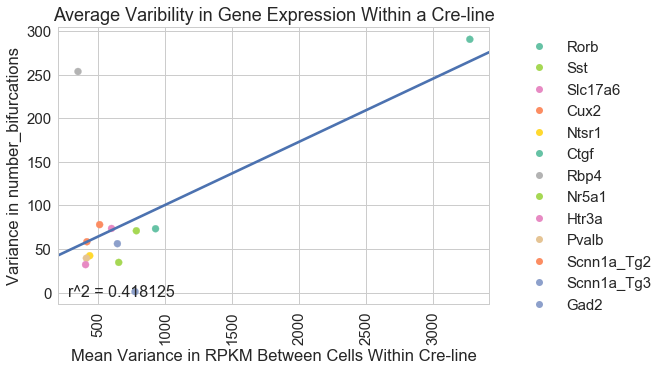

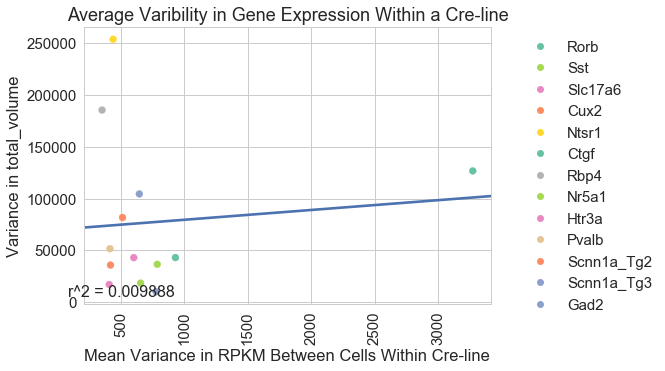

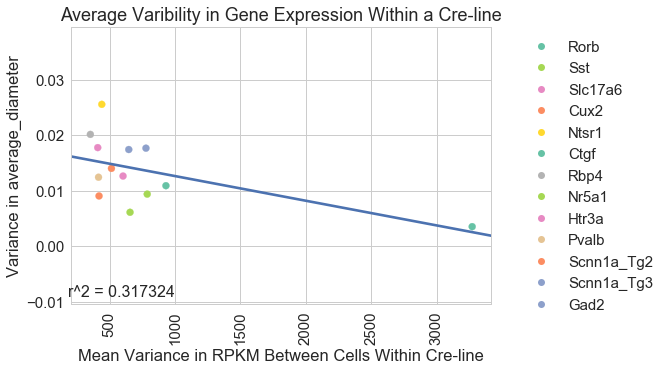

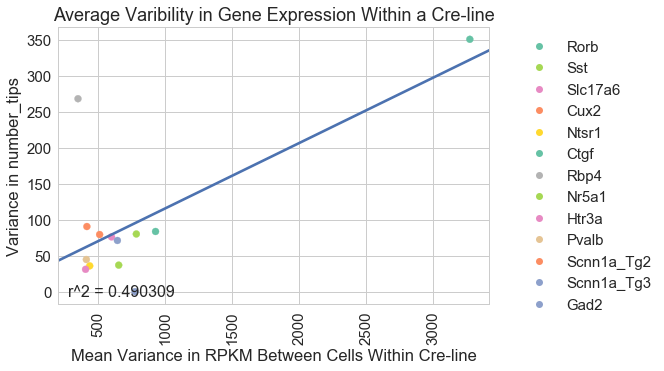

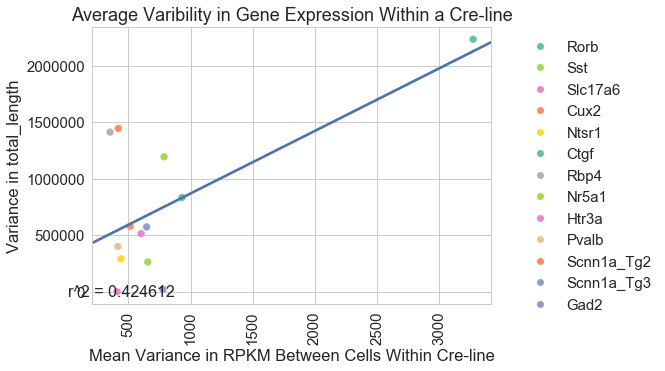

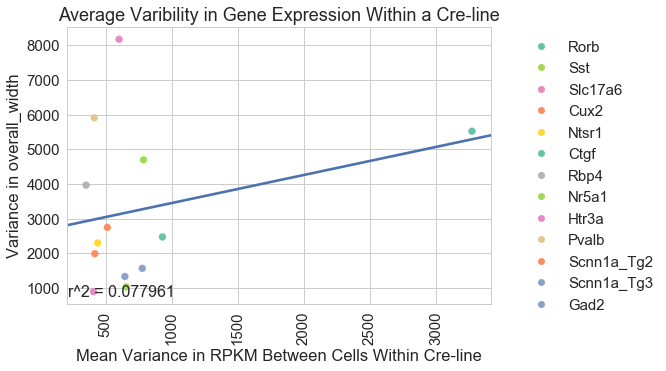

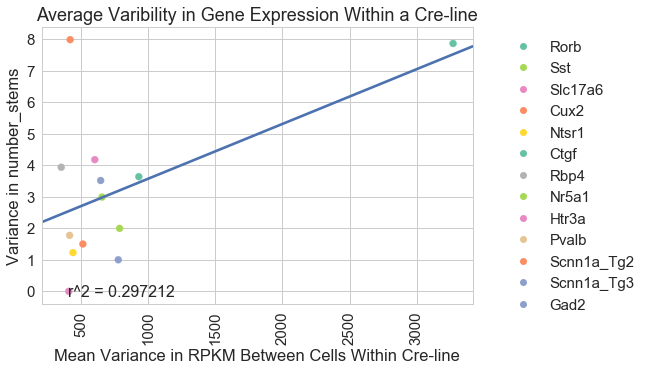

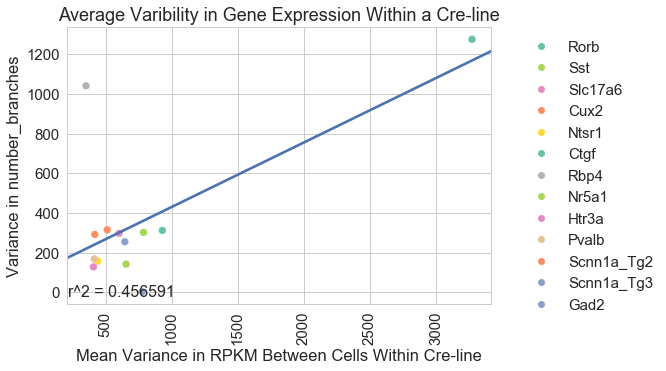

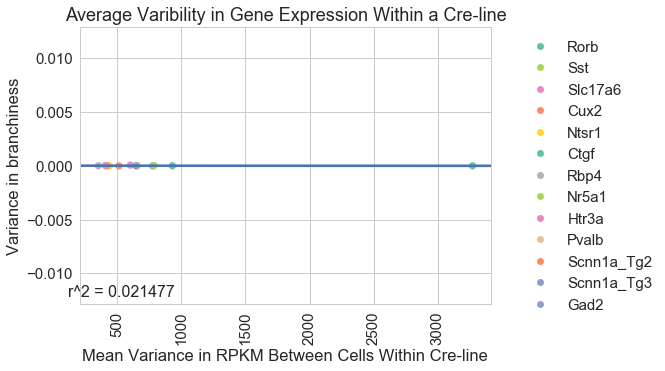

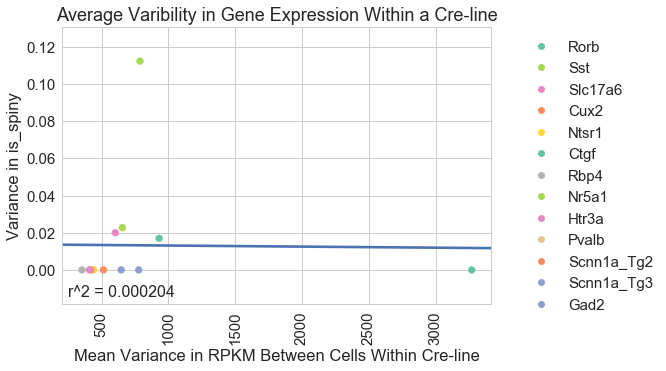

In [472]:
# 2017-08-31
# Scatterplot and r^2 for variance in morphology and varience in gene expression for all genes or
#selected GO terms analysis
#cell types split up by layer as well as cre line
#genes = list(data.index) #set default genes to all genes in the dataset
features = ['number_bifurcations', 'total_volume', 'average_diameter', 'number_tips', 'total_length',
            'overall_width', 'number_stems', 'number_branches', 'branchiness', 'is_spiny']
output_path = '/Volumes/Brain2017/project/ouput_varplots/'
title = 'by_layer_'
drive_path = drive_path
new_type_colors = ['#78C850',  # Grass
                    '#F08030',  # Fire
                    '#6890F0',  # Water
                    #'#A8B820',  # Bug
                    '#A8A878',  # Normal
                    '#A040A0',  # Poison
                    '#F8D030',  # Electric
                    #'#E0C068',  # Ground
                    '#EE99AC',  # Fairy
                    '#C03028',  # Fighting
                    '#F85888',  # Psychic
                    '#B8A038',  # Rock
                    '#705898',  # Ghost
                    '#98D8D8',  # Ice
                    '#7038F8',  # Dragon
                   ]
#data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class = load_data(drive_path)

for GO_term in genes_dict.keys():
    #print('Analyzing genes associated with: ' + GO_term)
    genes = genes_dict[GO_term]
    print('Got ' + str(len(genes)) + ' genes')
    #genes = list(data.index) #set default genes to all genes in the dataset
    #get morophology variance for each cre and layer:
    df_morph_variance = get_morphology_variance_by_cell(drive_path_cells, features, group_by_layer = False).T

    #get var in gene expression for all genes:
    data_var_mean,data_var, celltype_proportions_df, crelines_rnaseq = filter_rnaseq_data_variance(data, genes, name_to_dissection, name_to_class, group_by_layer = False)

    #combine variance for morphology and rnaseq into one datframe:
    data_var_mean = pd.DataFrame(data_var_mean)
    data_var_mean['tg_label_new'] = data_var_mean.index
    data_var_mean.rename(columns={0: 'mean_variance_RPKM'}, inplace=True)

    df_morph_variance2 = pd.DataFrame(df_morph_variance).T
    df_morph_variance2['tg_label_new'] = df_morph_variance2.index
    df_varmorph_exp = pd.merge(df_morph_variance2,data_var_mean,left_on='tg_label_new',right_on='tg_label_new',how='left')

    #convert to df:
    df_varmorph_exp2 = pd.DataFrame.from_records(df_varmorph_exp)

    sns.set(font_scale=1.5)
    sns.set_style("whitegrid")

    def r2(x, y):
        return stats.pearsonr(x, y)[0] ** 2
    
    for f in features:
        #calculate r^2
        line = r2(df_varmorph_exp2[f],df_varmorph_exp2['mean_variance_RPKM'])
        line2 = '{:f}'.format(line)
        text_add = str('r^2 = ') + str(line2)

        # Set figure size with matplotlib
        #fig, ax = plt.subplots(figsize=(20,20))
        #for x in range(len(features)-3): #-3 b/c three extra non-feature variables in list

        # Create plot
        # Unique category labels: 'D', 'F', 'G', ...
        color_labels = df_varmorph_exp2['tg_label_new'].unique()

        # List of RGB triplets
        rgb_values = sns.color_palette("Set2", len(color_labels))

        # Map label to RGB
        color_map = dict(zip(color_labels, rgb_values))
        color_map2 = [color for color in color_map.values()[:len(color_labels)]]

        # Finally use the mapped values

        g = plt.scatter(df_varmorph_exp2['mean_variance_RPKM'], df_varmorph_exp2[f], c=df_varmorph_exp2['tg_label_new'].map(color_map))


        #plt.legend(fontsize=8)

        #sns.lmplot(x=df_varmorph_exp2['mean_variance_RPKM'], y=df_varmorph_exp2[f], data=df_varmorph_exp2, fit_reg=False,hue='tg_label_new')
        sns.regplot(x=df_varmorph_exp2['mean_variance_RPKM'], y=df_varmorph_exp2[f], data=df_varmorph_exp2, scatter=False,ci=None)

        #ax=g.axes[0, 0]
        plt.text(.2,.2, str(text_add),verticalalignment='center', 
                 horizontalalignment='center',fontsize=16,transform=ax.transAxes)

        plt.xticks(rotation=90)

        # Set title with matplotlib

        plt.title('Average Varibility in Gene Expression Within a Cre-line')
        plt.ylabel('Variance in ' + str(f))
        plt.xlabel('Mean Variance in RPKM Between Cells Within Cre-line')

        # The following two lines generate custom fake lines that will be used as legend entries:
        markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in color_map.values()]
        plt.legend(markers, color_map.keys(), numpoints=1, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.5)

        #legend_.remove()
        #legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        #plt.subplots_adjust(bottom=0.10)
        #plt.subplots_adjust(right=0.25)
       # plt.subplots_adjust(left=0.0001)
        plt.savefig(output_path + str(GO_term) + str(f) + 'mean_variance_betweencellswithinCre.png',dpi=100,,bbox_inches="tight")
        plt.show()


In [57]:
#get pearson correlations for morphology and gene expression:

features = ['number_bifurcations', 'total_volume', 'average_diameter', 'number_tips', 'total_length',
            'overall_width', 'number_stems', 'number_branches', 'branchiness', 'is_spiny']
output_path = '/Volumes/Brain2017/project/ouput_varplots/'
title = 'by_layer_'
drive_path = drive_path

#data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class = load_data(drive_path)
master_dict_pearsonp = {}
master_dict_pearsonr2 = {}

for GO_term in genes_dict.keys():
    #print('Analyzing genes associated with: ' + GO_term)
    genes = genes_dict[GO_term]
    print('Got ' + str(len(genes)) + ' genes')
    #genes = list(data.index) #set default genes to all genes in the dataset
    #get morophology variance for each cre and layer:
    df_morph_variance = get_morphology_variance_by_cell(drive_path_cells, features, group_by_layer = False).T

    #get var in gene expression for all genes:
    data_var_mean,data_var, celltype_proportions_df, crelines_rnaseq = filter_rnaseq_data_variance(data, genes, name_to_dissection, name_to_class, group_by_layer = False)

    #combine variance for morphology and rnaseq into one datframe:
    data_var_mean = pd.DataFrame(data_var_mean)
    data_var_mean['tg_label_new'] = data_var_mean.index
    data_var_mean.rename(columns={0: 'mean_variance_RPKM'}, inplace=True)

    df_morph_variance2 = pd.DataFrame(df_morph_variance).T
    df_morph_variance2['tg_label_new'] = df_morph_variance2.index
    df_varmorph_exp = pd.merge(df_morph_variance2,data_var_mean,left_on='tg_label_new',right_on='tg_label_new',how='left')

    #convert to df:
    df_varmorph_exp2 = pd.DataFrame.from_records(df_varmorph_exp)

    def r2(x, y):
        r2 = stats.pearsonr(x, y)[0] ** 2
        p = stats.pearsonr(x, y)[1]
        return r2,p
    
    corrl_dictr2 = {} 
    corrl_dictp = {}
    for f in features:
        #calculate r^2 and p value
        out = r2(df_varmorph_exp2[f],df_varmorph_exp2['mean_variance_RPKM'])

        corrl_dictr2[f]= out[0]
        corrl_dictp[f] = out[1]
        
    master_dict_pearsonp[GO_term] =  corrl_dictp
    master_dict_pearsonr2[GO_term] =  corrl_dictr2
    


Got 267 genes
Got 59 genes
Got 96 genes
Got 90 genes
Got 2 genes
Got 3 genes
Got 9 genes
Got 154 genes
Got 3 genes
Got 4 genes
Got 1786 genes
Got 4 genes
Got 8 genes


Get correlation dataframes and save to excel:

In [73]:
#correlations: r^2, p, q:
pearsonr2 = pd.DataFrame(master_dict_pearsonr2)
pearsonp = pd.DataFrame(master_dict_pearsonp)
p_arr = np.array(pearsonp)
p_list = np.reshape(p_arr, (-1))
_, q_list = fdrcorrection0(p_list, alpha = 0.05)
q_arr = np.reshape(q_list, p_arr.shape)
q_df = pd.DataFrame(q_arr, index = pearsonp.index, columns = pearsonp.columns)


pearsonp.to_excel('Variance_RPKM_Morphology_uncorrectedpvalues.xlsx')
pearsonr2.to_excel('Variance_RPKM_Morphology_r2.xlsx')
q_df.to_excel('Variance_RPKM_Morphology_BHFDRvalues.xlsx')

Got 267 genes


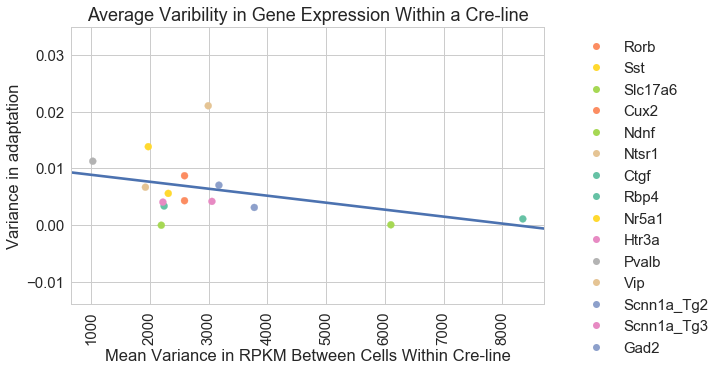

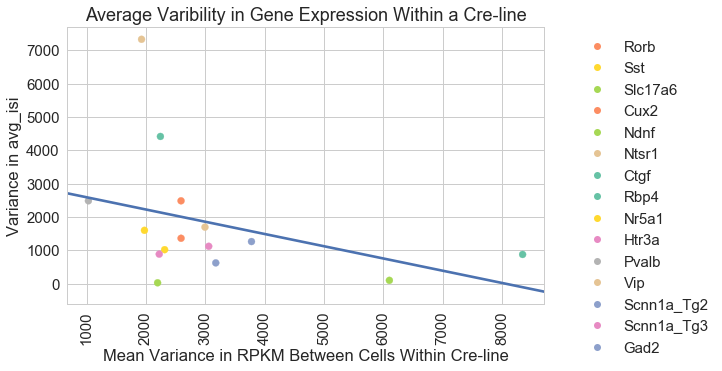

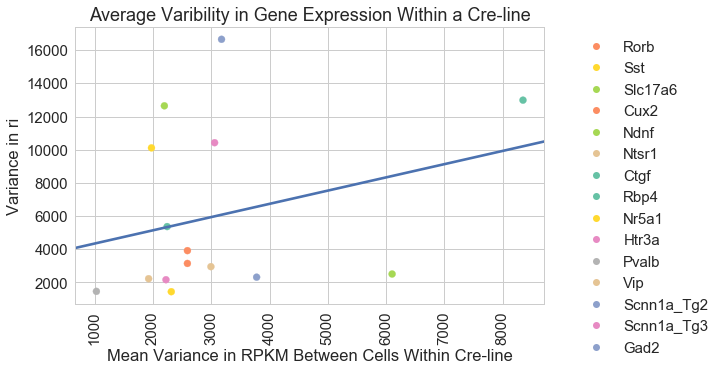

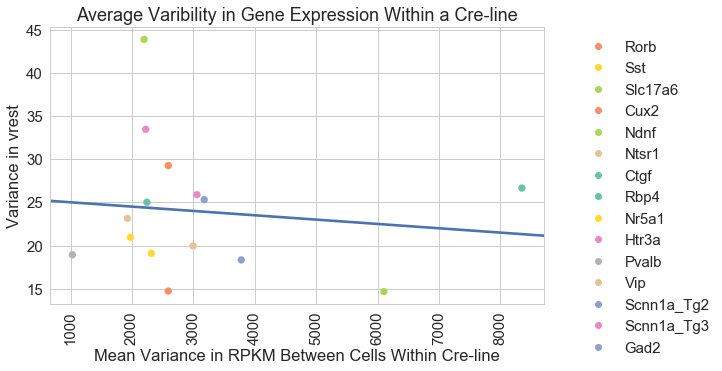

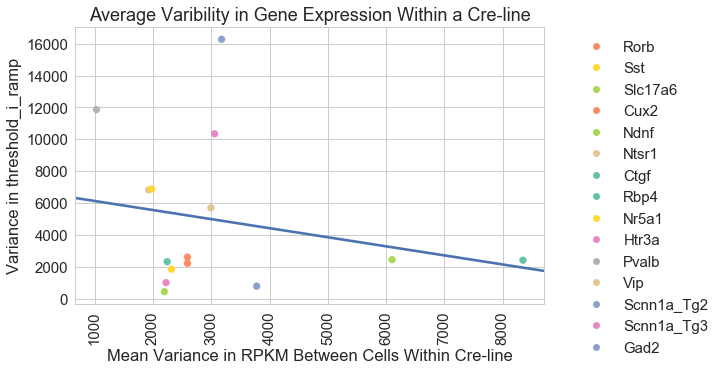

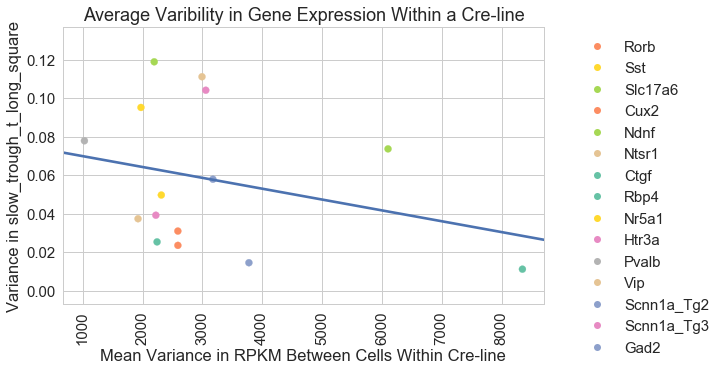

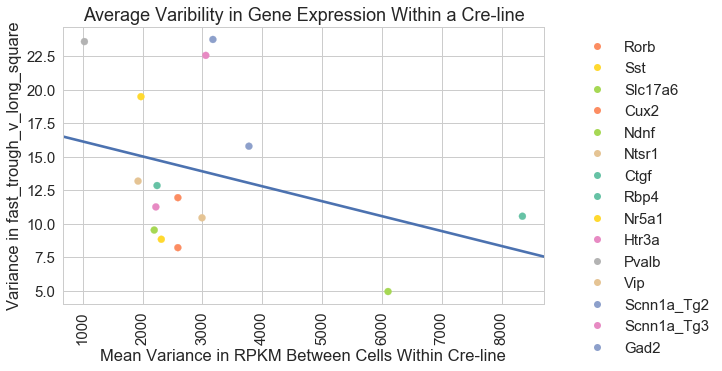

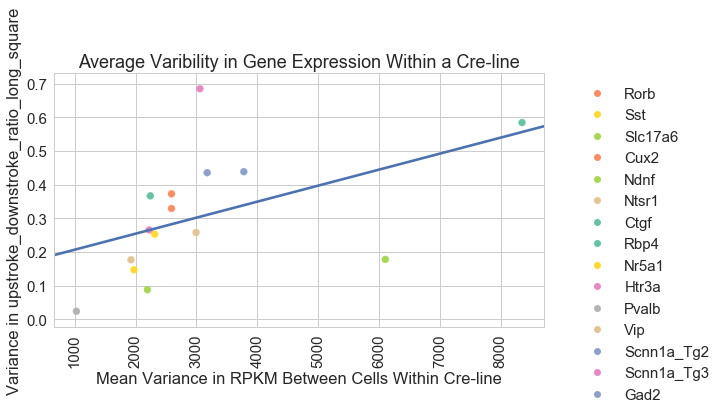

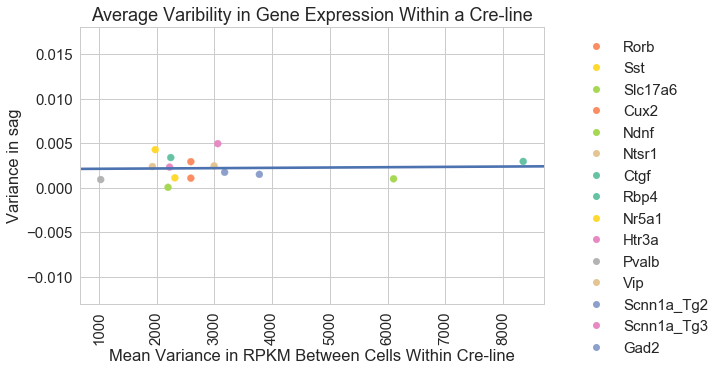

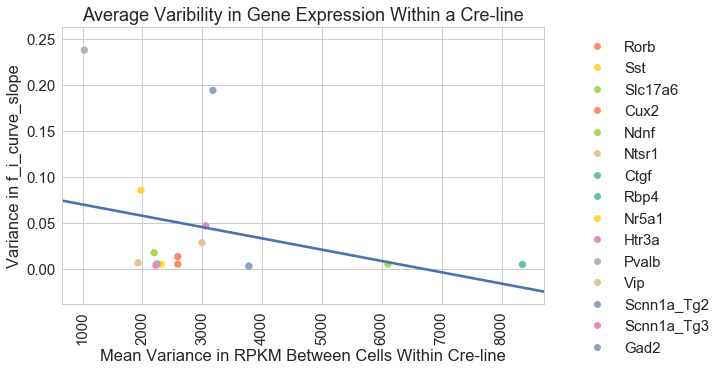

Got 59 genes


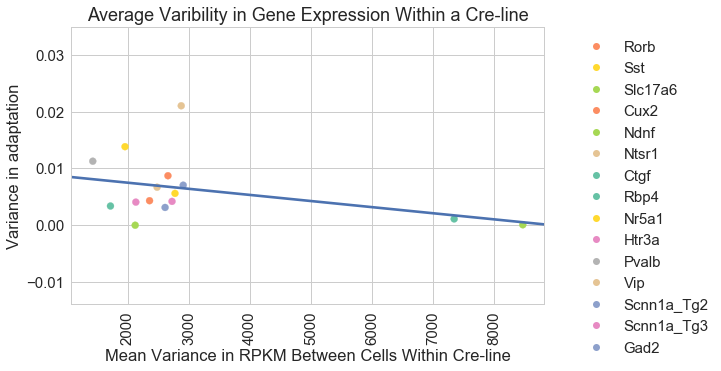

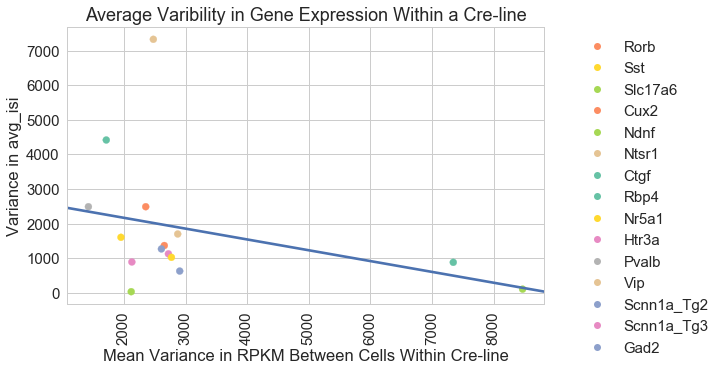

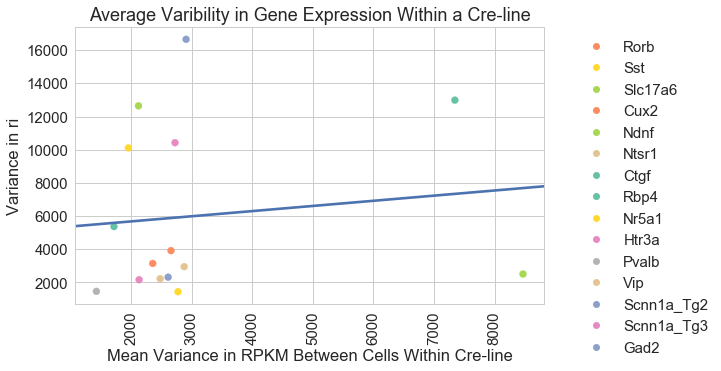

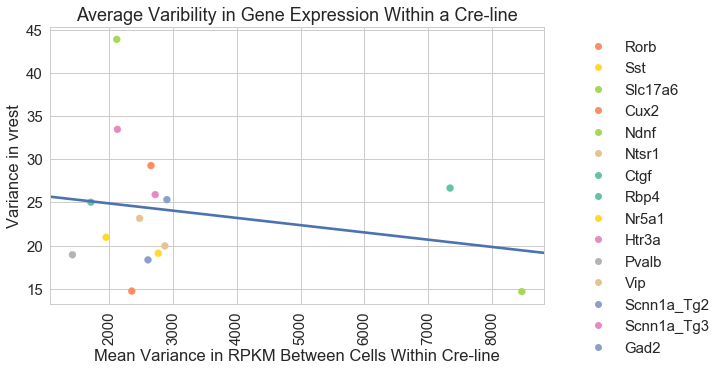

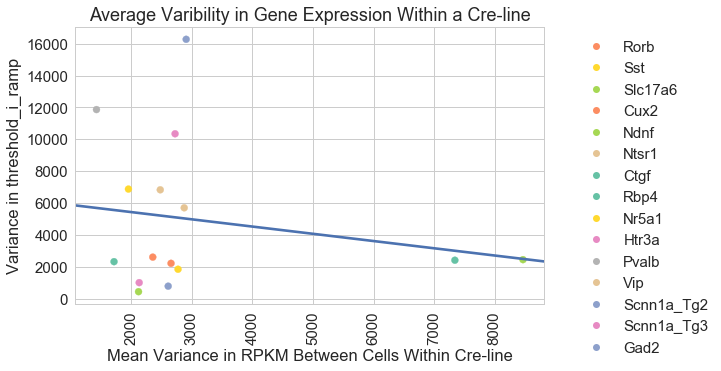

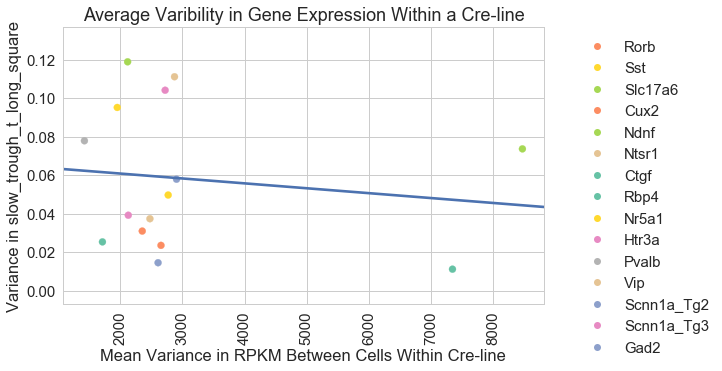

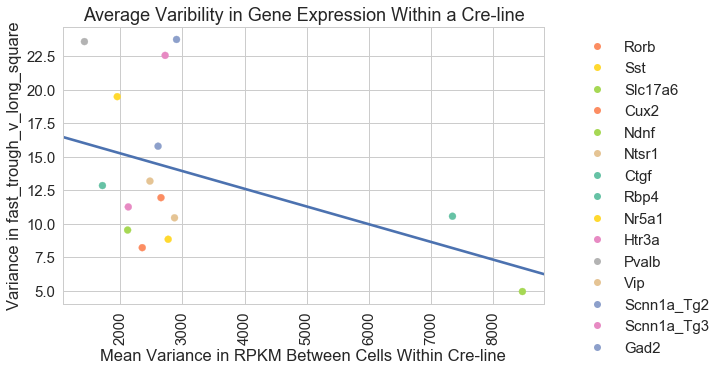

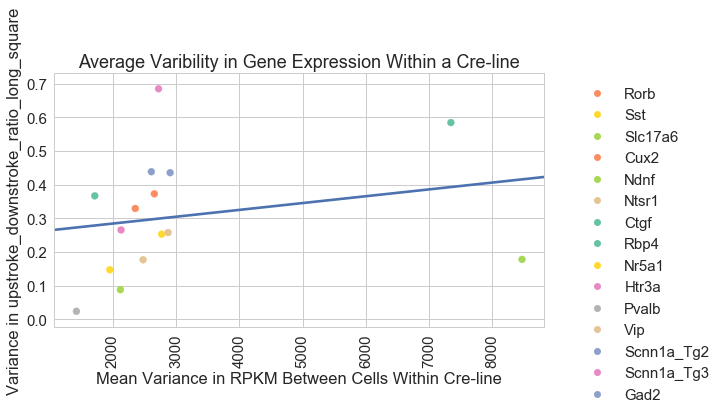

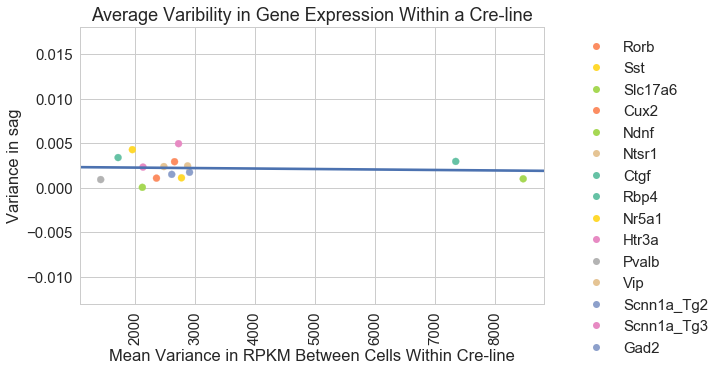

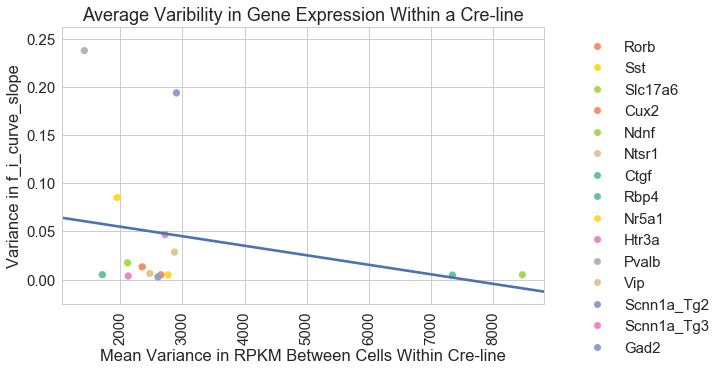

Got 96 genes


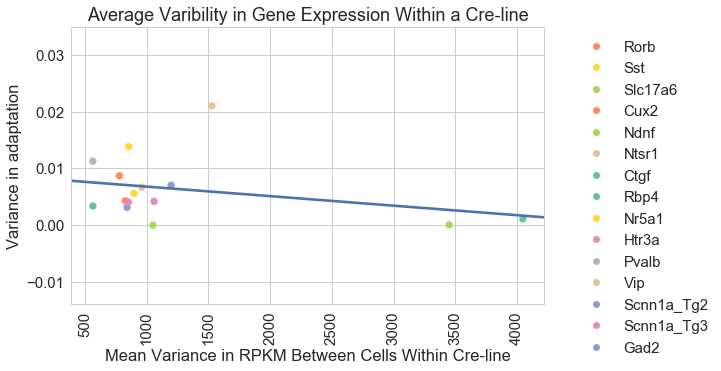

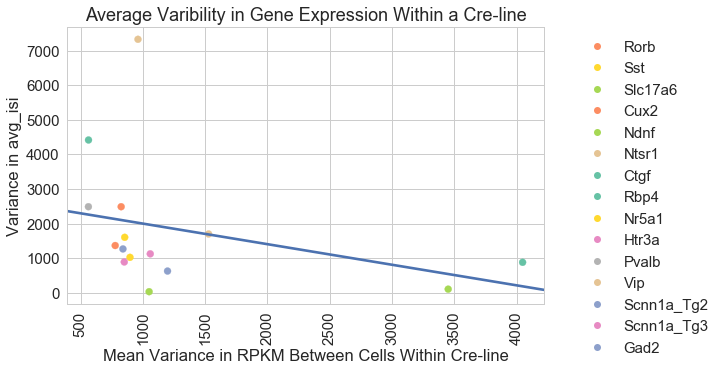

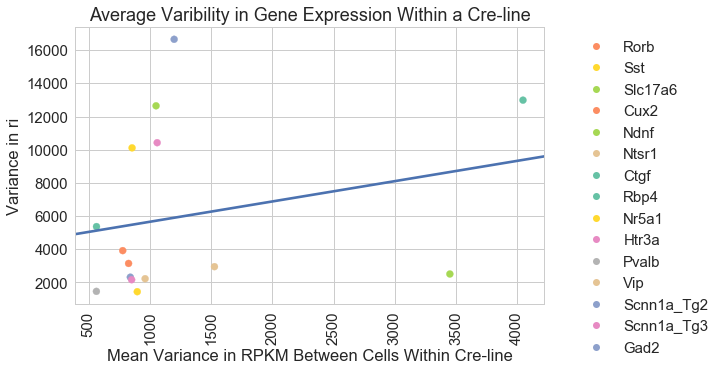

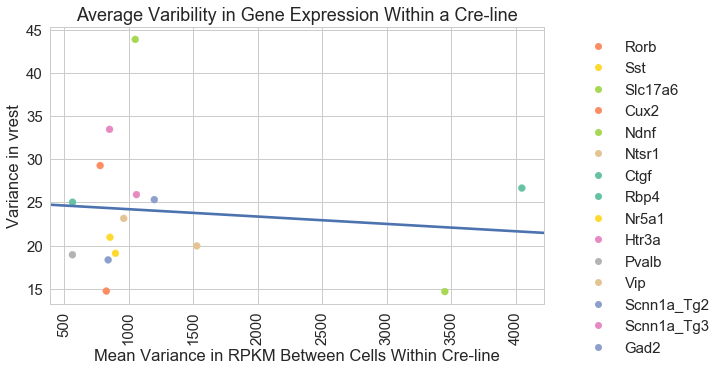

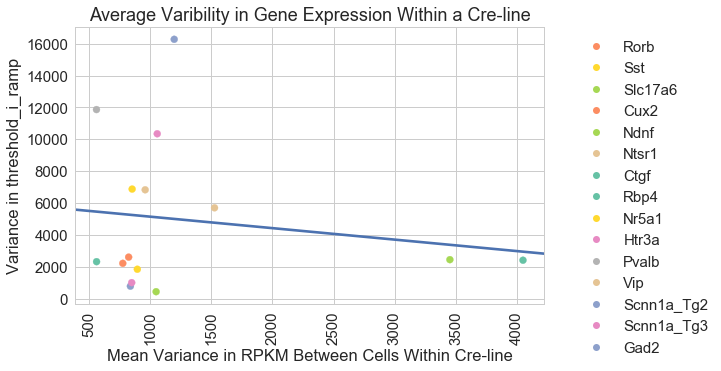

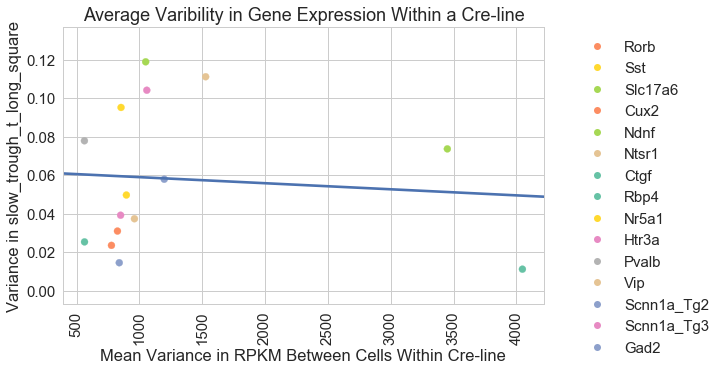

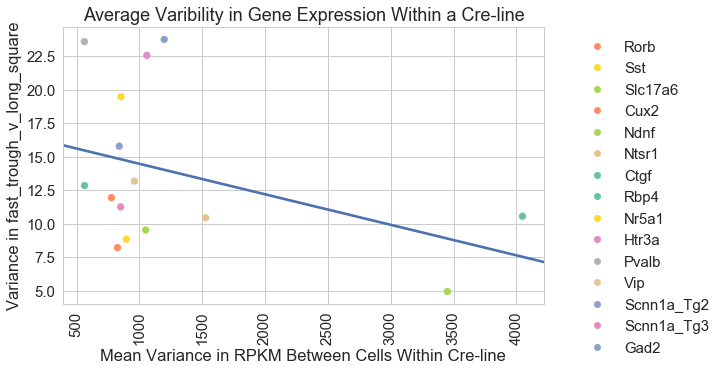

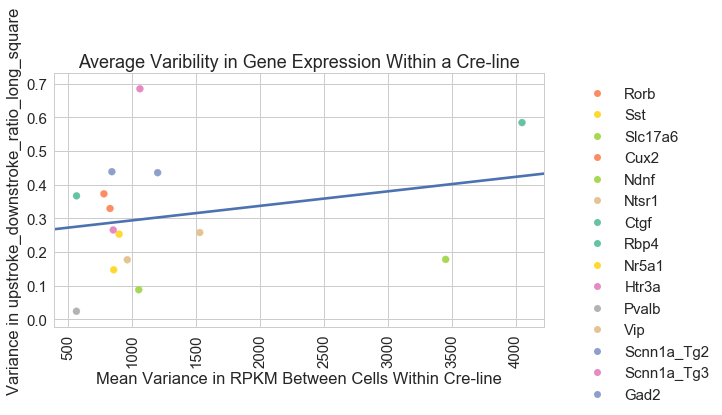

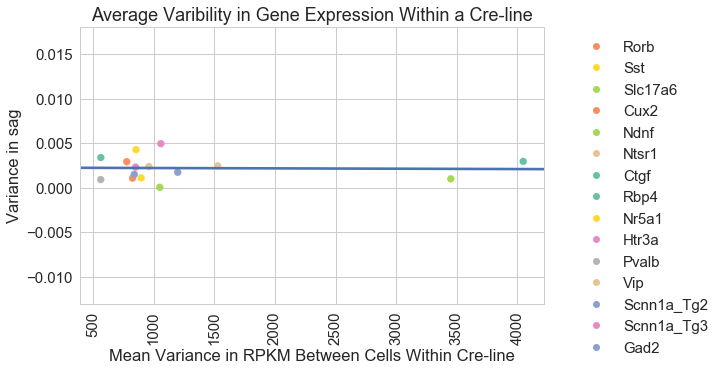

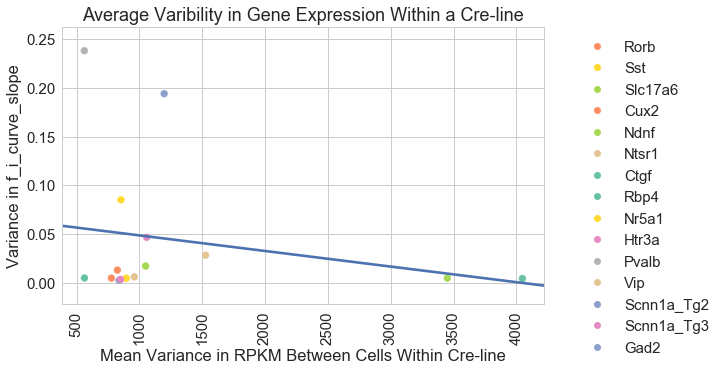

Got 90 genes


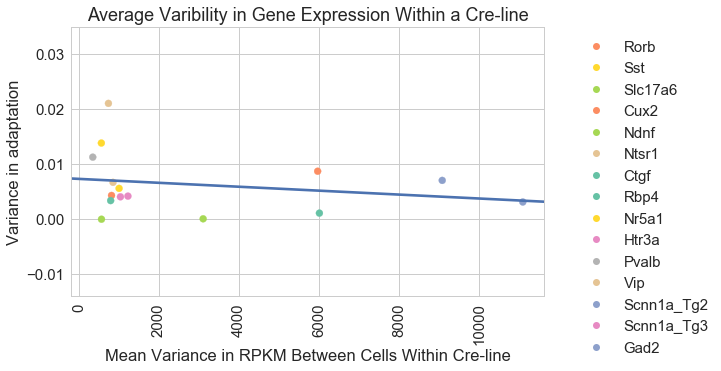

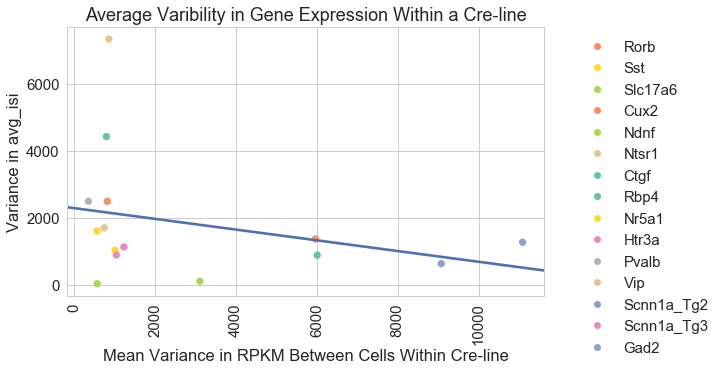

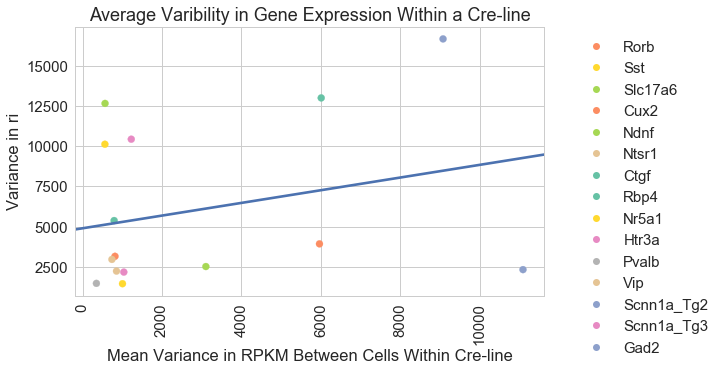

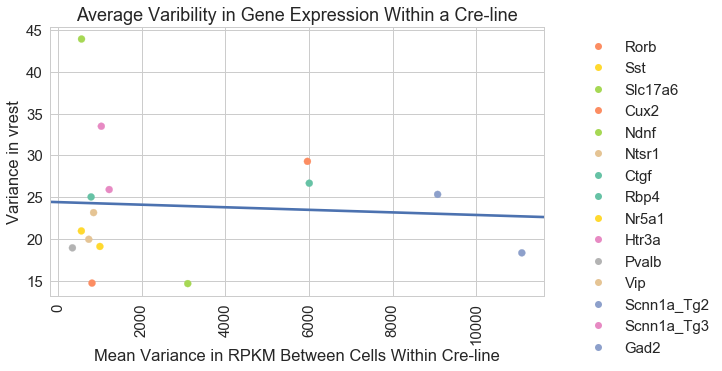

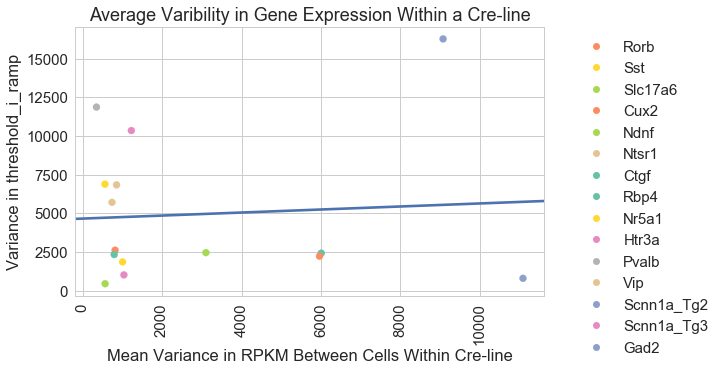

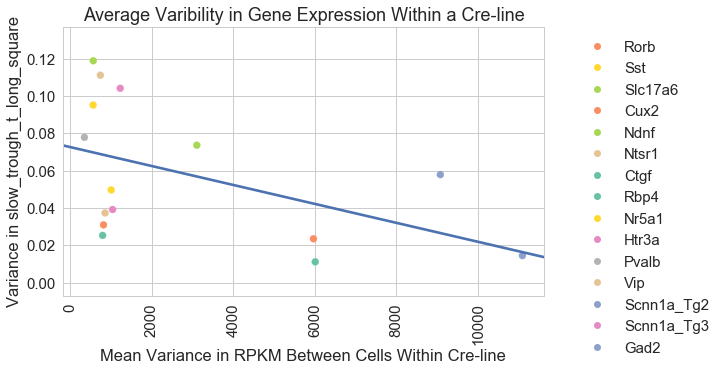

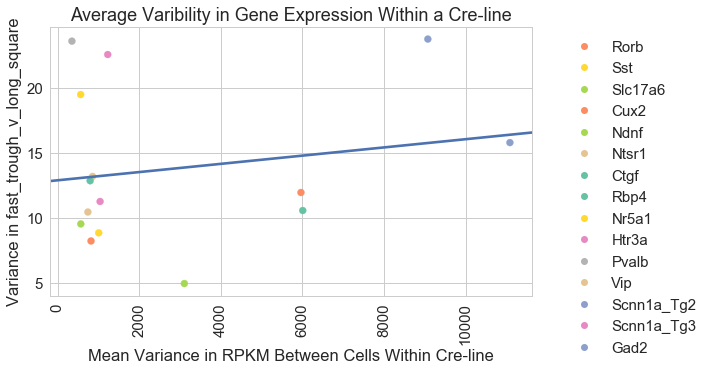

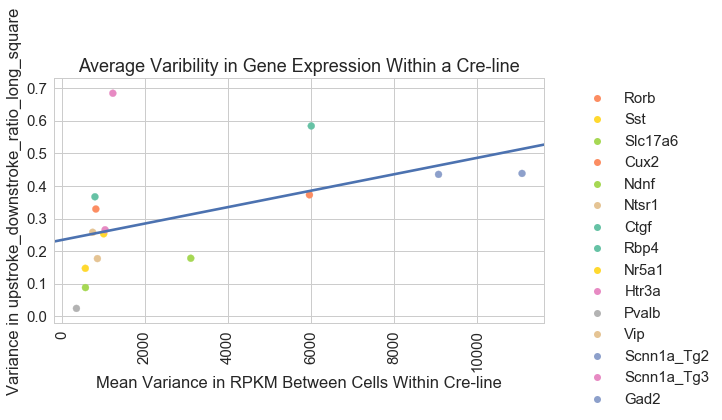

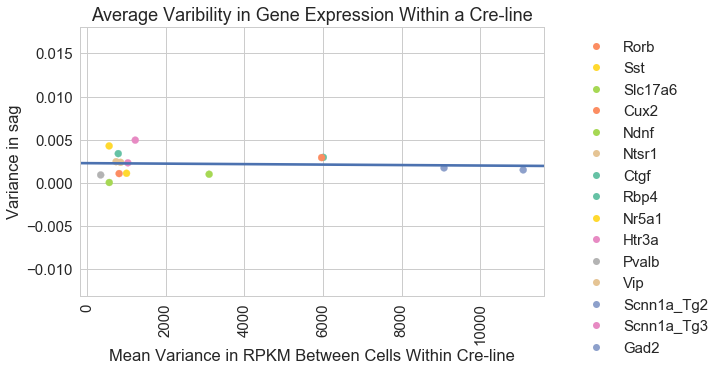

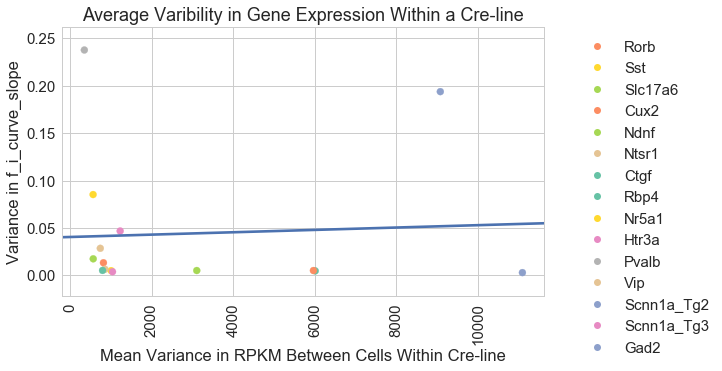

Got 2 genes


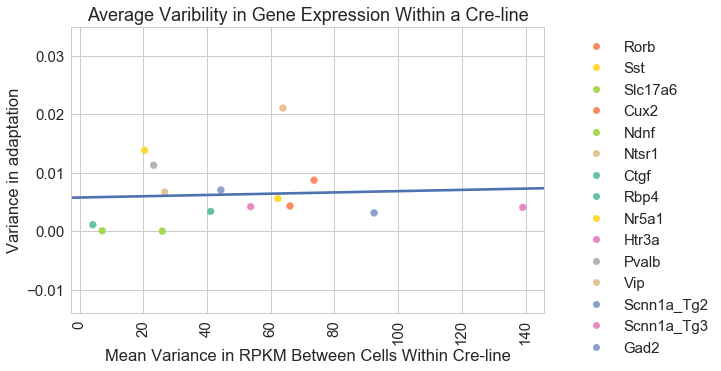

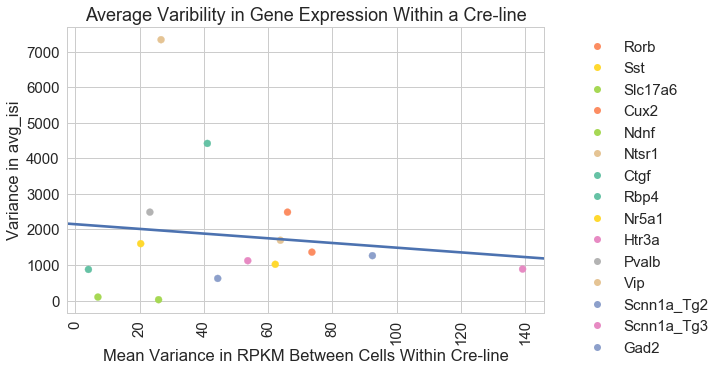

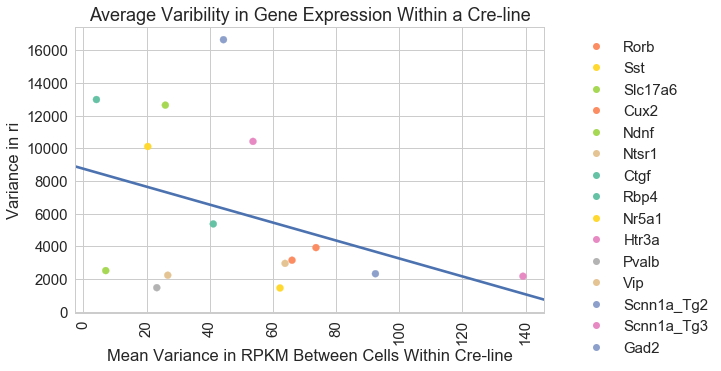

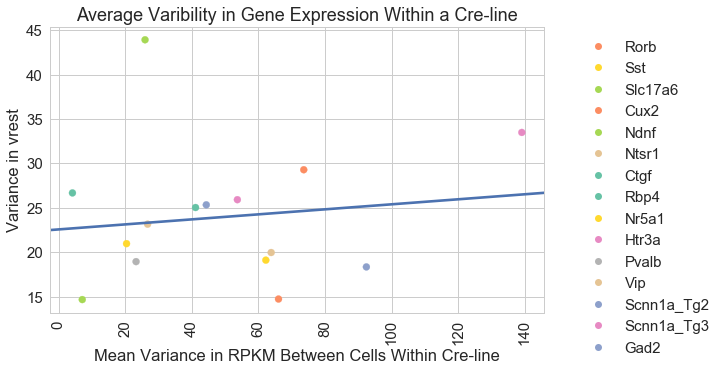

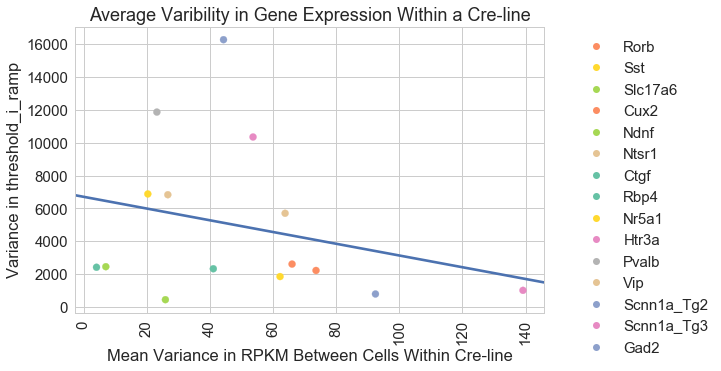

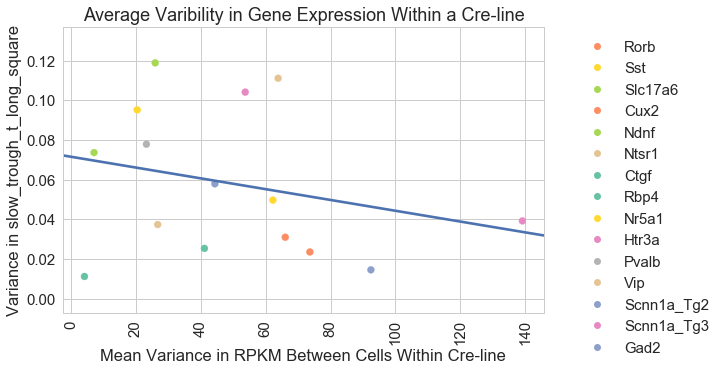

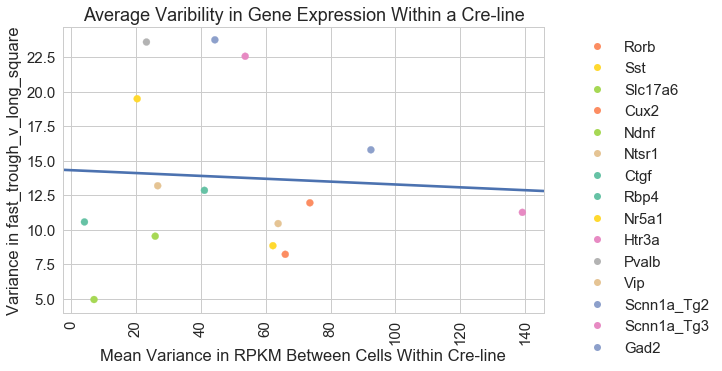

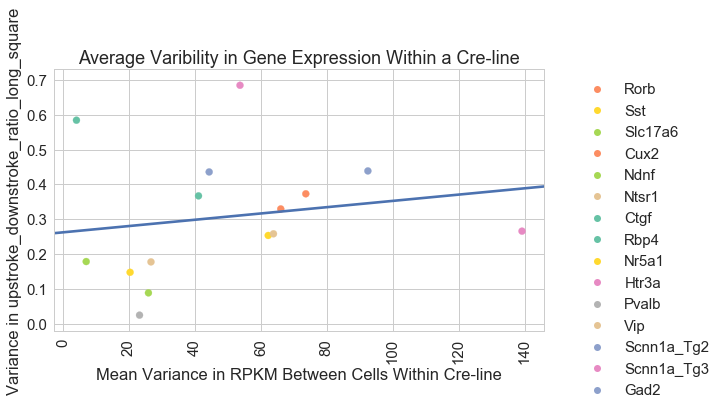

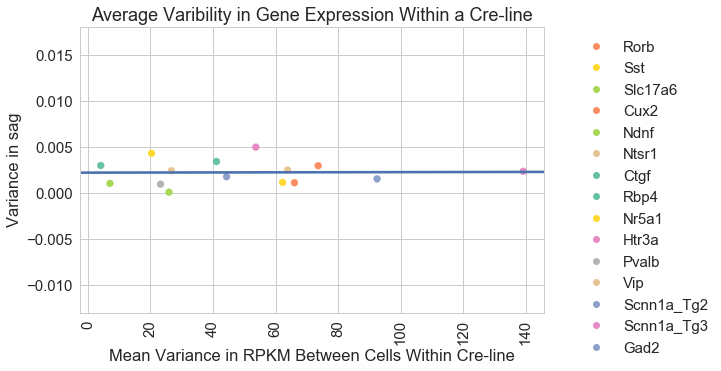

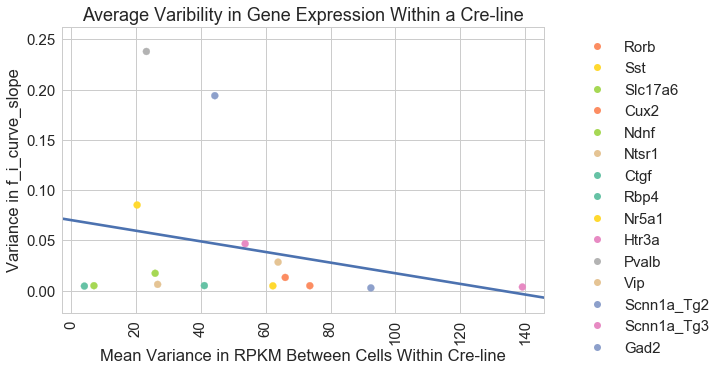

Got 3 genes


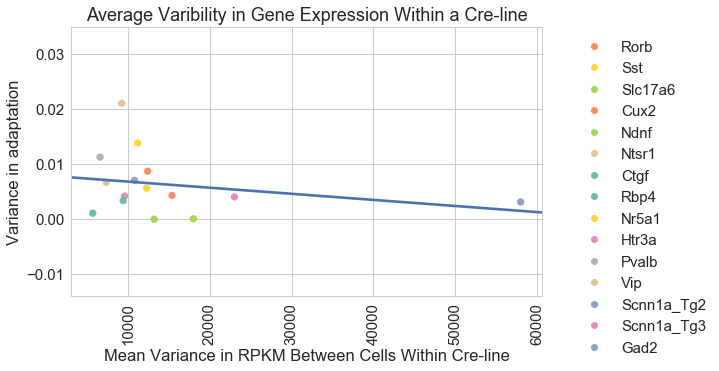

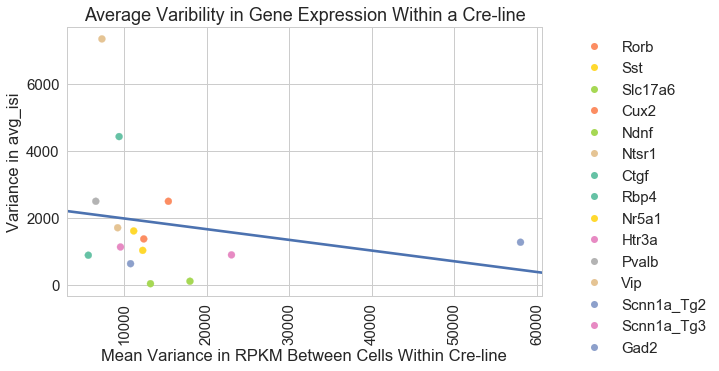

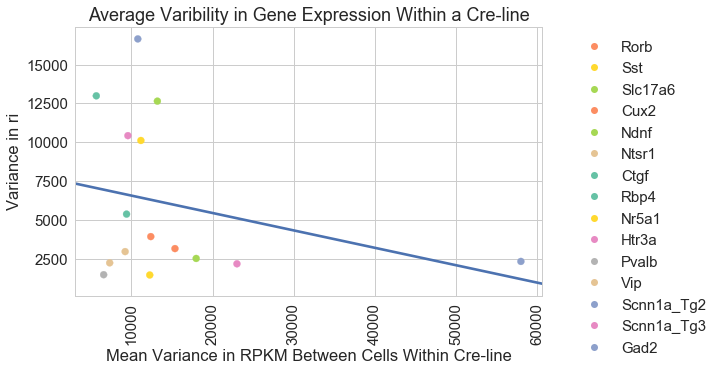

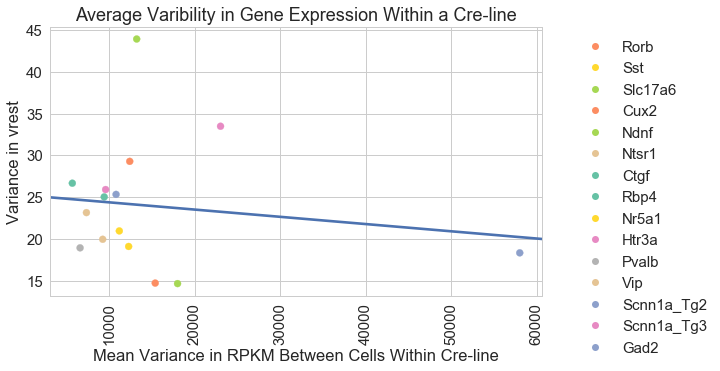

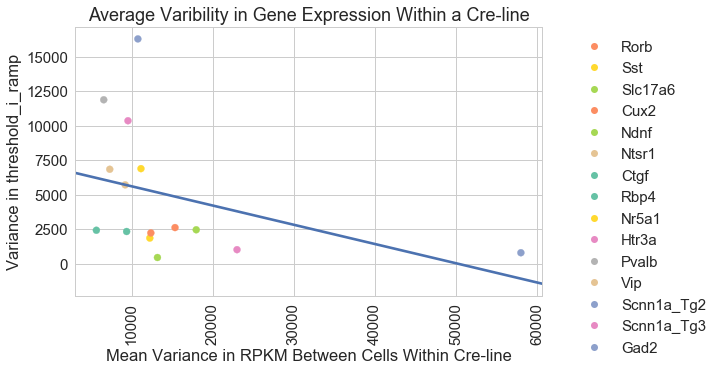

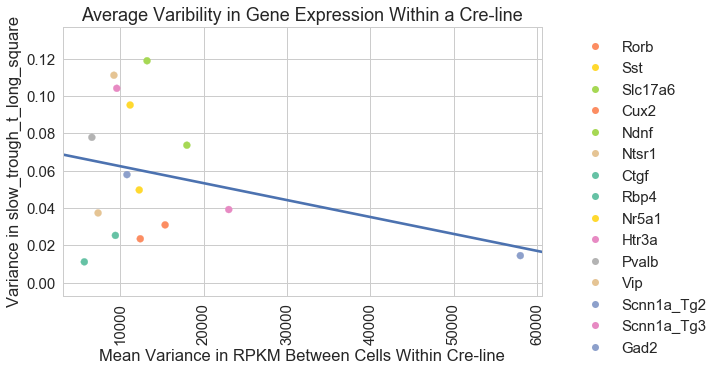

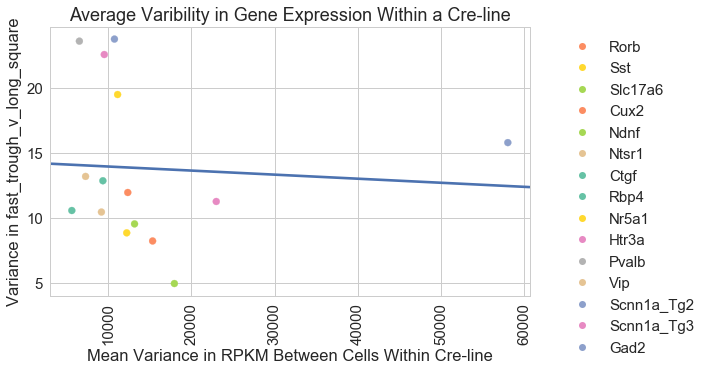

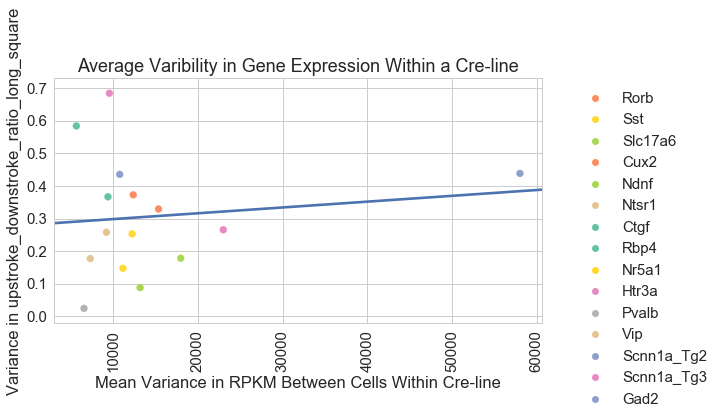

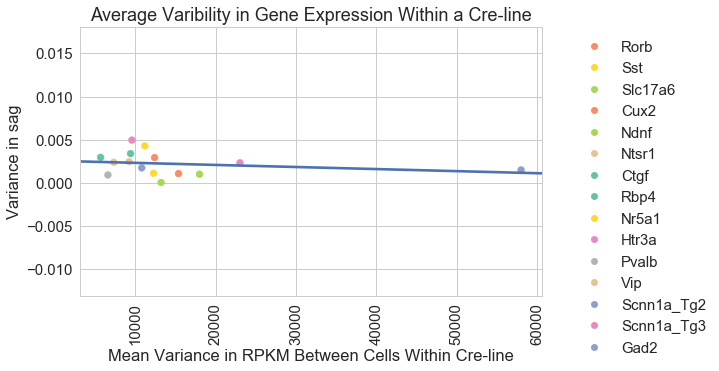

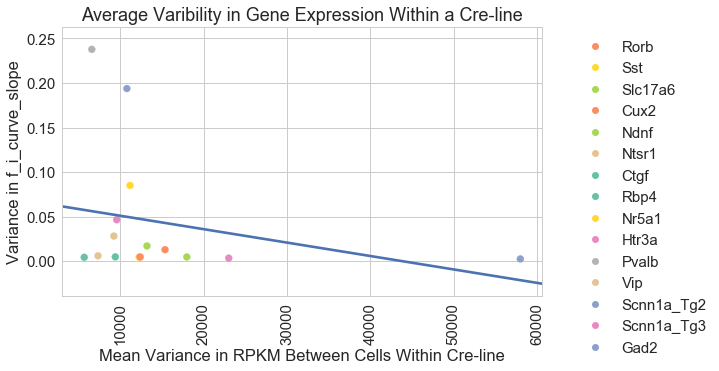

Got 9 genes


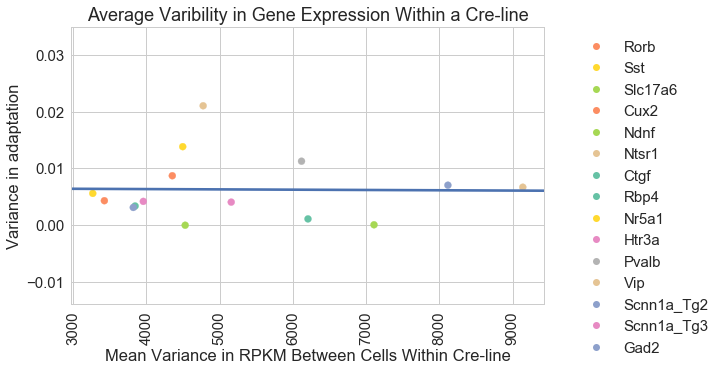

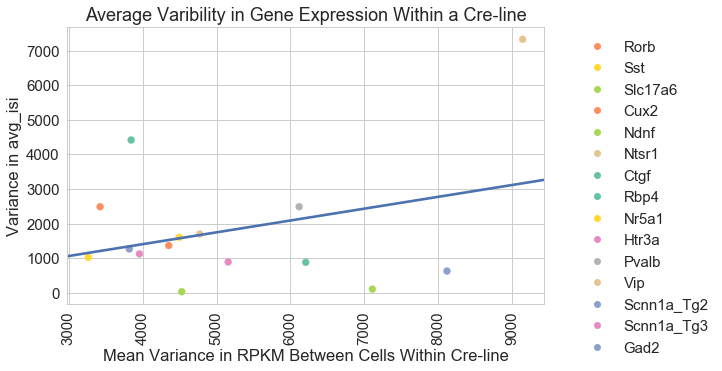

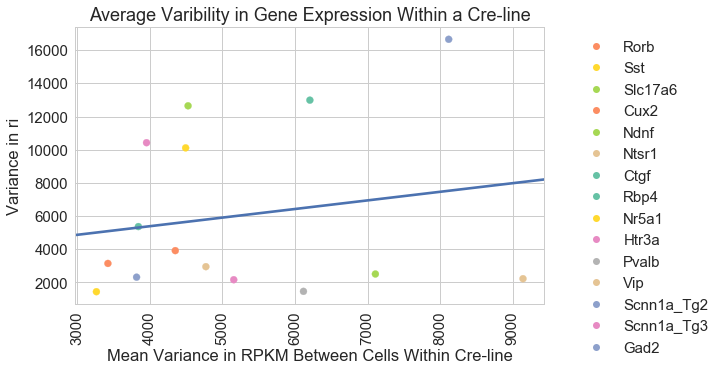

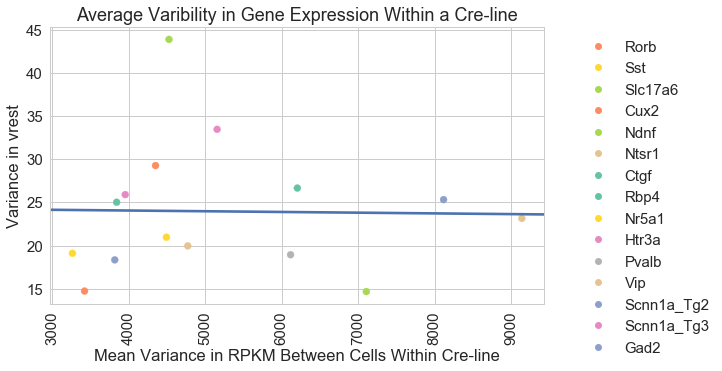

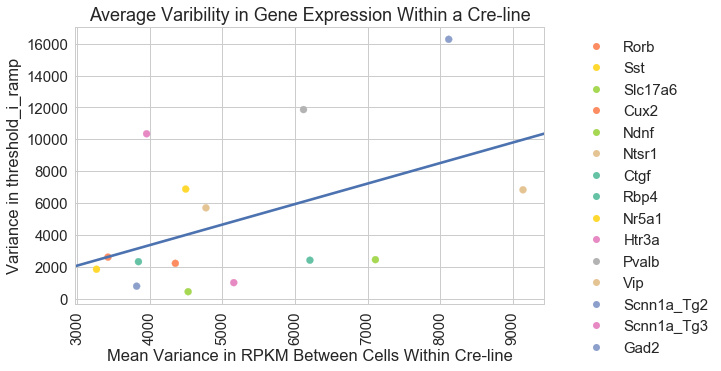

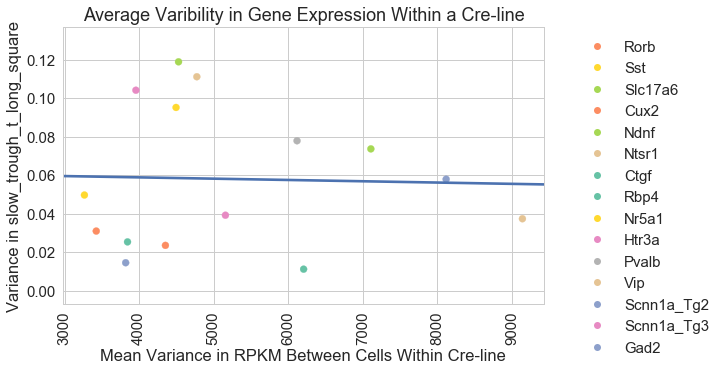

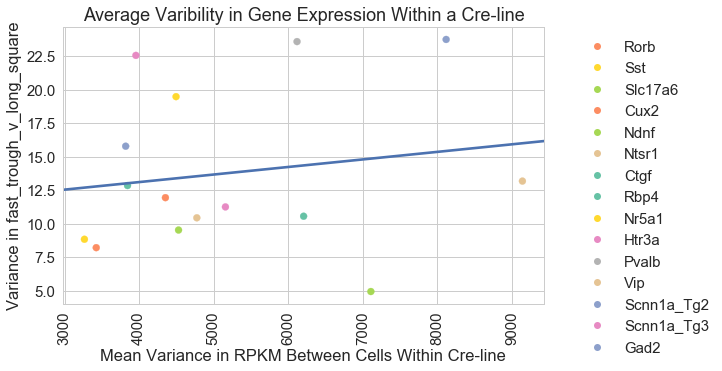

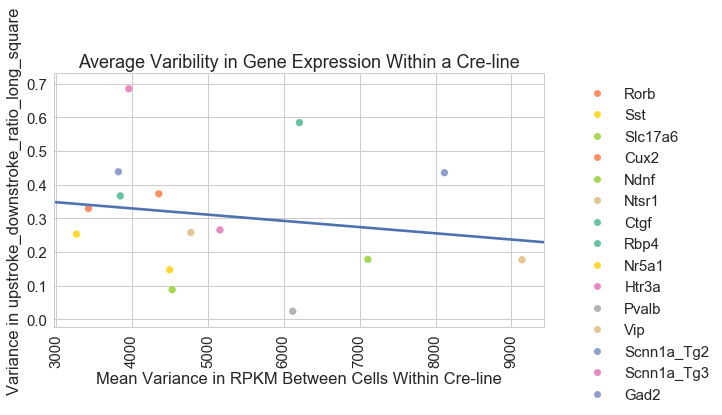

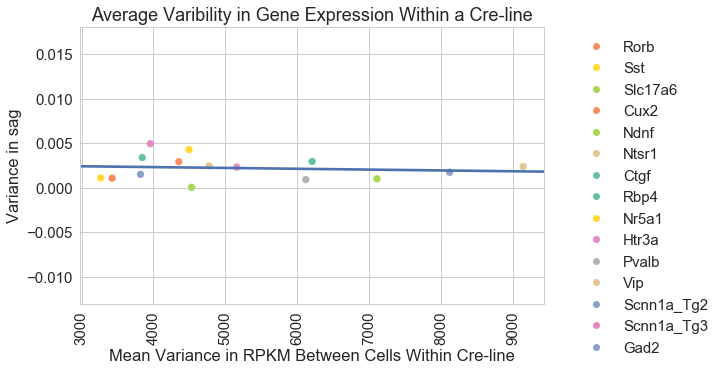

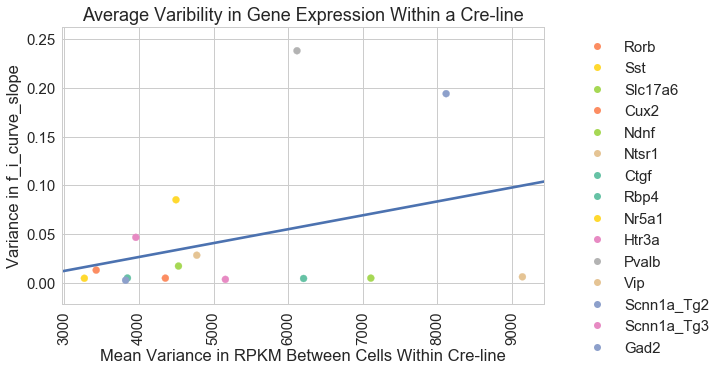

Got 154 genes


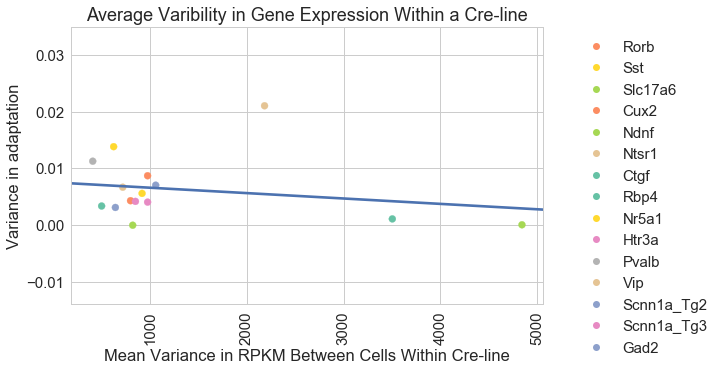

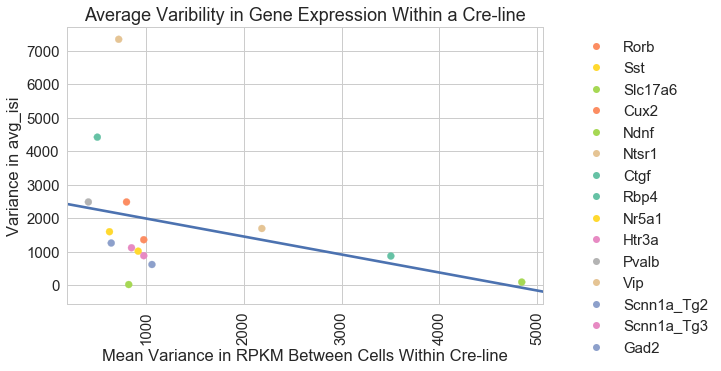

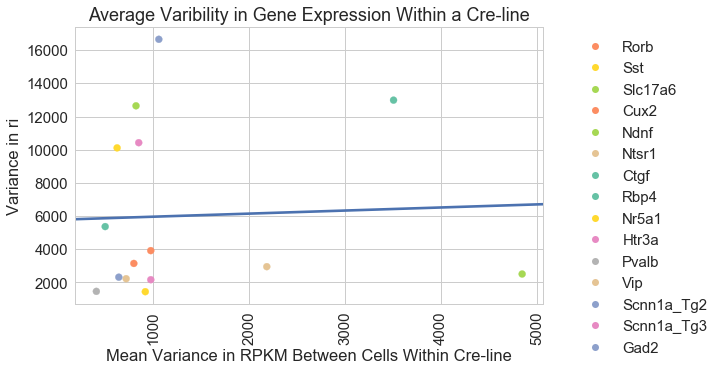

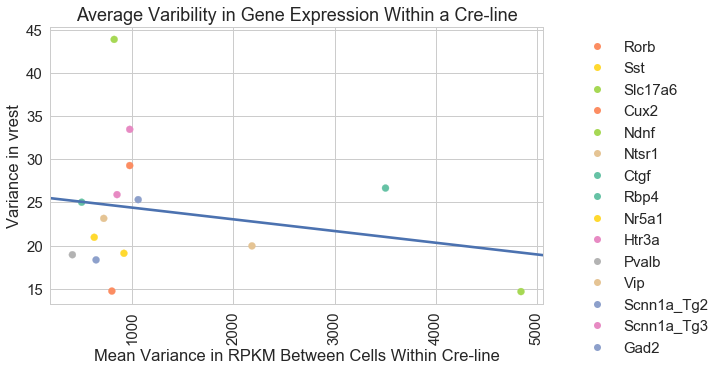

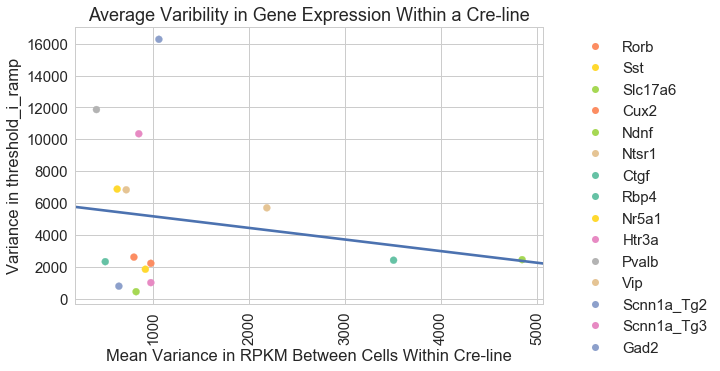

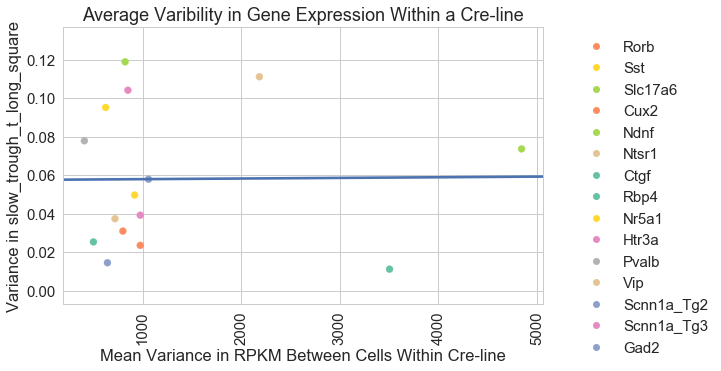

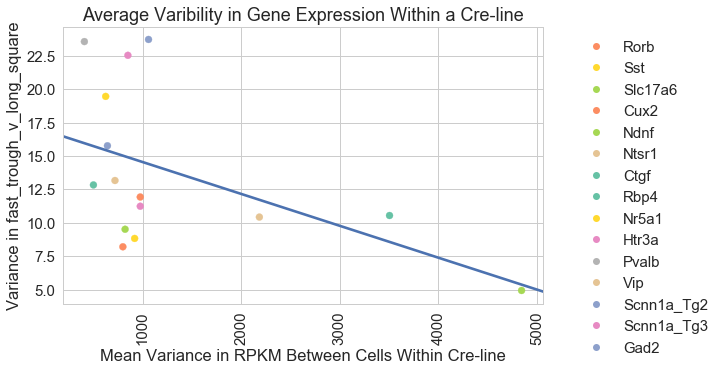

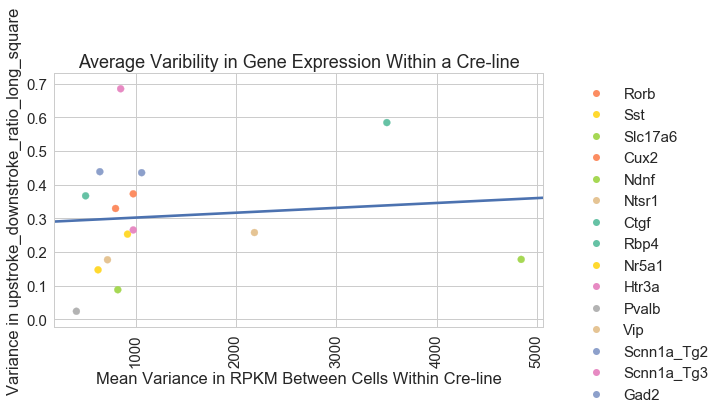

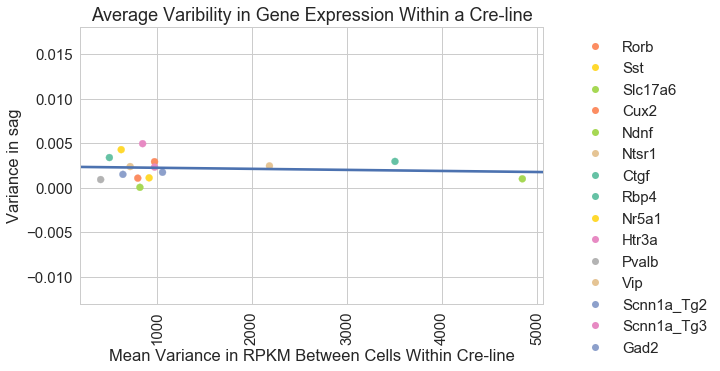

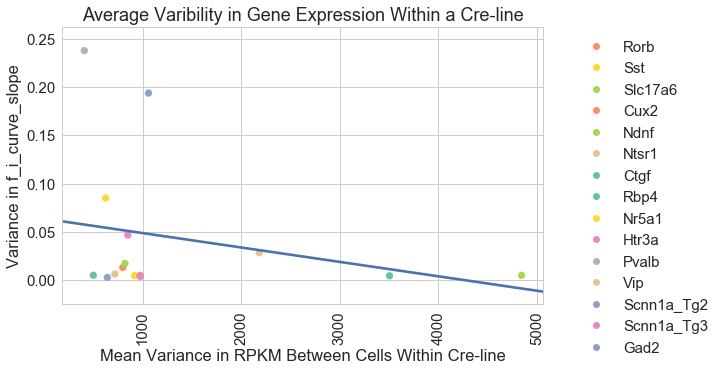

Got 3 genes


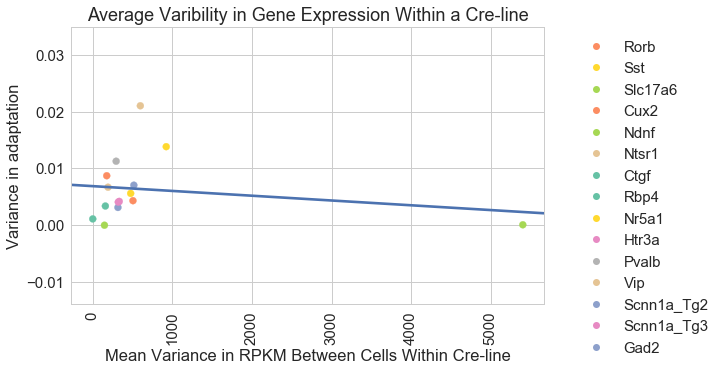

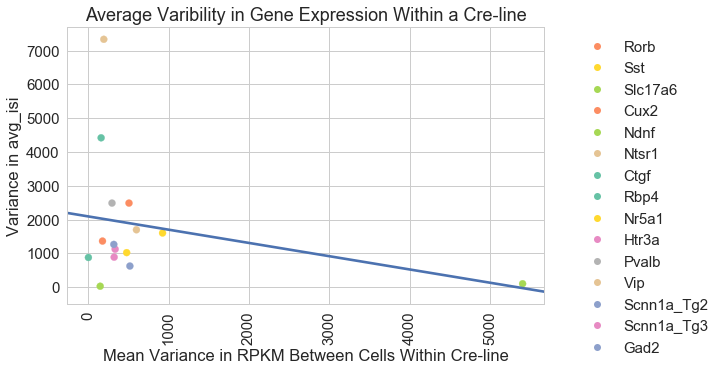

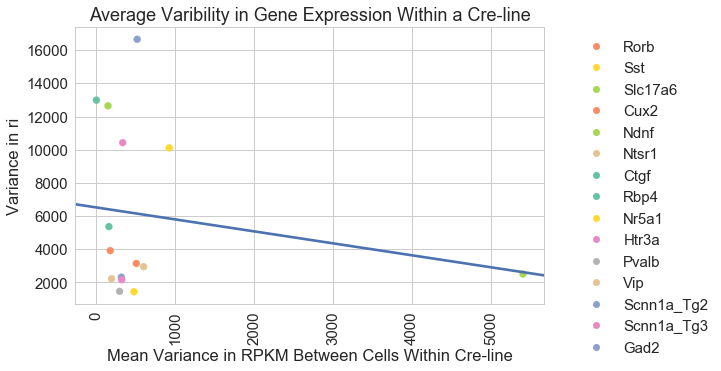

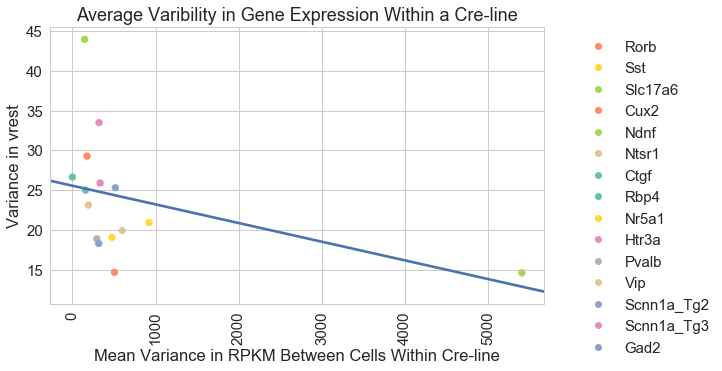

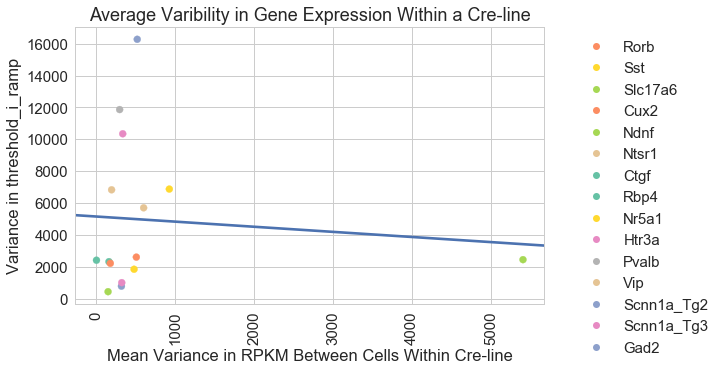

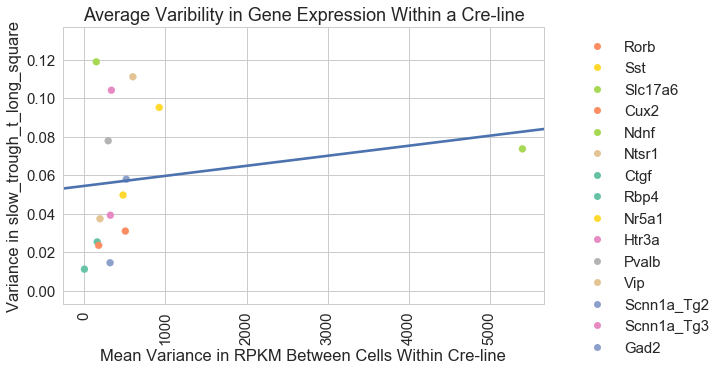

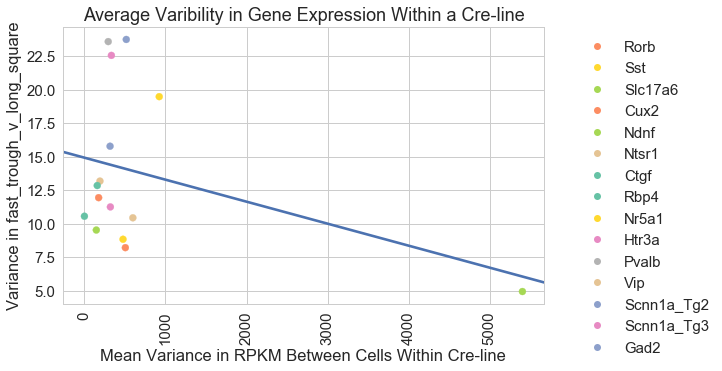

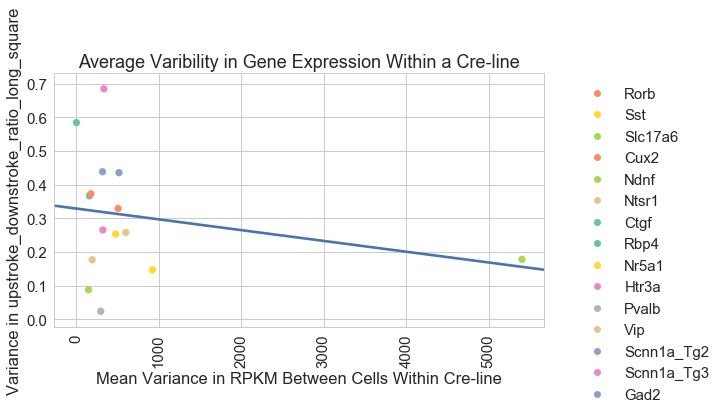

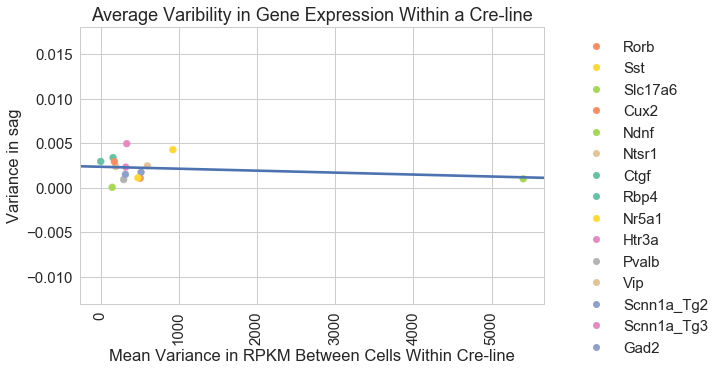

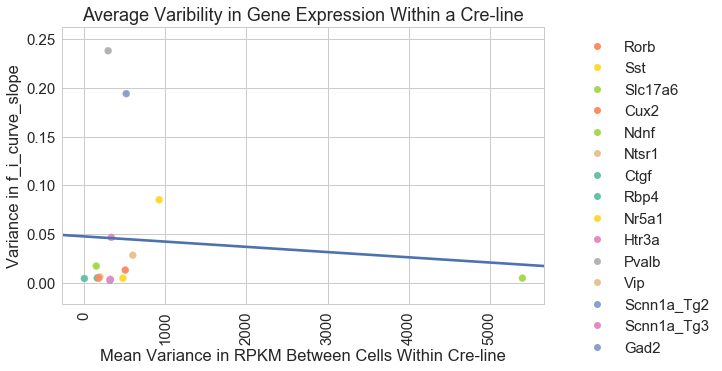

Got 4 genes


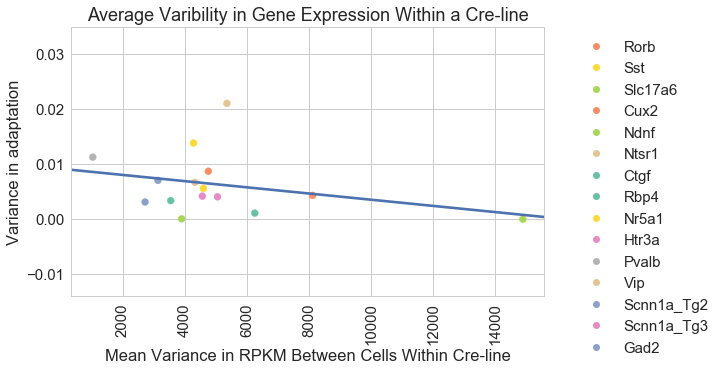

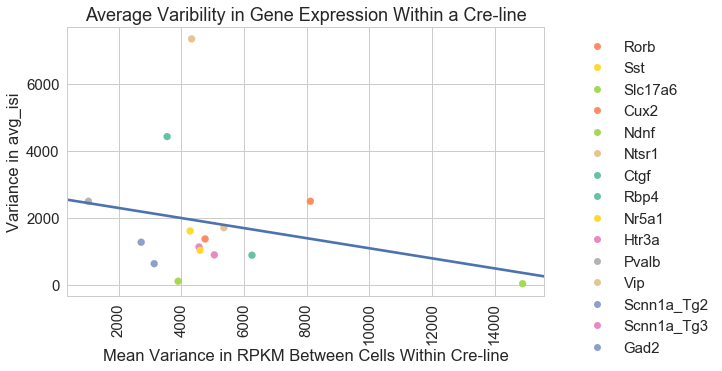

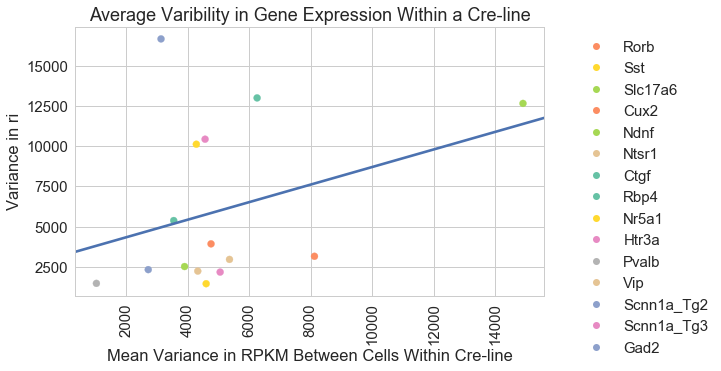

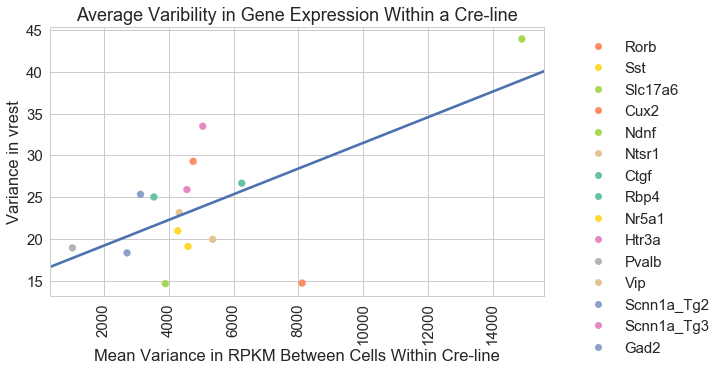

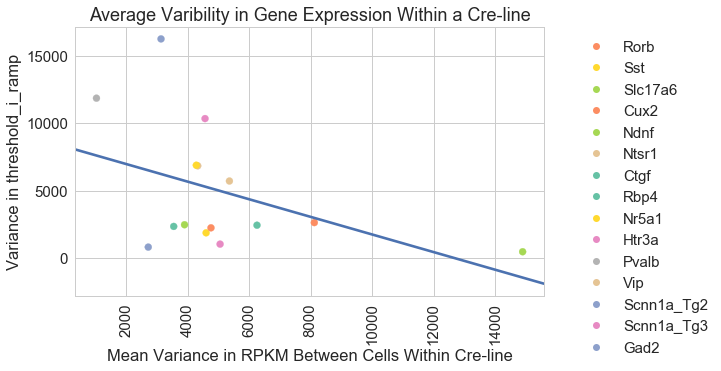

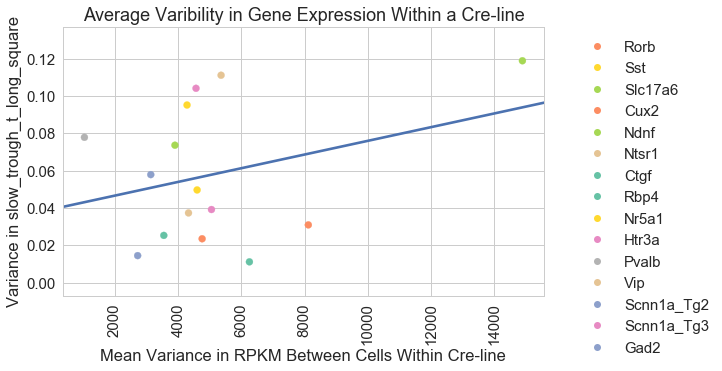

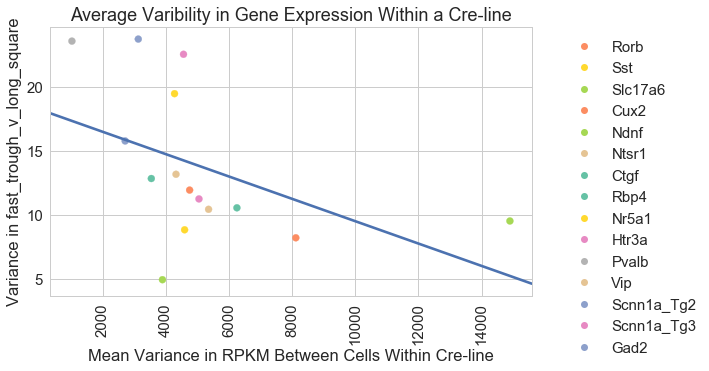

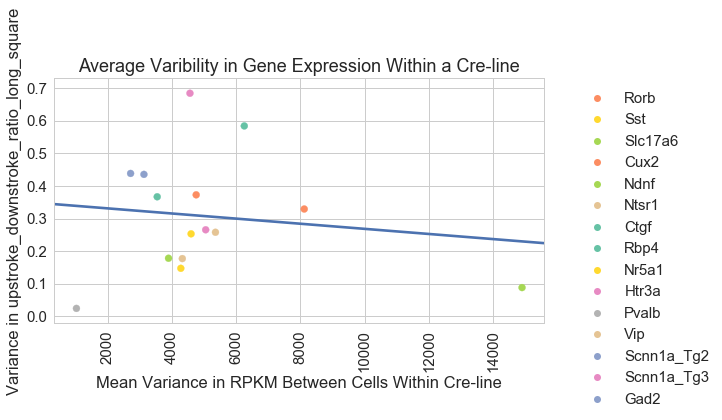

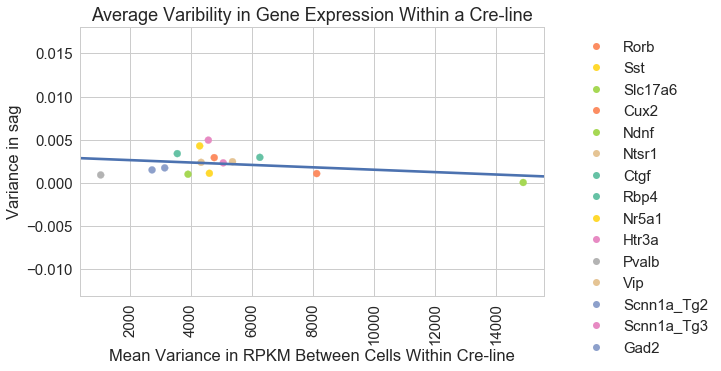

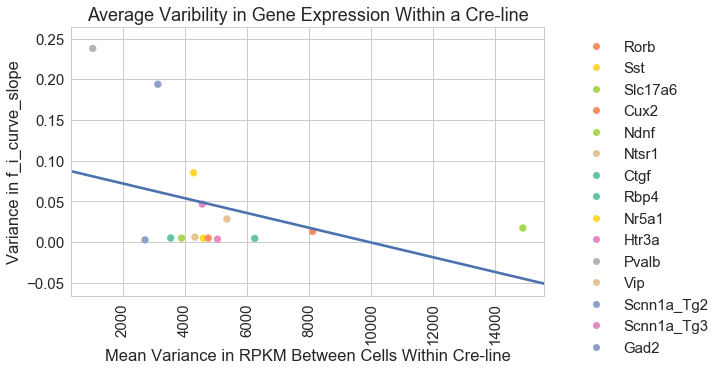

Got 1786 genes


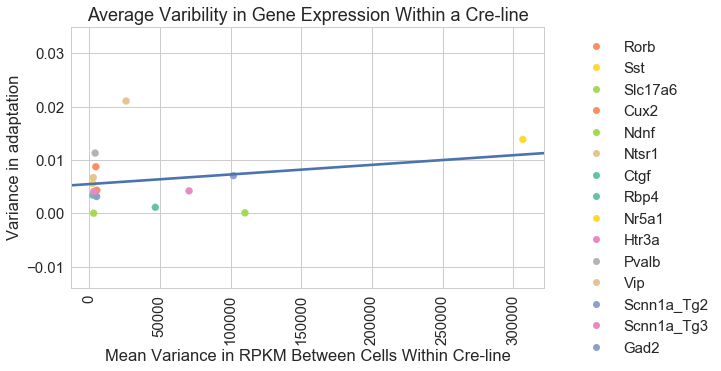

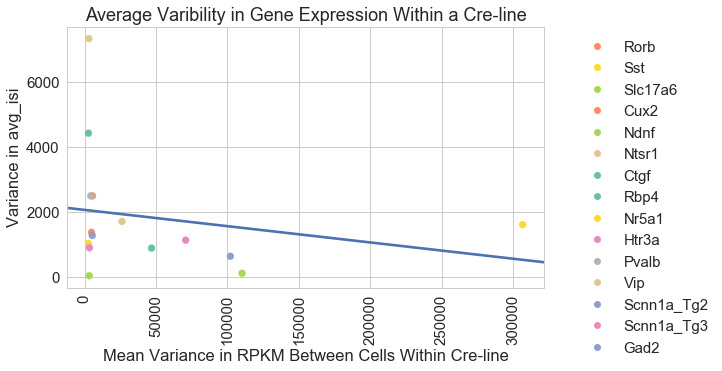

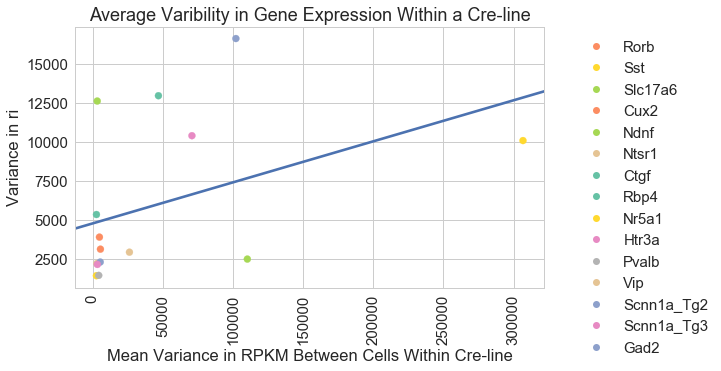

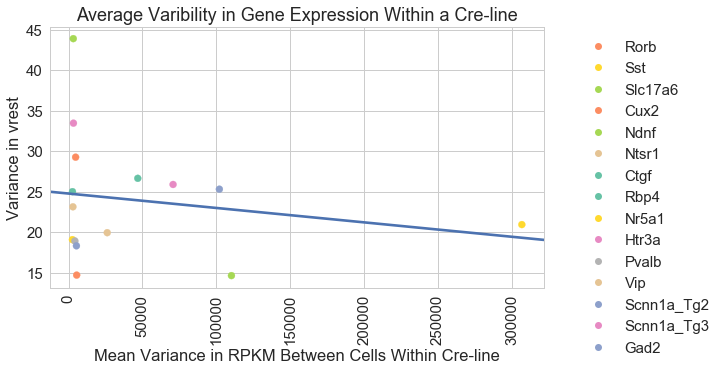

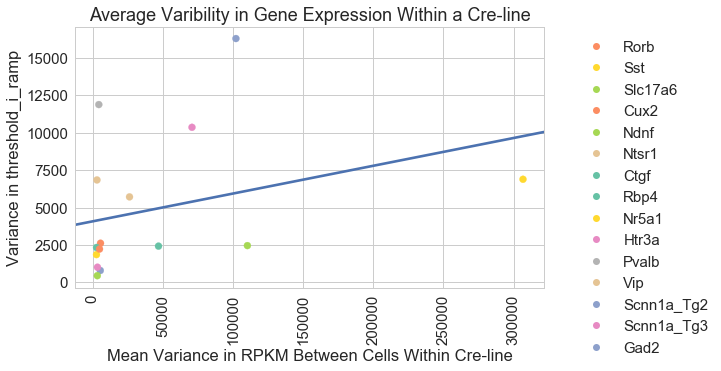

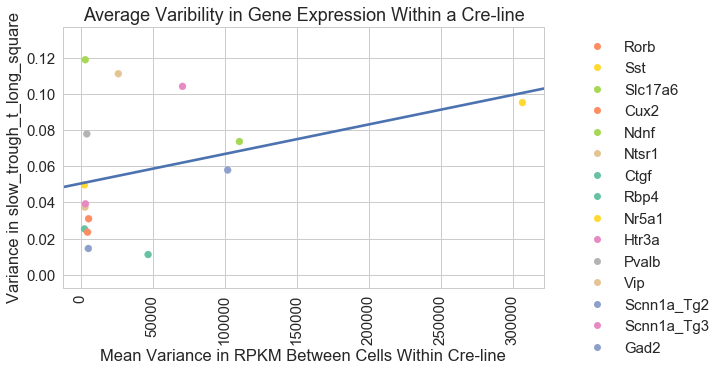

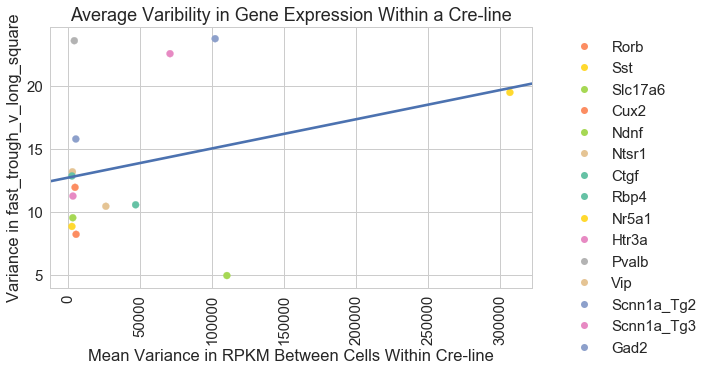

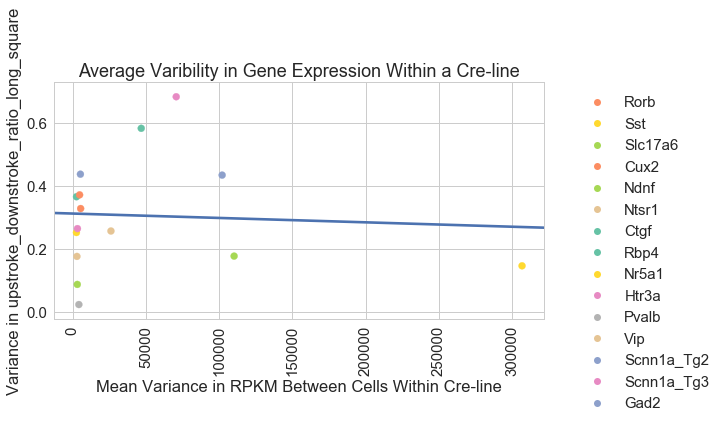

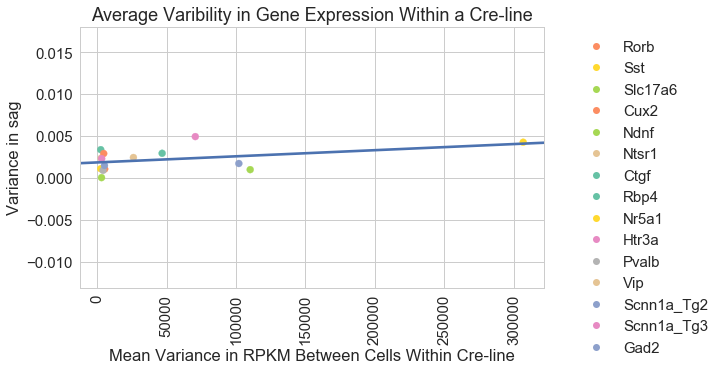

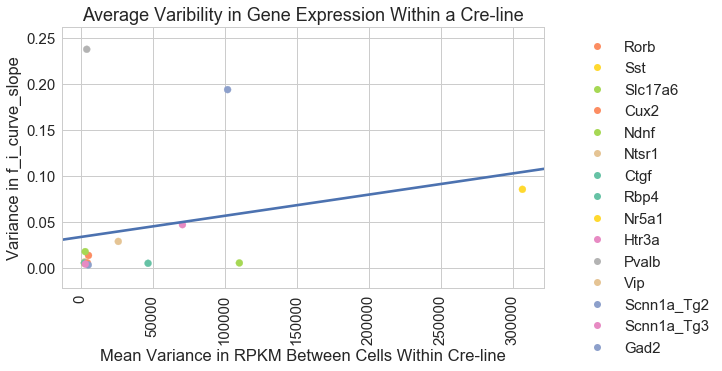

Got 4 genes


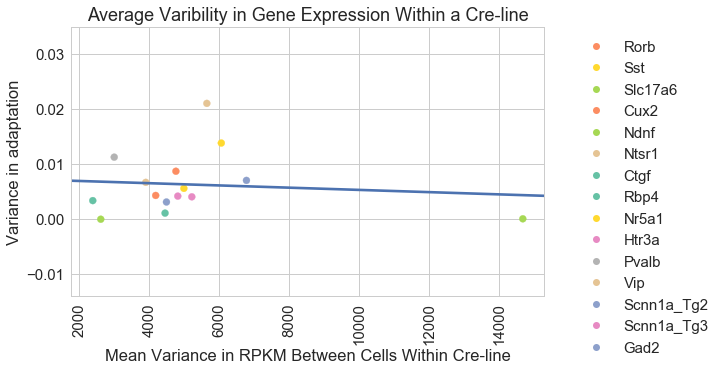

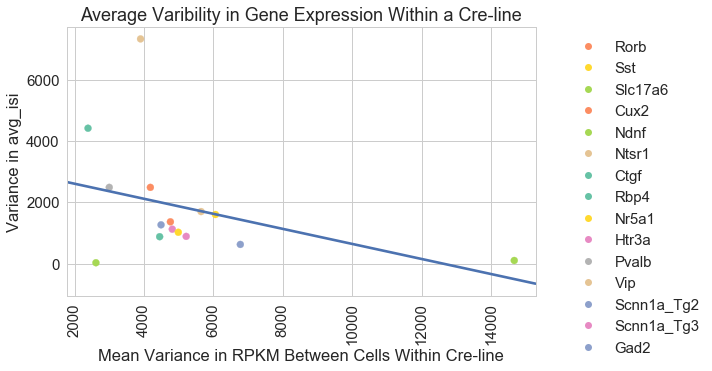

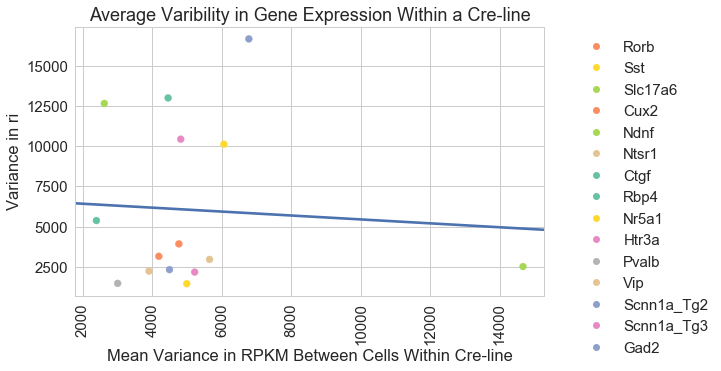

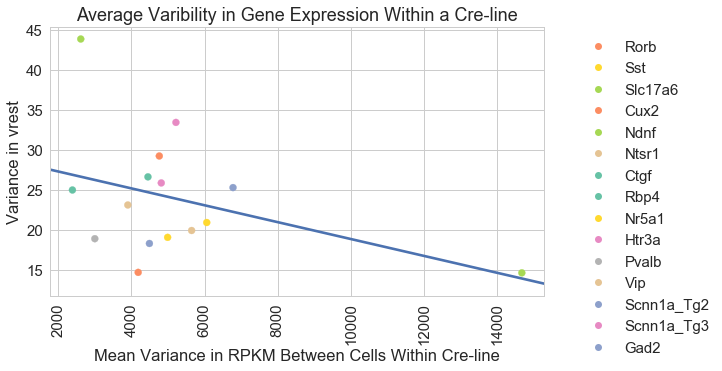

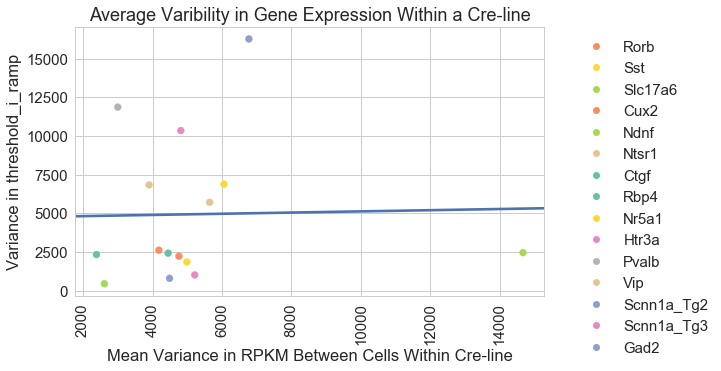

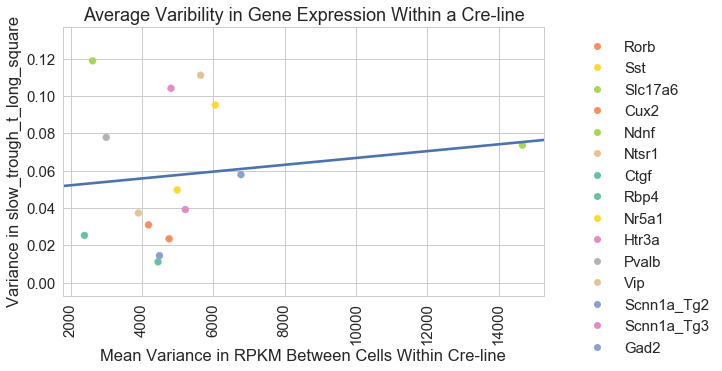

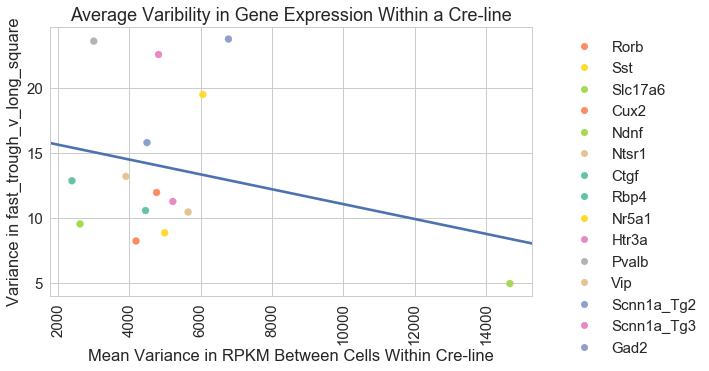

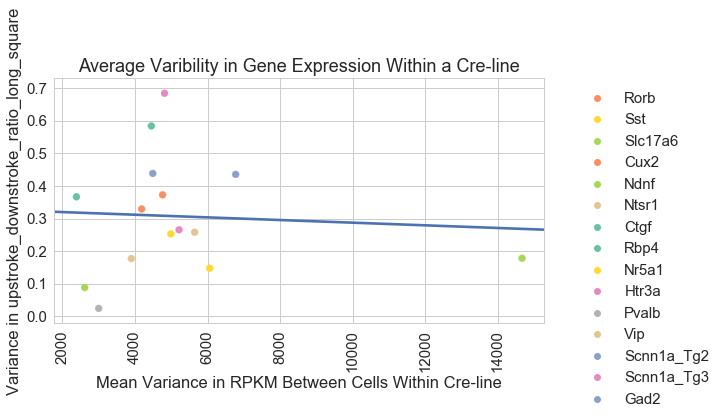

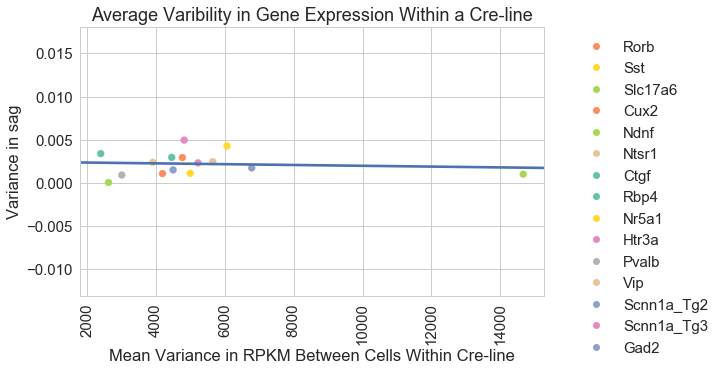

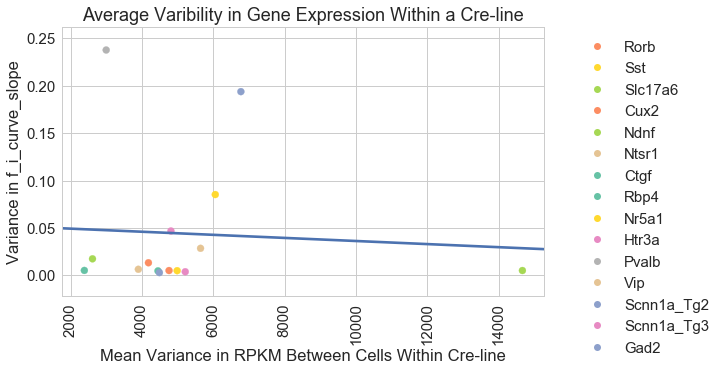

Got 8 genes


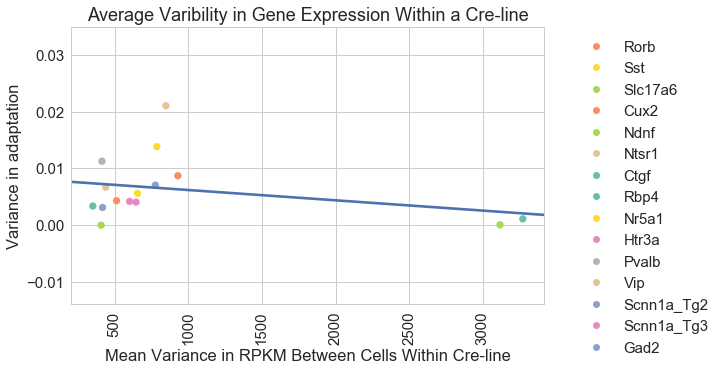

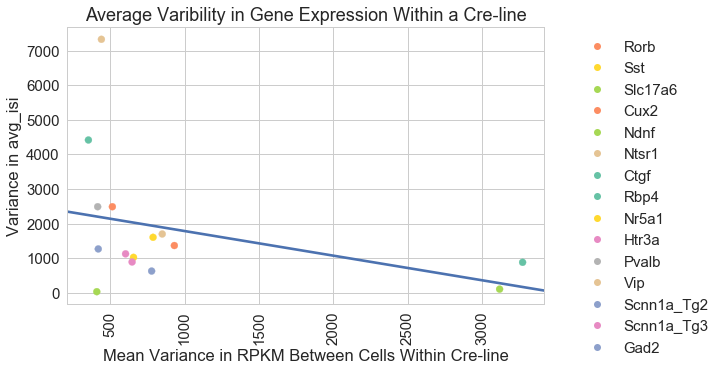

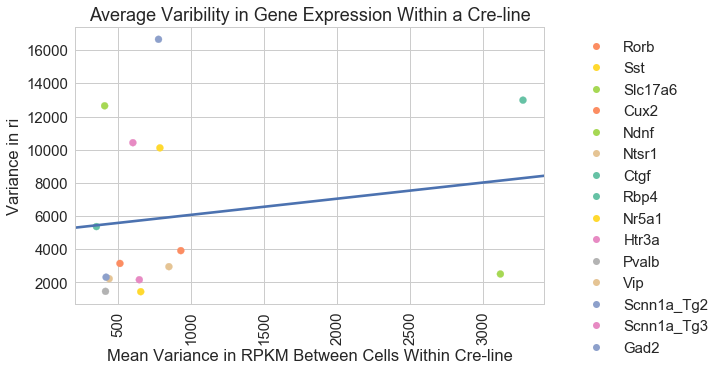

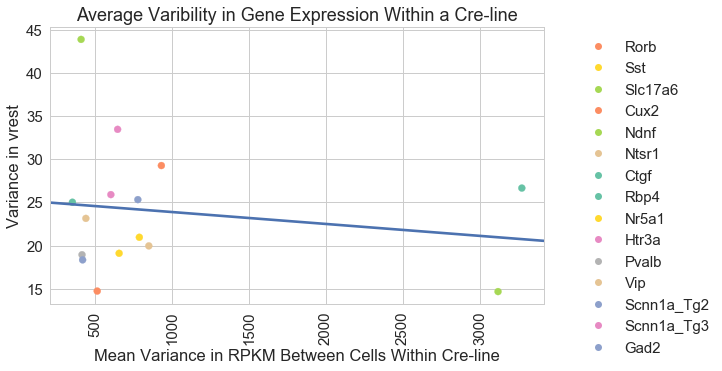

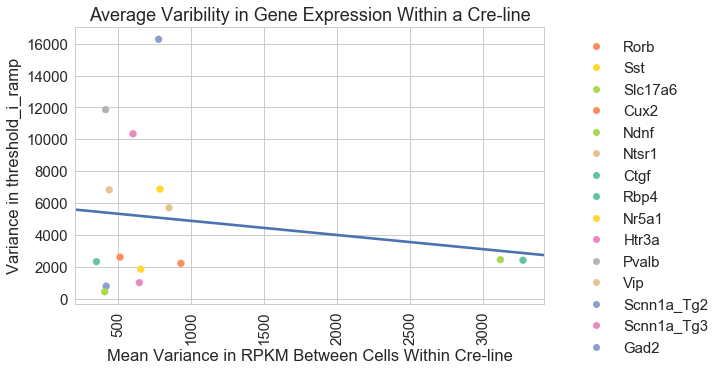

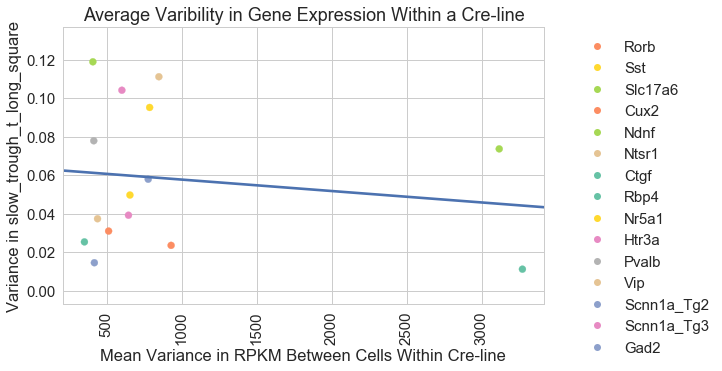

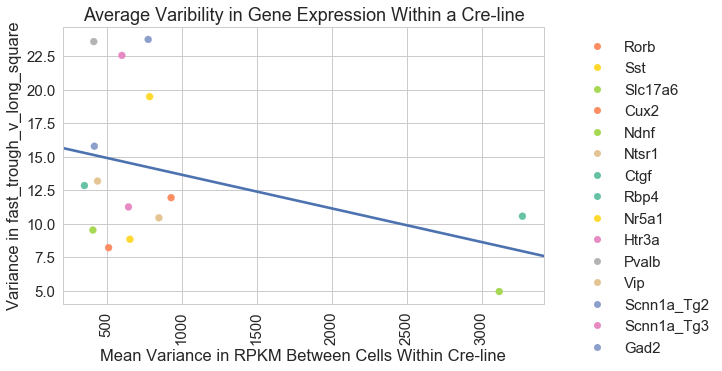

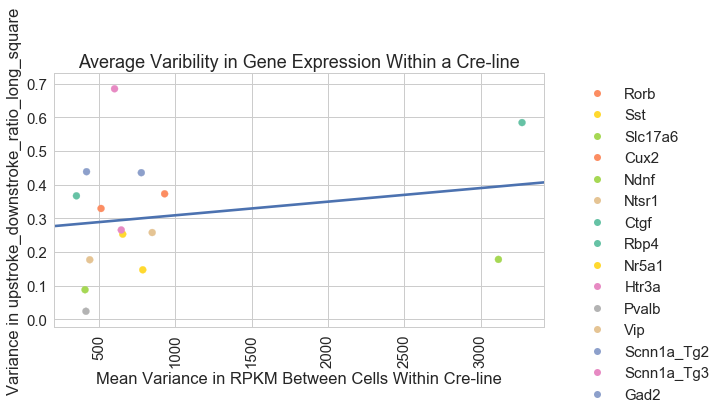

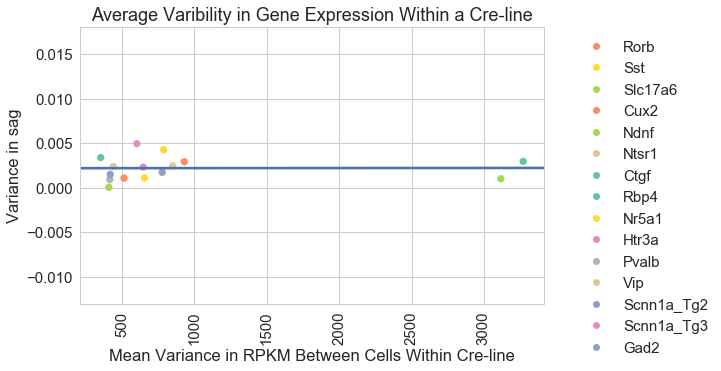

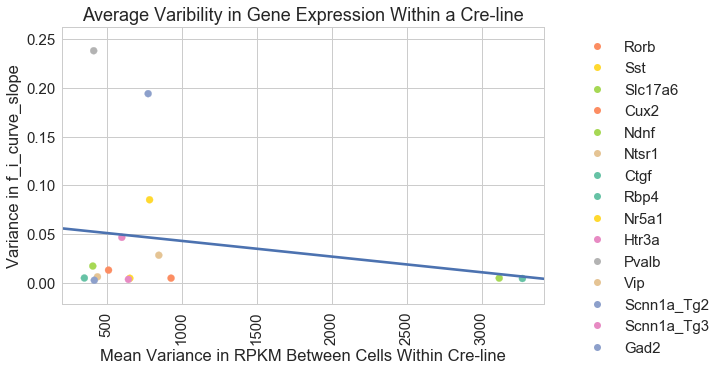

In [144]:
# 2017-09-1
# Scatterplot and r^2 for variance in ephys and varience in gene expression for all genes or
#selected GO terms analysis
#cell types split up by layer as well as cre line
#genes = list(data.index) #set default genes to all genes in the dataset
ephys_features = ['adaptation', 'avg_isi', 'ri', 'vrest', 'threshold_i_ramp', 'slow_trough_t_long_square',
                'fast_trough_v_long_square','upstroke_downstroke_ratio_long_square','sag',
                  'f_i_curve_slope']


output_path = '/Volumes/Brain2017/project/ouput_varplots_ephys/'
title = 'by_layer_'
drive_path = drive_path
new_type_colors = ['#78C850',  # Grass
                    '#F08030',  # Fire
                    '#6890F0',  # Water
                    #'#A8B820',  # Bug
                    '#A8A878',  # Normal
                    '#A040A0',  # Poison
                    '#F8D030',  # Electric
                    #'#E0C068',  # Ground
                    '#EE99AC',  # Fairy
                    '#C03028',  # Fighting
                    '#F85888',  # Psychic
                    '#B8A038',  # Rock
                    '#705898',  # Ghost
                    '#98D8D8',  # Ice
                    '#7038F8',  # Dragon
                   ]
#data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class = load_data(drive_path)

for GO_term in genes_dict.keys():
    #print('Analyzing genes associated with: ' + GO_term)
    genes = genes_dict[GO_term]
    print('Got ' + str(len(genes)) + ' genes')
    #genes = list(data.index) #set default genes to all genes in the dataset
    #get ephys variance for each cre:
    ephys_var = get_ephys_variance(drive_path_cells, ephys_features, group_by_layer = False)

    #get var in gene expression for all genes:
    data_var_mean,data_var, celltype_proportions_df, crelines_rnaseq = filter_rnaseq_data_variance(data, genes, name_to_dissection, name_to_class, group_by_layer = False)

    #combine variance for morphology and rnaseq into one datframe:
    data_var_mean = pd.DataFrame(data_var_mean)
    data_var_mean['tg_label_new'] = data_var_mean.index
    data_var_mean.rename(columns={0: 'mean_variance_RPKM'}, inplace=True)

    #ephys_var2 = pd.DataFrame(ephys_var).T
    #ephys_var2['tg_label_new'] = ephys_var2.index
    #ephys_var.tg_label_new
    ephys_var['tg_label_new'] = ephys_var.index
    df_var_exp = pd.merge(ephys_var,data_var_mean,left_on='tg_label_new',right_on='tg_label_new',how='left')

    #convert to df:
    df_varmorph_exp2 = pd.DataFrame.from_records(df_var_exp)

    sns.set(font_scale=1.5)
    sns.set_style("whitegrid")

    def r2(x, y):
        return stats.pearsonr(x, y)[0] ** 2
         
    
    for f in ephys_features:
        #calculate r^2
        line = r2(df_varmorph_exp2[f],df_varmorph_exp2['mean_variance_RPKM'])
        line2 = '{:f}'.format(line)
        text_add = str('r^2 = ') + str(line2)

        # Set figure size with matplotlib
        #fig, ax = plt.subplots(figsize=(20,20))
        #for x in range(len(features)-3): #-3 b/c three extra non-feature variables in list

        # Create plot
        # Unique category labels: 'D', 'F', 'G', ...
        color_labels = df_varmorph_exp2['tg_label_new'].unique()

        # List of RGB triplets
        rgb_values = sns.color_palette("Set2", len(color_labels))

        # Map label to RGB
        color_map = dict(zip(color_labels, rgb_values))
        color_map2 = [color for color in color_map.values()[:len(color_labels)]]

        # Finally use the mapped values

        g = plt.scatter(df_varmorph_exp2['mean_variance_RPKM'], df_varmorph_exp2[f], c=df_varmorph_exp2['tg_label_new'].map(color_map))


        #plt.legend(fontsize=8)

        #sns.lmplot(x=df_varmorph_exp2['mean_variance_RPKM'], y=df_varmorph_exp2[f], data=df_varmorph_exp2, fit_reg=False,hue='tg_label_new')
        sns.regplot(x=df_varmorph_exp2['mean_variance_RPKM'], y=df_varmorph_exp2[f], data=df_varmorph_exp2, scatter=False,ci=None)

        #ax=g.axes[0, 0]
       # plt.text(.2,.2, str(text_add),verticalalignment='left', 
        #         horizontalalignment='left',fontsize=12)

        plt.xticks(rotation=90)

        # Set title with matplotlib

        plt.title('Average Varibility in Gene Expression Within a Cre-line')
        plt.ylabel('Variance in ' + str(f))
        plt.xlabel('Mean Variance in RPKM Between Cells Within Cre-line')

        # The following two lines generate custom fake lines that will be used as legend entries:
        markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in color_map.values()]
        plt.legend(markers, color_map.keys(), numpoints=1, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.5)

        #legend_.remove()
        #legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        plt.tight_layout()
        #plt.subplots_adjust(bottom=0.10)
       # plt.subplots_adjust(right=0.10)
        #plt.subplots_adjust(left=0.0001)
       
        plt.savefig(output_path + str(GO_term) + str(f) + 'mean_variance_betweencellswithinCre.png',dpi=100,bbox_inches="tight")
        plt.show()


In [145]:
#get pearson correlations for ephys and gene expression:

ephys_features = ['adaptation', 'avg_isi', 'ri', 'vrest', 'threshold_i_ramp', 'slow_trough_t_long_square',
                'fast_trough_v_long_square','upstroke_downstroke_ratio_long_square','sag',
                  'f_i_curve_slope']


output_path = '/Volumes/Brain2017/project/ouput_varplots_ephys/'
title = 'by_layer_'
drive_path = drive_path


#data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class = load_data(drive_path)
master_dict_pearsonp = {}
master_dict_pearsonr2 = {}

for GO_term in genes_dict.keys():
    #print('Analyzing genes associated with: ' + GO_term)
    genes = genes_dict[GO_term]
    print('Got ' + str(len(genes)) + ' genes')
    #genes = list(data.index) #set default genes to all genes in the dataset
    #get ephys variance for each cre:
    ephys_var = get_ephys_variance(drive_path_cells, ephys_features, group_by_layer = False)

    #get var in gene expression for all genes:
    data_var_mean,data_var, celltype_proportions_df, crelines_rnaseq = filter_rnaseq_data_variance(data, genes, name_to_dissection, name_to_class, group_by_layer = False)

    #combine variance for morphology and rnaseq into one datframe:
    data_var_mean = pd.DataFrame(data_var_mean)
    data_var_mean['tg_label_new'] = data_var_mean.index
    data_var_mean.rename(columns={0: 'mean_variance_RPKM'}, inplace=True)

    #ephys_var2 = pd.DataFrame(ephys_var).T
    #ephys_var2['tg_label_new'] = ephys_var2.index
    #ephys_var.tg_label_new
    ephys_var['tg_label_new'] = ephys_var.index
    df_var_exp = pd.merge(ephys_var,data_var_mean,left_on='tg_label_new',right_on='tg_label_new',how='left')

    #convert to df:
    df_varmorph_exp2 = pd.DataFrame.from_records(df_var_exp)

    def r2(x, y):
        r2 = stats.pearsonr(x, y)[0] ** 2
        p = stats.pearsonr(x, y)[1]
        return r2,p
    
    corrl_dictr2 = {} 
    corrl_dictp = {}
    for f in ephys_features:
        #calculate r^2 and p value
        out = r2(df_varmorph_exp2[f],df_varmorph_exp2['mean_variance_RPKM'])

        corrl_dictr2[f]= out[0]
        corrl_dictp[f] = out[1]
        
    master_dict_pearsonp[GO_term] =  corrl_dictp
    master_dict_pearsonr2[GO_term] =  corrl_dictr2
    


Got 267 genes
Got 59 genes
Got 96 genes
Got 90 genes
Got 2 genes
Got 3 genes
Got 9 genes
Got 154 genes
Got 3 genes
Got 4 genes
Got 1786 genes
Got 4 genes
Got 8 genes


In [146]:
#correlations: r^2, p, q:
pearsonr2 = pd.DataFrame(master_dict_pearsonr2)
pearsonp = pd.DataFrame(master_dict_pearsonp)
p_arr = np.array(pearsonp)
p_list = np.reshape(p_arr, (-1))
_, q_list = fdrcorrection0(p_list, alpha = 0.05)
q_arr = np.reshape(q_list, p_arr.shape)
q_df = pd.DataFrame(q_arr, index = pearsonp.index, columns = pearsonp.columns)


pearsonp.to_excel('Variance_RPKM_Ephys_uncorrectedpvalues.xlsx')
pearsonr2.to_excel('Variance_RPKM_Ephys_r2.xlsx')
q_df.to_excel('Variance_RPKM_Ephys_BHFDRvalues.xlsx')

In [ ]:
#Mean FPKM for Top X Most Variably Expressed Genes by Cre Line and Layer
#takes FPKM averaged within a cre line/layer and calculates the variance
#sorts by variance and takes the top X genes specified by the user and outputs a csv and a heatmap

def Comparison_plots(data_means_rnaseq,output_path,X):
    #X is is the number of genes (ie. X=101)
    
    sns.set(font_scale=1.5)
    sns.set_style("whitegrid")
    #calculate variance across rows:
    data_means_rnaseq['gene_variance'] = data_means_rnaseq.var(axis=1)
    #sort by variance highest at top:
    data_means_rnaseq.sort_values(['gene_variance'], ascending=[False],inplace=True)
    #write to csv:
    #data_means_rnaseq.to_csv('MeanFPKM_byCreandlayer_AllGenes.csv')

    #filter for top N most variable genes
    data_cut = data_means_rnaseq.ix[:X,:]
    #save to csv
    data_cut.to_csv('MeanFPKM_byCreandlayer'+str(X)+'.csv')

    #remove gene variance column:
    data_cut.drop('gene_variance', inplace = True, axis= 1)

    sns.set(color_codes=True)

    map_plot = sns.clustermap(data_cut, z_score=0, col_cluster =True, row_cluster = True, figsize = (20,20)) #scales by row
                        # xticklabels = data_plot.columns.get_level_values(0))


    plt.setp(map_plot.ax_heatmap.yaxis.get_majorticklabels(), rotation=0, fontsize = 10)
    plt.setp(map_plot.ax_heatmap.xaxis.get_majorticklabels(), rotation=90, fontsize = 12)
    plt.title('Zscore (Mean FPKM)',fontsize = 12)

    sns.plt.suptitle('Mean FPKM for Top '+ str(X) + ' Most Variably Expressed Genes by Cre Line and Layer')
    plt.savefig(output_path + '/MeanFPKMTop' + str(X) + 'VariabliyExpressedGenes_heatmap.png')
    plt.show()
    return data_cut

Analyzing genes associated with: synapse organization
Got 267 genes


/Applications/anaconda/lib/python2.7/site-packages/scipy/stats/stats.py:3021: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


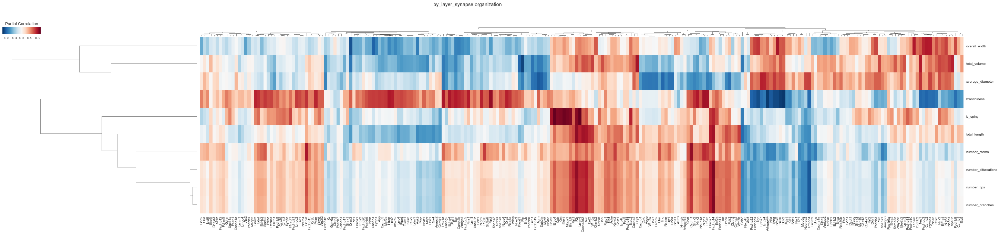

Plotted correlations for : by_layer_synapse organization
Analyzing genes associated with: dendritic spine morphogenesis
Got 59 genes


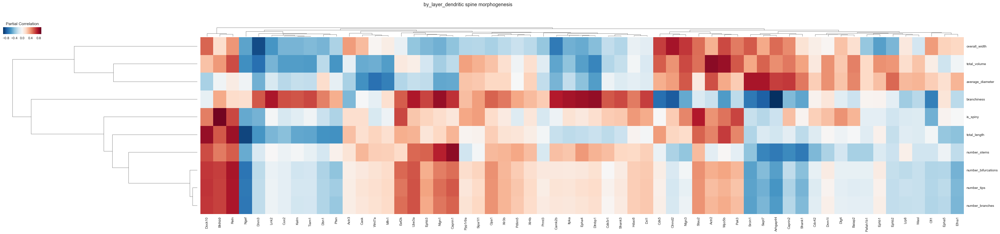

Plotted correlations for : by_layer_dendritic spine morphogenesis
Analyzing genes associated with: RNA polymerase II transcription cofactor activity
Got 96 genes


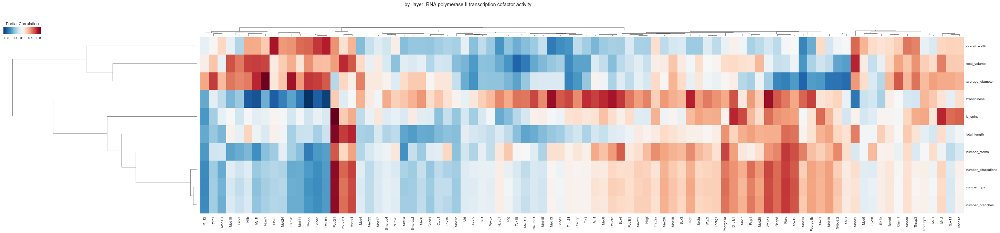

Plotted correlations for : by_layer_RNA polymerase II transcription cofactor activity
Analyzing genes associated with: establishment of cell polarity
Got 90 genes


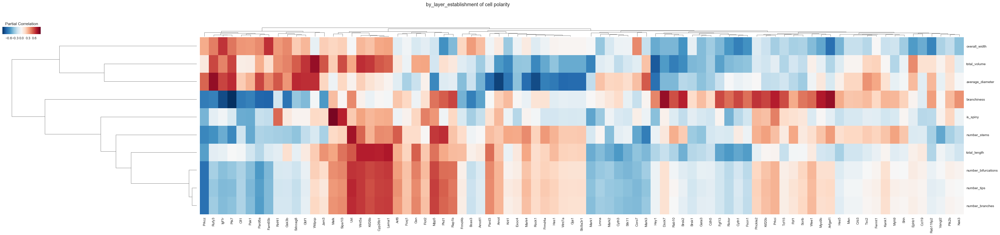

Plotted correlations for : by_layer_establishment of cell polarity
Analyzing genes associated with: inhibitory synapse assembly
Got 2 genes


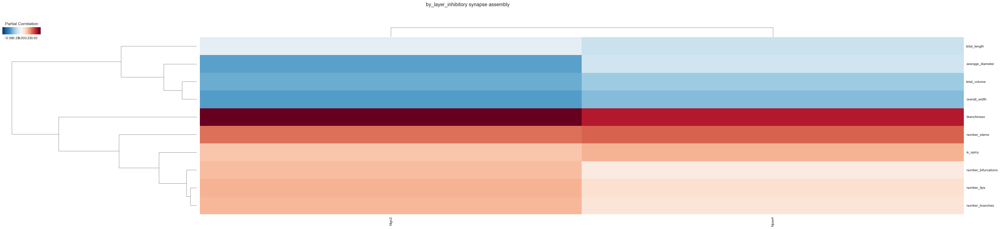

Plotted correlations for : by_layer_inhibitory synapse assembly
Analyzing genes associated with: maintenance of synapse structure
Got 3 genes
Could not make a clustermap for only one gene
Analyzing genes associated with: pyramidal neuron development
Got 9 genes


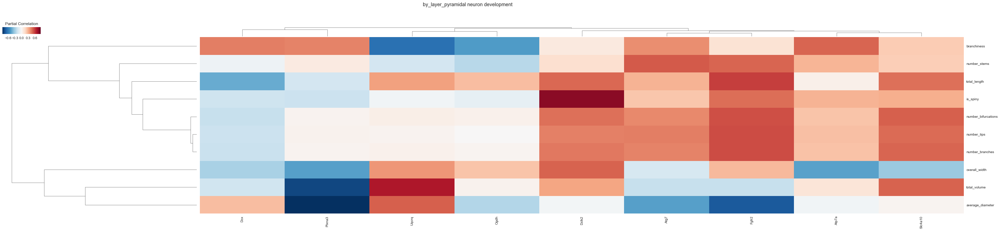

Plotted correlations for : by_layer_pyramidal neuron development
Analyzing genes associated with: transcription factor activity, RNA polymerase II transcription factor binding
Got 154 genes


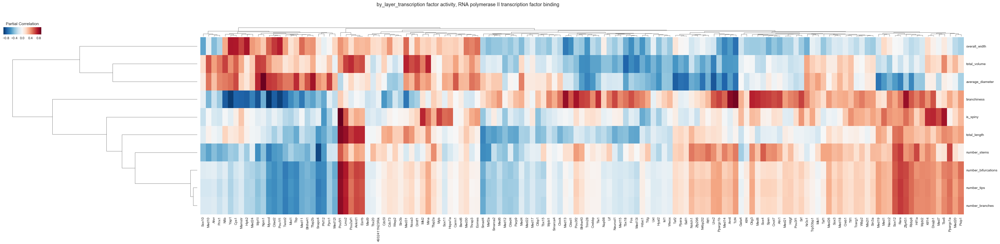

Plotted correlations for : by_layer_transcription factor activity, RNA polymerase II transcription factor binding
Analyzing genes associated with: morphogen activity
Got 3 genes


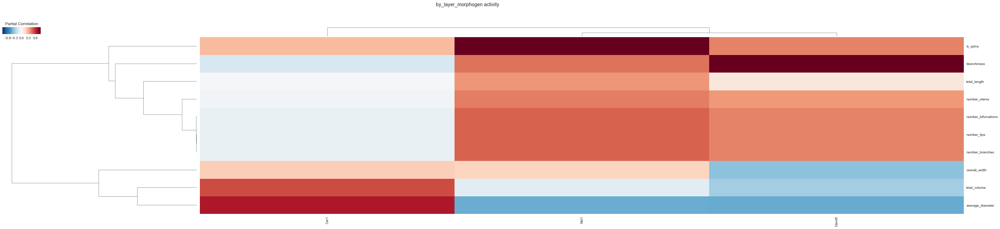

Plotted correlations for : by_layer_morphogen activity
Analyzing genes associated with: axon target recognition
Got 4 genes


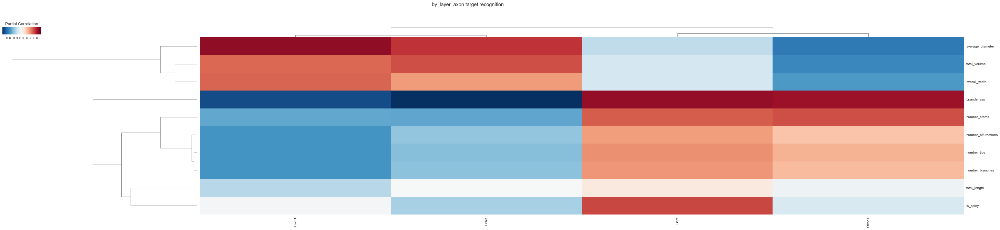

Plotted correlations for : by_layer_axon target recognition
Analyzing genes associated with: cell adhesion
Got 1786 genes


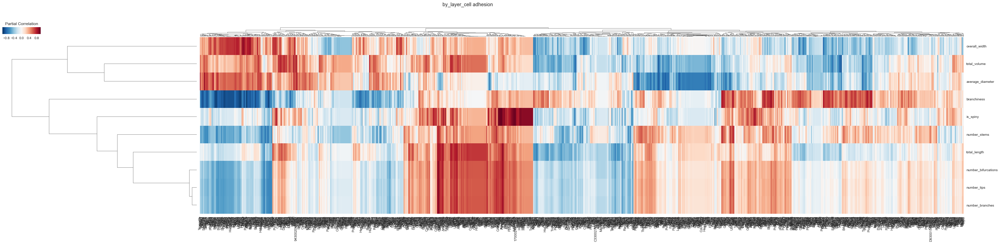

Plotted correlations for : by_layer_cell adhesion
Analyzing genes associated with: excitatory synapse assembly
Got 4 genes


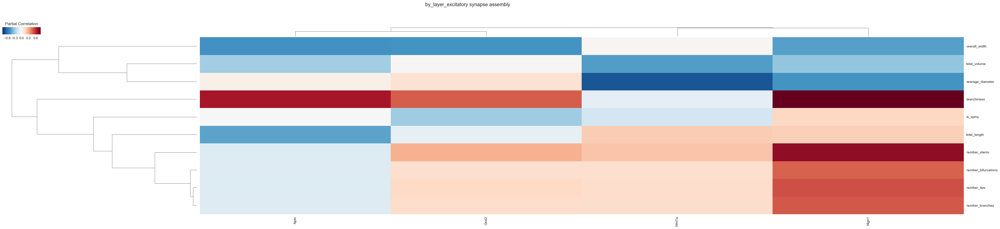

Plotted correlations for : by_layer_excitatory synapse assembly
Analyzing genes associated with: transcription factor activity, core RNA polymerase binding
Got 8 genes


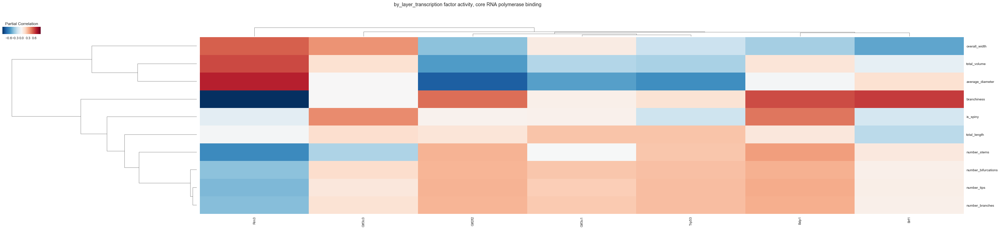

Plotted correlations for : by_layer_transcription factor activity, core RNA polymerase binding


In [23]:
#Swarmplot and boxplot for morphology features
by_layer = True
title = 'by_layer_'
drive_path = drive_path
#data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class = load_data(drive_path)
for GO_term in genes_dict.keys():
    print('Analyzing genes associated with: ' + GO_term)
    genes =  genes_dict[GO_term]
    print('Got ' + str(len(genes)) + ' genes')
    df_nice_mean, crelines_morph = get_morphology(drive_path, features, group_by_layer = by_layer)
    data_means, celltype_proportions_df, crelines_rnaseq = filter_data(data, genes, name_to_dissection, name_to_class, group_by_layer = by_layer)
    data_means_rnaseq, df_morph, line_labels = match_datasets(data_means, df_nice_mean, crelines_morph, crelines_rnaseq, celltype_proportions_df, group_by_layer = by_layer)
    r_df = get_correlations(data_means_rnaseq, df_morph, line_labels)
    if r_df.shape[1] >1:
        plot_heatmap(r_df, title + GO_term)
        print('Plotted correlations for : ' + title + GO_term)
    else:
        print('Could not make a clustermap for only one gene')

Analyzing genes associated with: synapse organization
Got 267 genes


/Applications/anaconda/lib/python2.7/site-packages/scipy/stats/stats.py:3021: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
/Applications/anaconda/lib/python2.7/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


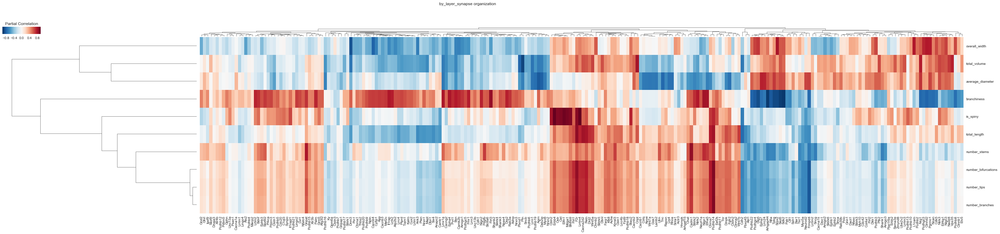

Plotted correlations for : by_layer_synapse organization
Analyzing genes associated with: dendritic spine morphogenesis
Got 59 genes


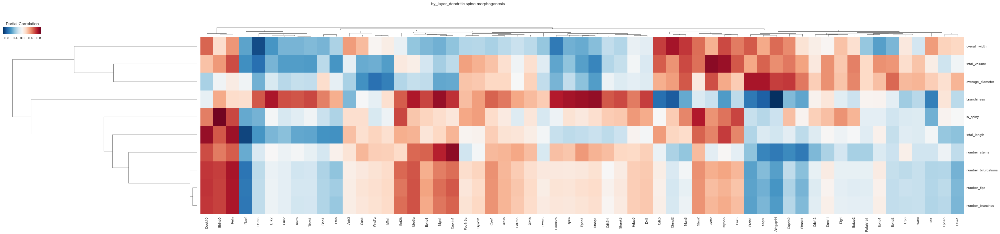

Plotted correlations for : by_layer_dendritic spine morphogenesis
Analyzing genes associated with: RNA polymerase II transcription cofactor activity
Got 96 genes


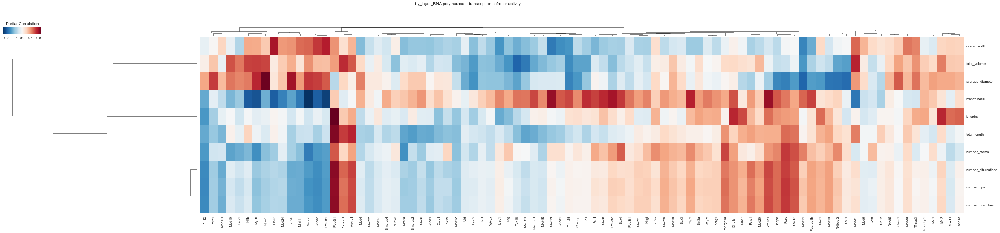

Plotted correlations for : by_layer_RNA polymerase II transcription cofactor activity
Analyzing genes associated with: establishment of cell polarity
Got 90 genes


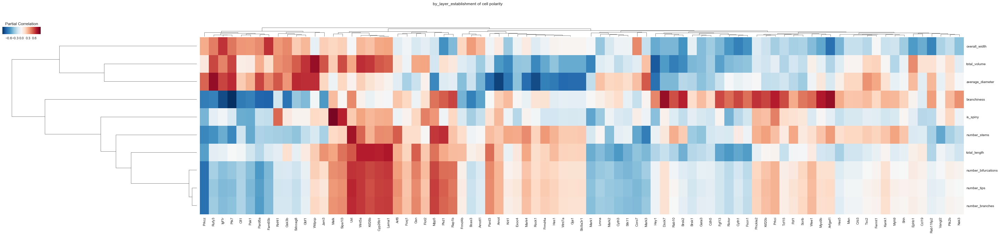

Plotted correlations for : by_layer_establishment of cell polarity
Analyzing genes associated with: inhibitory synapse assembly
Got 2 genes


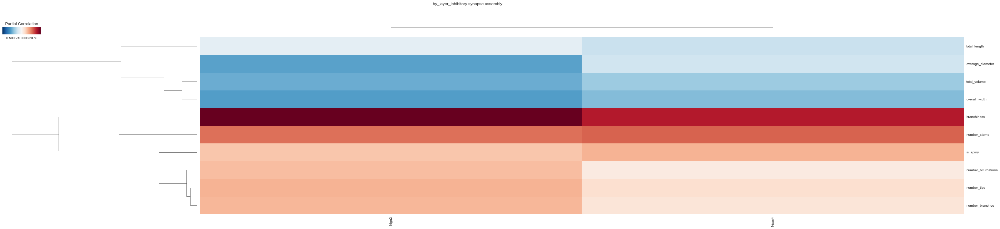

Plotted correlations for : by_layer_inhibitory synapse assembly
Analyzing genes associated with: maintenance of synapse structure
Got 3 genes
Could not make a clustermap for only one gene
Analyzing genes associated with: pyramidal neuron development
Got 9 genes


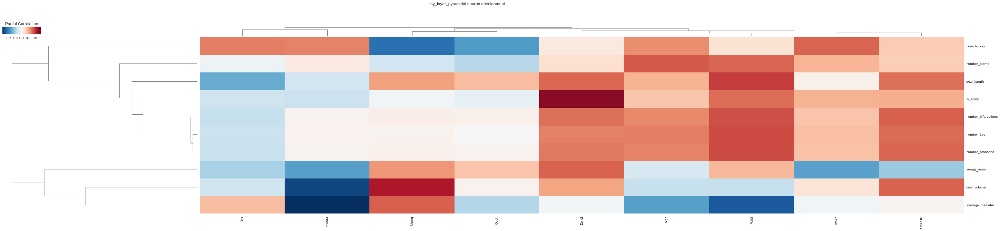

Plotted correlations for : by_layer_pyramidal neuron development
Analyzing genes associated with: transcription factor activity, RNA polymerase II transcription factor binding
Got 154 genes


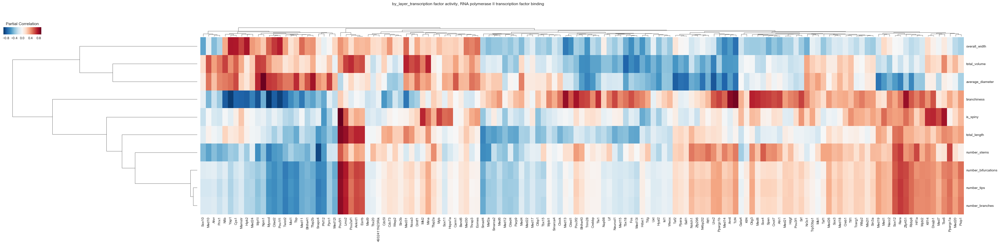

Plotted correlations for : by_layer_transcription factor activity, RNA polymerase II transcription factor binding
Analyzing genes associated with: morphogen activity
Got 3 genes


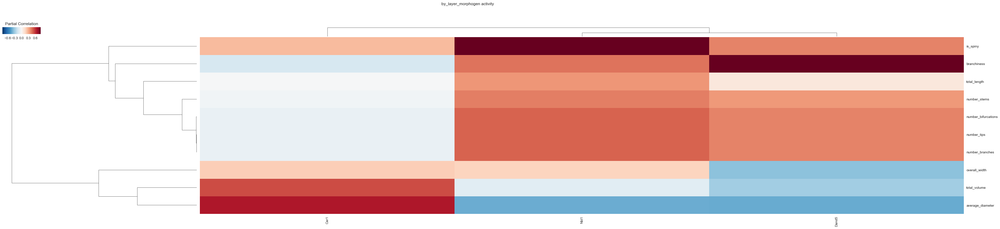

Plotted correlations for : by_layer_morphogen activity
Analyzing genes associated with: axon target recognition
Got 4 genes


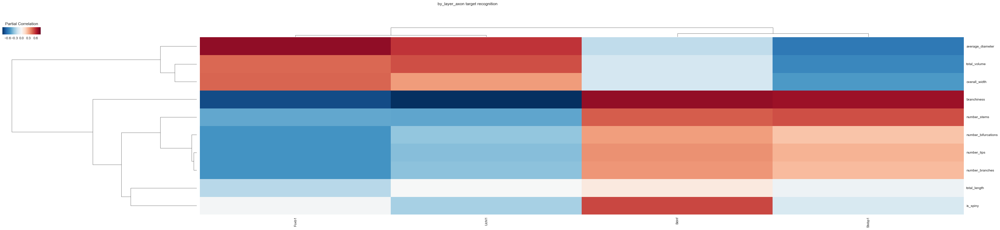

Plotted correlations for : by_layer_axon target recognition
Analyzing genes associated with: cell adhesion
Got 1786 genes


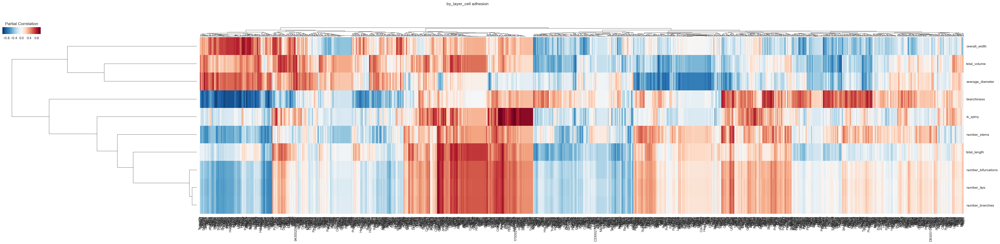

Plotted correlations for : by_layer_cell adhesion
Analyzing genes associated with: excitatory synapse assembly
Got 4 genes


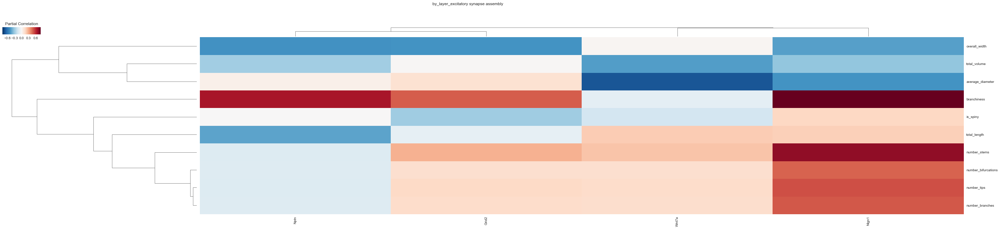

Plotted correlations for : by_layer_excitatory synapse assembly
Analyzing genes associated with: transcription factor activity, core RNA polymerase binding
Got 8 genes


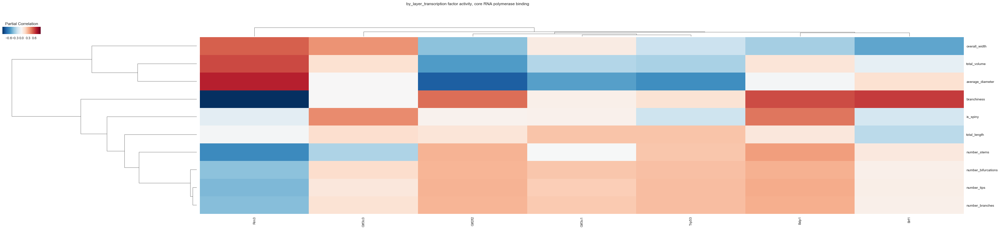

Plotted correlations for : by_layer_transcription factor activity, core RNA polymerase binding


In [105]:
# 2017-08-30
# Repeat GO term analysis with cell types split up by layer as well as cre line
features = ['number_bifurcations', 'total_volume', 'average_diameter', 'number_tips', 'total_length',
            'overall_width', 'number_stems', 'number_branches', 'branchiness', 'is_spiny', 'area', 'transgenic_line']
by_layer = True
title = 'by_layer_'
drive_path = drive_path
data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class = load_data(drive_path)
for GO_term in genes_dict.keys():
    print('Analyzing genes associated with: ' + GO_term)
    genes = genes_dict[GO_term]
    print('Got ' + str(len(genes)) + ' genes')
    df_nice_mean, crelines_morph = get_morphology(drive_path, features, group_by_layer = by_layer)
    data_means, celltype_proportions_df, crelines_rnaseq = filter_data(data, genes, name_to_dissection, name_to_class, group_by_layer = by_layer)
    print data_means.head()
    data_means_rnaseq, df_morph, line_labels = match_datasets(data_means, df_nice_mean, crelines_morph, crelines_rnaseq, celltype_proportions_df, group_by_layer = by_layer)
    r_df = get_correlations(data_means_rnaseq, df_morph, line_labels)
    if r_df.shape[1] >1:
        plot_heatmap(r_df, title + GO_term)
        print('Plotted correlations for : ' + title + GO_term)
    else:
        print('Could not make a clustermap for only one gene')

In [ ]:
# 2017-08-30
# Make heatmap for top 100 variably expressed genes, taking into account layer identity

title = 'by_layer_Top100_variable_V1'

genes_df = pd.read_csv(drive_path + '/MeanFPKM_byCreandlayer_AllGenes.csv')[['gene_symbol', 'gene_variance']]
genes_df.sort_values(by = 'gene_variance', inplace = True, ascending = False)
genes = list(genes_df.iloc[:100, :]['gene_symbol'])
print('Got ' + str(len(genes)) + ' genes')
data, cell_meta, cell_info, name_to_cre, name_to_dissection, name_to_class = load_data(drive_path)
data_means, celltype_proportions_df = filter_data(data, genes, name_to_dissection, name_to_class)
df_nice_mean, crelines_morph = get_morphology(drive_path, features, group_by_layer = by_layer)
data_means, celltype_proportions_df, crelines_rnaseq = filter_data(data, genes, name_to_dissection, name_to_class, group_by_layer = by_layer)
data_means_rnaseq, df_morph, line_labels = match_datasets(data_means, df_nice_mean, crelines_morph, crelines_rnaseq, celltype_proportions_df, group_by_layer = by_layer)
r_df = get_correlations(data_means_rnaseq, df_morph, line_labels)
if r_df.shape[1] >1:
    plot_heatmap(r_df, title + GO_term)
    print('Plotted correlations for : ' + title + GO_term)
else:
    print('Could not make a clustermap for only one gene')

Analyzing genes associated with: transcription factor activity, RNA polymerase II transcription factor binding
Got 154 genes
Filtered RNA seq data
Matched datasets
Got correlations


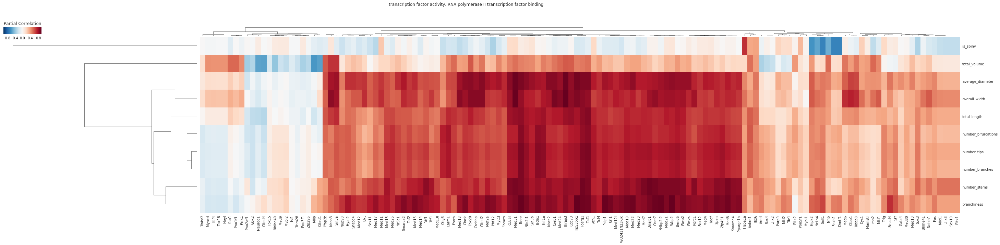

Plotted correlations for GO term: transcription factor activity, RNA polymerase II transcription factor binding
Analyzing genes associated with: transcription factor activity, core RNA polymerase binding
Got 8 genes
Filtered RNA seq data
Matched datasets
Got correlations


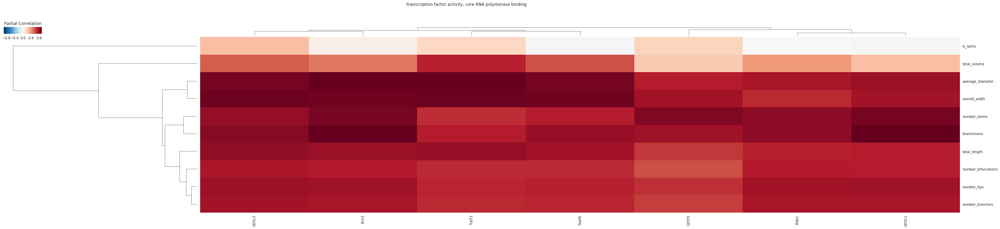

Plotted correlations for GO term: transcription factor activity, core RNA polymerase binding
Analyzing genes associated with: RNA polymerase II transcription cofactor activity
Got 96 genes
Filtered RNA seq data
Matched datasets
Got correlations


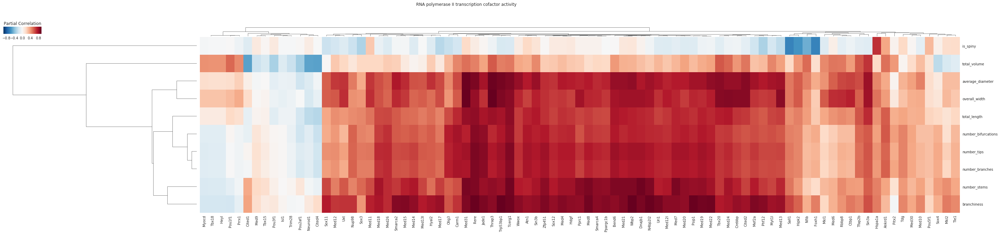

Plotted correlations for GO term: RNA polymerase II transcription cofactor activity


In [47]:
# 2017-08-29
# Make heatmaps based on GO term-associated gene lists

for GO_term in genes_dict.keys():
    print('Analyzing genes associated with: ' + GO_term)
    genes = genes_dict[GO_term]
    print('Got ' + str(len(genes)) + ' genes')
    data_means, celltype_proportions_df = filter_data(data, genes, name_to_dissection, name_to_class)
    print('Filtered RNA seq data')
    data_means_rnaseq, df_morph, line_labels = match_datasets(data_means, df_nice_mean)
    print('Matched datasets')
    r_df = get_correlations(data_means_rnaseq, df_morph, line_labels)
    print('Got correlations')
    if r_df.shape[1] >1:
        plot_heatmap(r_df, GO_term)
        print('Plotted correlations for GO term: ' + GO_term)
    else:
        print('Could not make a clustermap for only one gene')

Analyzing genes
Got 100 genes
Filtered RNA seq data
Matched datasets
Got correlations


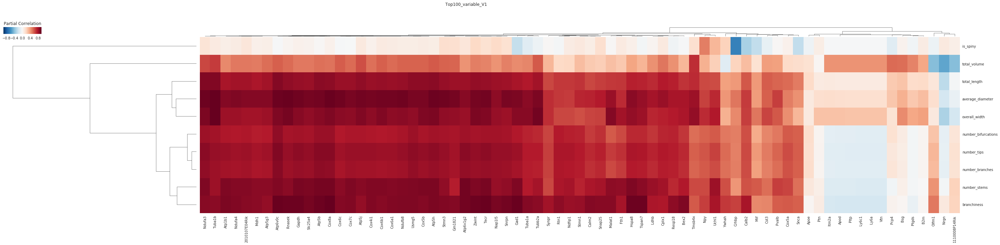

Plotted correlations for : Top100_variable_V1


In [63]:
# 2017-08-29
# Make heatmap for top 100 variably expressed genes

title = 'Top100_variable_V1'

print('Analyzing genes')
genes_df = pd.read_csv(drive_path + '/MeanFPKM_byCreandlayer_AllGenes.csv')[['gene_symbol', 'gene_variance']]
genes_df.sort_values(by = 'gene_variance', inplace = True, ascending = False)
genes = list(genes_df.iloc[:100, :]['gene_symbol'])
print('Got ' + str(len(genes)) + ' genes')
data_means, celltype_proportions_df = filter_data(data, genes, name_to_dissection, name_to_class)
print('Filtered RNA seq data')
data_means_rnaseq, df_morph, line_labels = match_datasets(data_means, df_nice_mean)
print('Matched datasets')
r_df = get_correlations(data_means_rnaseq, df_morph, line_labels)
print('Got correlations')
if r_df.shape[1] >1:
    plot_heatmap(r_df, title)
    print('Plotted correlations for : ' + title)
else:
    print('Could not make a clustermap for only one gene')

<h3>Everything below this point is currently a mess</h3>

In [26]:
structures = sorted(list(df_nice['area'].unique()))
lines = sorted(list(df_nice['transgenic_line'].unique()))

print(structures)
print(lines)

[u'VISp1', u'VISp2/3', u'VISp4', u'VISp5', u'VISp6a', u'VISp6b']
[u'Ctgf-T2A-dgCre', u'Cux2-CreERT2', u'Gad2-IRES-Cre', u'Htr3a-Cre_NO152', u'Nr5a1-Cre', u'Ntsr1-Cre_GN220', u'Pvalb-IRES-Cre', u'Rbp4-Cre_KL100', u'Rorb-IRES2-Cre', u'Scnn1a-Tg2-Cre', u'Scnn1a-Tg3-Cre', u'Slc17a6-IRES-Cre', u'Sst-IRES-Cre']


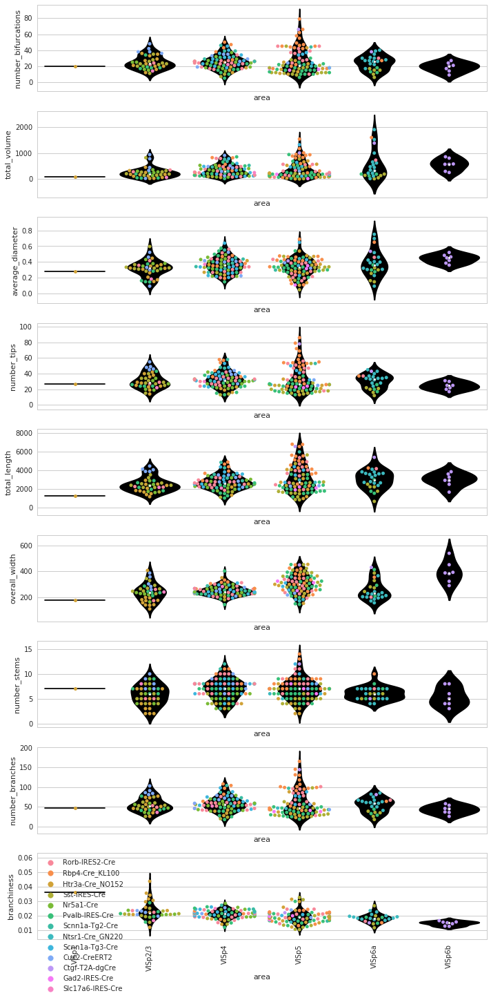

In [27]:
sns.set_style("whitegrid")
fig, ax = plt.subplots(9,1, sharex=True,figsize=(10,20), )
for x in range(len(features)-3):
    sns.swarmplot(ax= ax[x],x= df_nice.area,y=df_nice.columns[x], hue = 'transgenic_line', data=df_nice, order = structures)
    sns.violinplot(ax= ax[x],x=df_nice.area, y=df_nice.columns[x], data=df_nice,
        order = structures, color = 'black')
    ax[x].legend_.remove()
plt.xticks(rotation = 'vertical')
plt.legend()
fig.tight_layout()

In [28]:
data_dict = {}
for area in structures:
    area_dict = {}
    for line in lines:
        df_subset = df_nice[(df_nice.area == area) & (df_nice.transgenic_line == line)]
        area_dict[line] = df_subset
    data_dict[area] = area_dict

In [32]:
feature_dict = {}
feature_dict_count = {}
feature_dict_sem = {}
for feature in features[:10]:
    df_mean = df_nice.groupby(['area', 'transgenic_line']).mean()[feature].unstack()
    df_count = df_nice.groupby(['area', 'transgenic_line']).count()[feature].unstack()
    df_sem = df_nice.groupby(['area', 'transgenic_line']).sem()[feature].unstack()
    transgenic_line_abr = [l.split('-')[0] for l in df_mean.columns]
    for df_ind in [df_mean, df_count, df_sem]:
        df_ind.columns = transgenic_line_abr
    feature_dict[feature] = df_mean
    feature_dict_count[feature] = df_count
    feature_dict_sem[feature] = df_sem
nan_df = df_count.isnull()
# df_mean_small = df_mean.loc[df_mean.index[1:4]]
# df_mean_small.dropna(axis = 1, inplace = True)
# df_mean_small

# df_mean_small = pd.DataFrame(df_mean_small.stack()).reset_index()
# df_mean_small.columns = ['area', 'transgenic_line', 'value']


# print(df_mean_small)

nan_df

,Ctgf,Cux2,Gad2,Htr3a,Nr5a1,Ntsr1,Pvalb,Rbp4,Rorb,Scnn1a,Scnn1a,Slc17a6,Sst
area,,,,,,,,,,,,,
VISp1,True,True,True,False,True,True,True,True,True,True,True,True,True
VISp2/3,True,False,True,False,False,True,False,True,False,True,True,False,False
VISp4,True,False,True,False,False,True,False,False,False,False,False,False,False
VISp5,False,False,False,False,True,False,False,False,False,False,False,True,False
VISp6a,False,True,True,True,True,False,False,False,False,True,True,True,False
VISp6b,False,True,True,True,True,True,True,True,True,True,True,True,True


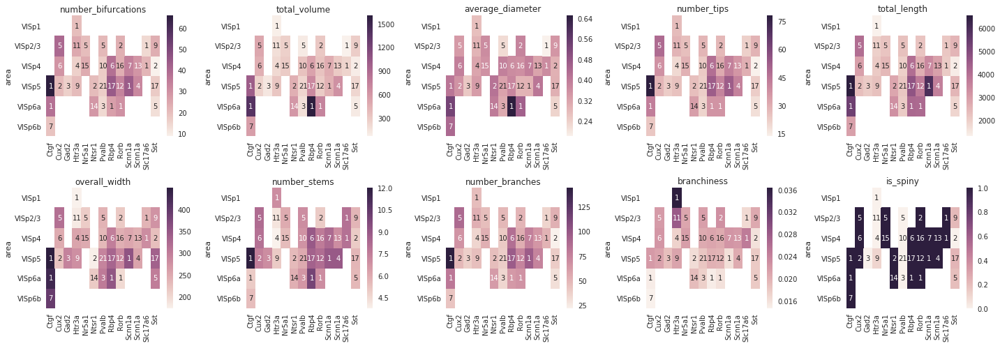

In [30]:
fig, ax = plt.subplots(nrows = 2, ncols = 5, figsize = (20, 7), sharex = False, sharey = False, )

for i, feature in enumerate(features[:10]):
    hmap = sns.heatmap(feature_dict[feature], ax = ax.flatten()[i], annot = feature_dict_count[feature])
    ax.flatten()[i].set_title(feature)
    fig.tight_layout()

In [31]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource, LinearColorMapper
from bokeh.layouts import gridplot
from bokeh.resources import CDN
from bokeh.embed import file_html

source = ColumnDataSource(df_mean_small)
print(source)

output_notebook()
tools = "hover,save,pan,box_zoom,reset,wheel_zoom"
plots = []
colors = ["#75968f", "#a5bab7", "#c9d9d3", "#e2e2e2", "#dfccce", "#ddb7b1", "#cc7878", "#933b41", "#550b1d"]
mapper = LinearColorMapper(palette=colors, low=df_mean_small['value'].min(), high=df_mean_small['value'].max())

p = figure()
p.rect(x = df_mean_small.columns, y = df_mean_small.index, width = 200, height = 200, source = source, 
       fill_color={'transform': mapper})
show(p)

NameError: name 'df_mean_small' is not defined